<h1 align="center">Visual Behavior Neuropixels SWDB 2022 </h1>
<h2 align="center">Session Analysis for Representational Drift</h2>
<h3 align="center">Entrypoint</h3>

# 0. SET UP - Pick Session
set up the cache, define a session, view metadata and set up respective tables

### 0.1 imports

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec #Useful tool to arrange multiple plots in one figure (https://matplotlib.org/stable/api/_as_gen/matplotlib.gridspec.GridSpec.html)
from matplotlib.patches import Patch
from matplotlib.patches import Rectangle

from util import set_up_cache, get_session, plot_unit_spikes, plot_one_trial, plot_trials, plot_trials_chron, plot_trials_timeline, horizontal_bar_plot_trials, trials_data_description
from util_eda import get_missing_durations, create_unit_activity_vectors, plot_stimulus_presentations_with_activities, get_unit_activity_vectors_for_image, average_population_response_over_same_stimulus_presentations, count_same_image_appearences, extract_speed_and_pupil_data, plot_active_vs_passive_RS_running_speed_and_pupil_area_over_time, running_speeds_and_pupil_areas, count_all_same_image_appearences, construct_unit_activity_population_response_matrix
from util_RS_plots import specific_image, plot_layered_RS_running_speed_and_pupil_area_all_images, RS_behaviour_active_passive, RS_vs_time_avg_active_passive, correlation_between_picture_pair, RS_behaviour_avg, RS_vs_time_active_passive_within_blocks, tuning_curves_time_dependent, specific_image_z_scored_behaviour, plot_tuning_curves_time_dependent, get_all_tunings, show_tunings_norm_each_unit, show_tunings_norm_each_bin, plot_tuning_curves_time_dependent_all_images_layered
from optotagging import get_cre_pos_unit_ids_from_optotagging

%matplotlib inline

%load_ext autoreload
%autoreload 2
%aimport util

import util

### 0.2 set up cache

In [2]:
cache = set_up_cache()

In [3]:
ecephys_sessions_table = cache.get_ecephys_session_table()
ecephys_sessions_table.head()

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044385384,1044408432,2020-08-19 14:47:08.574000+00:00,NP.1,EPHYS_1_images_G_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,151,2179.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'LGv...",G,30.0,1,Familiar,0,870,NaN,NaN
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1047969464,1048005547,2020-09-02 14:53:14.347000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,263,2438.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,62.0,1,Familiar,0,877,NaN,NaN
1047977240,1048009327,2020-09-02 15:15:03.733000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,165,1856.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,51.0,1,Familiar,0,878,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN


### 0.3 pick mouse and session

In [4]:
ecephys_sessions_table[ecephys_sessions_table['experience_level']=='Novel'].head(3)

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN
1048196054,1048222325,2020-09-03 14:25:07.290000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,166,2288.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,880,NaN,NaN


In [47]:
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==527749] # originial mouse
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==524761] # different mouse 1
ecephys_sessions_table[ecephys_sessions_table['mouse_id']==577287] # different mouse 2
#ecephys_sessions_table[ecephys_sessions_table['mouse_id']==568963] # different mouse 3 Vip

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1124285719,1124315985,2021-08-25 13:55:58.475000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,577287,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,158,1801.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,1,Novel,0,1010,NaN,NaN
1124507277,1124536942,2021-08-26 14:32:42.128000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,577287,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,159,2010.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,42.0,2,Familiar,1,1011,NaN,NaN


In [48]:
# sessionID = 1053941483  # 1 # Novel Session of Mouse with ID: 527749 sst (DAY 2, Novel, H)  (original)
# sessionID = 1053718935  # 2 # Familiar Session of (same) Mouse with ID: 527749 sst (DAY 1, Familiar, G)
# sessionID = 1044385384  # 3 # Familiar Session of Mouse with ID: 524761 (different mouse, wt, f, DAY 1, G) 
sessionID = 1124285719  # 4 # Novel Session of Mouse with ID: 577287 (H, DAY 1, f, sst)  (different)
# sessionID = 1111013640 # 5 # Familiar Session of Mouse with ID: 568963 (G, DAY 1, m, vip)

In [49]:
session = get_session(session_id=sessionID)

In [50]:
session.metadata

{'equipment_name': 'NP.0',
 'sex': 'F',
 'age_in_days': 158,
 'stimulus_frame_rate': 60.0,
 'session_type': 'EPHYS_1_images_H_3uL_reward',
 'date_of_acquisition': datetime.datetime(2021, 8, 25, 20, 55, 58, tzinfo=tzutc()),
 'reporter_line': 'Ai32(RCL-ChR2(H134R)_EYFP)',
 'cre_line': 'Sst-IRES-Cre',
 'behavior_session_uuid': None,
 'driver_line': ['Sst-IRES-Cre'],
 'mouse_id': 577287,
 'full_genotype': 'Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt',
 'behavior_session_id': 1124315985,
 'ecephys_session_id': 1124285719}

### 0.4 set up tables

In [51]:
stimulus_presentations = session.stimulus_presentations
# This table is a record of every stimulus we presented to the mouse over the course of this experiment
print(len(stimulus_presentations))
# stimulus_presentations.tail()
# stimulus_presentations.head()

13403


In [52]:
units = session.get_units()
# This table contains quality metrics and waveform metrics for every unit recorded during this session
units.head()

channels = session.get_channels()
# This table contains info about where each channel was in the brain as well as it's relative position along the probe.
channels.head(3)

# merge
units = units.merge(channels, left_on='peak_channel_id', right_index=True)
#units.head()

# how many units were recorded in each brain area for this session?
# units.value_counts('structure_acronym')

In [53]:
trials = session.trials
change_trials = trials[trials.is_change]
spike_times = session.spike_times
running_speed = session.running_speed
eye_tracking = session.eye_tracking
rewards = session.rewards

# 1. Pick Units 
specify which units are considered 'good' and from which brain regions

### 1.1 'good units' -> all ; VIS ;  VISp ; VIS \ VISp ; CA1 - Units

<div style="border-left: 3px solid #000; padding: 1px; padding-left: 10px; background: #F0FAFF; ">

Now that we have our change times, we're almost ready to make our PSTH. Next we need to get spike times for a good unit. To start out, let's filter our units dataframe for 'good' units, based on the following criteria:
    <p> &emsp; a) <code>quality</code> == 'good'
            <p> &emsp; b) <code>firing_rate</code> > 1 Hz
            <p> &emsp; c) <code>snr</code> > 1
            <p> &emsp; d) <code>isi_violations</code> < 1
                                                         
Then we'll grab an example unit from this curated list
</div>

In [54]:
# Filter units by the quality criteria
good_units = units[(units['quality']=='good') &
                   (units['firing_rate']>1) &
                   (units['snr']>1) &
                   (units['isi_violations']<1)]

len(good_units)

1080

In [55]:
good_units.head(1)

,PT_ratio,amplitude,amplitude_cutoff,cluster_id,cumulative_drift,d_prime,firing_rate,isi_violations,isolation_distance,l_ratio,...,waveform_duration,anterior_posterior_ccf_coordinate,dorsal_ventral_ccf_coordinate,filtering,left_right_ccf_coordinate,probe_channel_number,probe_horizontal_position,probe_id,probe_vertical_position,structure_acronym
id,,,,,,,,,,,,,,,,,,,,,
1126244515,0.410261,253.093035,0.000353,232,95.75,7.081538,4.519029,0.001918,110.160027,0.000042,...,0.645561,7873.0,714.0,AP band: 500 Hz high-pass; LFP band: 1000 Hz l...,7548.0,251,27,1124399239,2520,VISam


In [56]:
good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
len(good_CA1_units), len(good_VISp_units), len(good_VIS_units), len(good_VISpm_units), len(all_VISp_units)

(70, 63, 414, 65, 128)

In [57]:
good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]

assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))

len(good_non_VISp_units), len(good_VIS_without_VISp_units), len(good_VIS_without_VISp_units)+len(good_VISp_units), len(good_VIS_units)
                                              

(1017, 351, 414, 414)

### 1.2 tagged units (OPTOTAGGING)

In [58]:
cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
print(cre_pos_units_from_function.flatten())

Number of trials: 150


150it [00:55,  2.70it/s]

[1126244416 1126244412 1126244664 1126244508 1126244422 1126244531
 1126245436 1126245556 1126245546 1126245459 1126245605 1126245502
 1126245422 1126245559 1126245590 1126245410 1126245736 1126245539
 1126246126 1126246213 1126246097 1126246365 1126246519 1126246260
 1126246257 1126246254 1126246399 1126246397 1126246423 1126246354
 1126246149 1126246120 1126246248 1126246842 1126247006 1126247019
 1126247014 1126246968 1126247049 1126246928 1126246823 1126247062
 1126246977 1126246972 1126246883 1126246859 1126246875 1126247031
 1126247713 1126247772 1126247649 1126247792 1126247820 1126247815
 1126247738 1126247830 1126247642 1126247876 1126247660 1126247669
 1126248556 1126248471 1126248521 1126248492]


In [59]:
marked_VIS_units = cre_pos_units_from_function.flatten()
len(good_VIS_units), len(marked_VIS_units) # 88 with the ones that are not 'good' in original session

(414, 64)

In [60]:
VIS_units_tagged = good_units.loc[marked_VIS_units]
len(VIS_units_tagged)

64

In [61]:
# VIS_units_no_tag = good_units.loc[~marked_VIS_units]
VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]

assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)

len(VIS_units_no_tag)

350

# 2. Construct Unit Activity Matrix (population response vectors)
 
 from picked units and spikes in each stimulus presentation

### 2.1 construct and plot RS
 

In [62]:
stimulus_presentations
(len(stimulus_presentations),len(stimulus_presentations[stimulus_presentations.stimulus_block == 0]))

(13403, 4803)

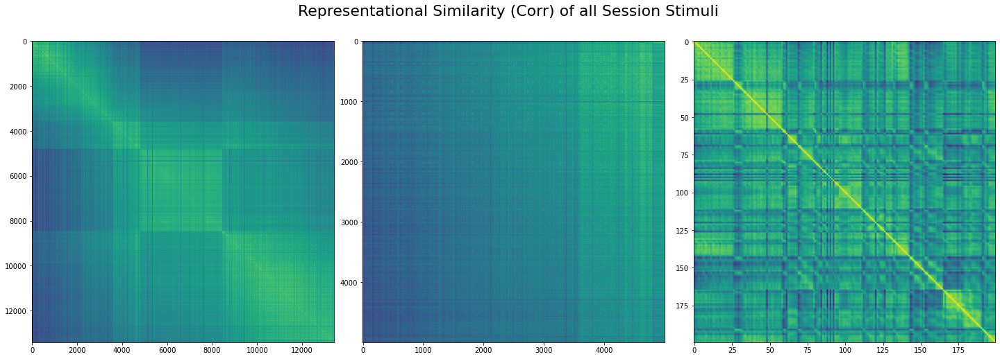

In [63]:
M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)


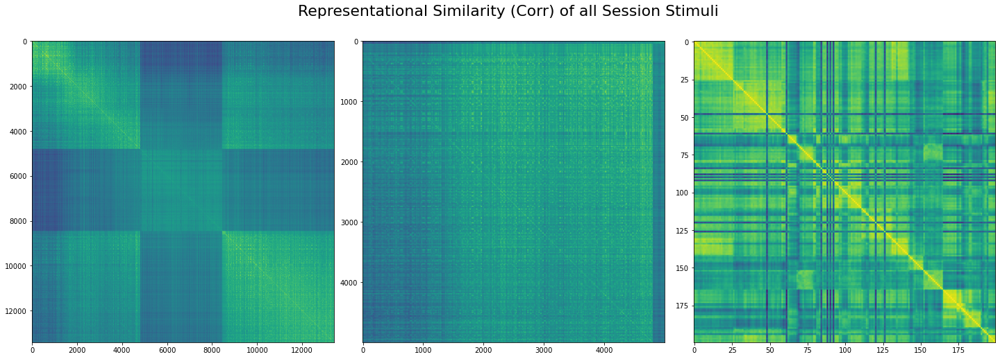

In [64]:
M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)


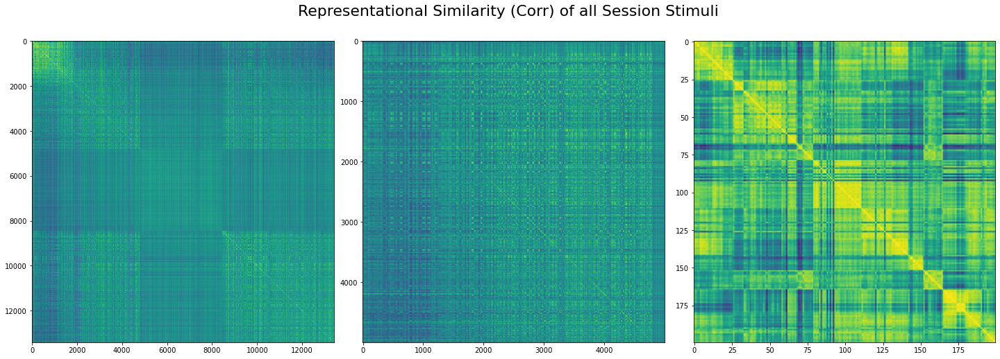

In [65]:
M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)


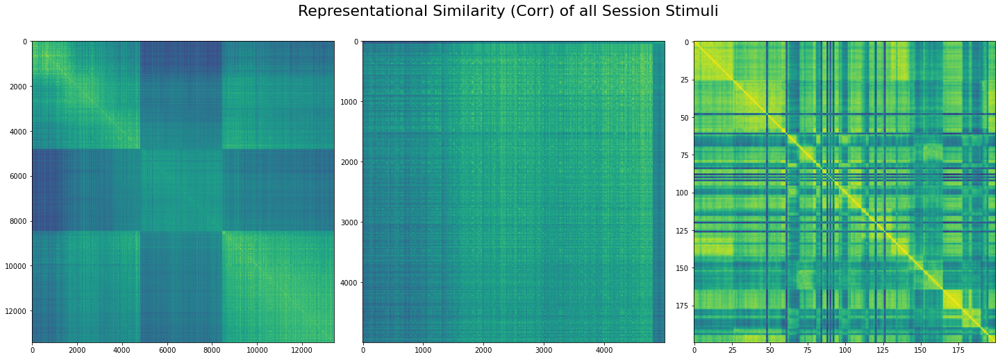

In [66]:
M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)


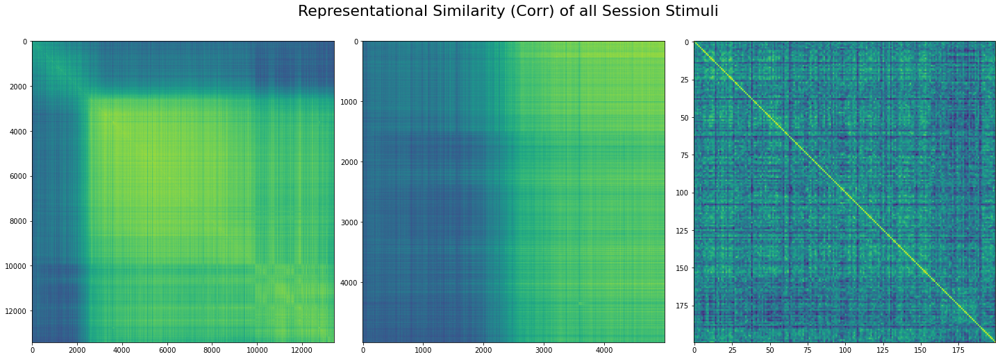

In [67]:
M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)


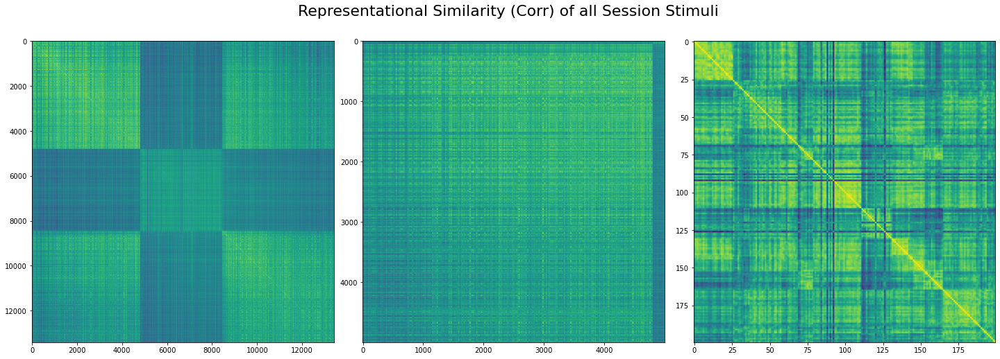

In [68]:
M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)

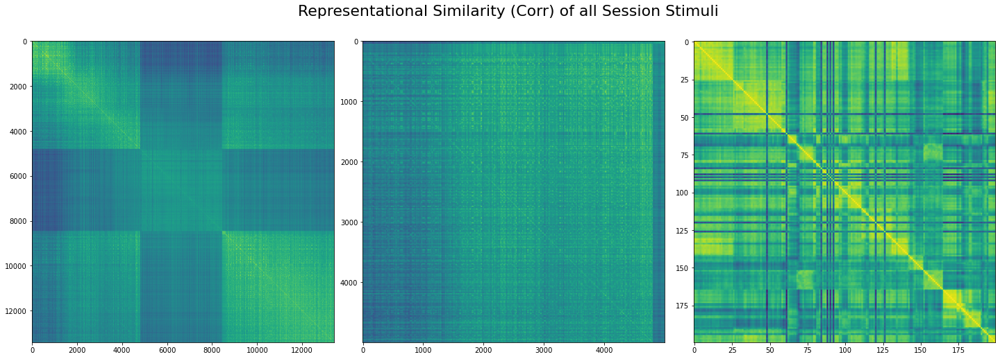

In [69]:
M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)

### 2.2 show within image Correlation and between image-pair

(choose 2 images)

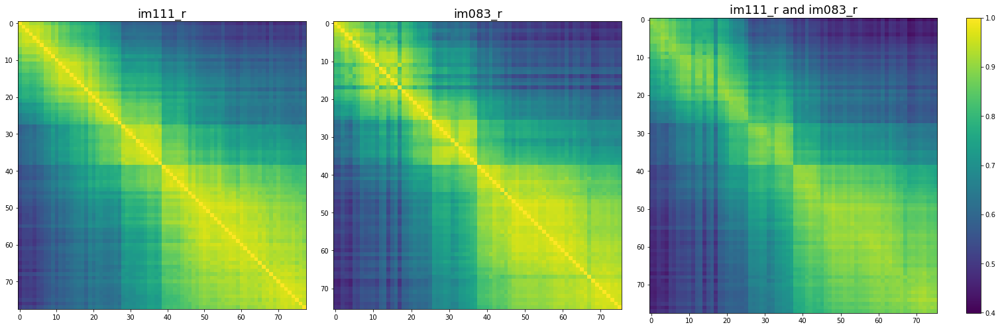

In [70]:
correlation_between_picture_pair('im111_r', 'im083_r', M_all_good, stimulus_presentations)

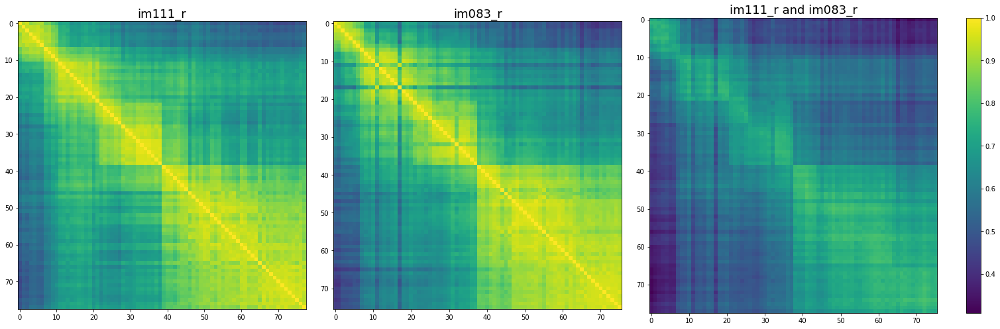

In [71]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VIS, stimulus_presentations)

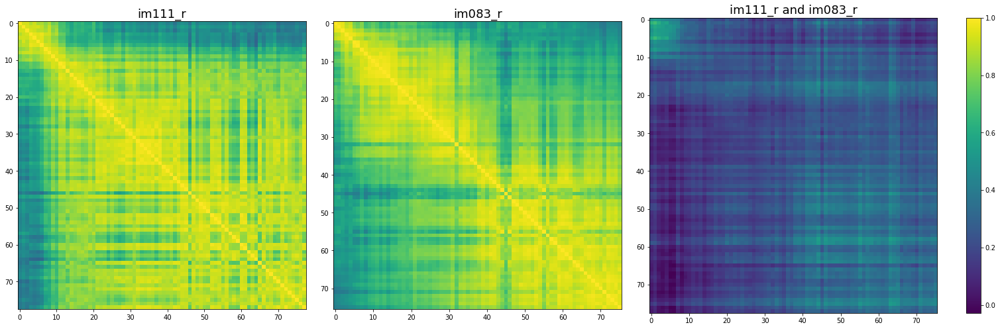

In [72]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VISp, stimulus_presentations)

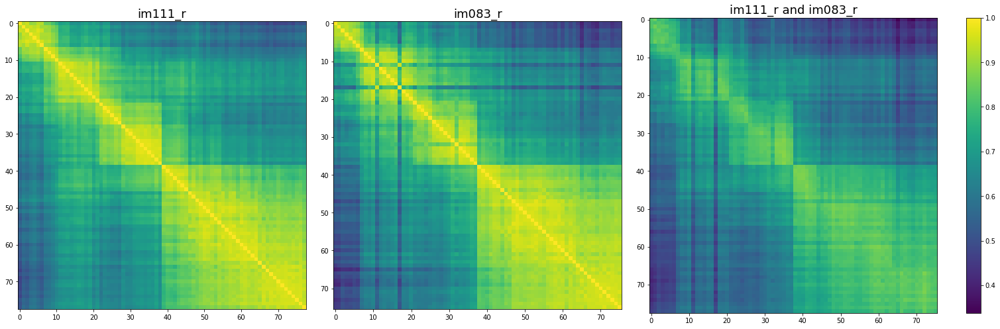

In [73]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_VIS_excld_VISp, stimulus_presentations)

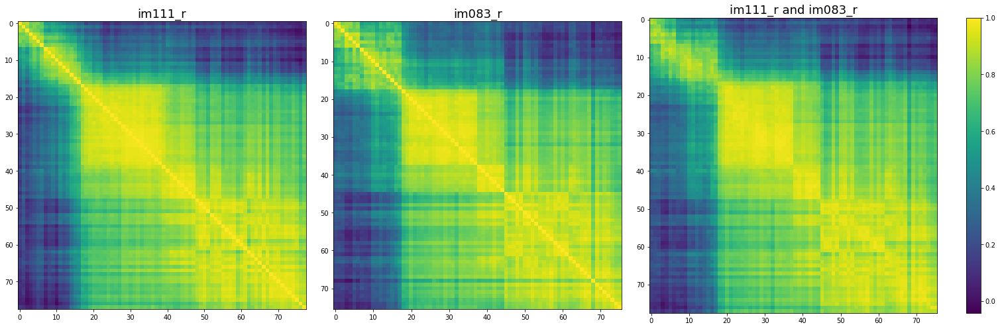

In [74]:
correlation_between_picture_pair('im111_r', 'im083_r', M_good_CA1, stimulus_presentations)

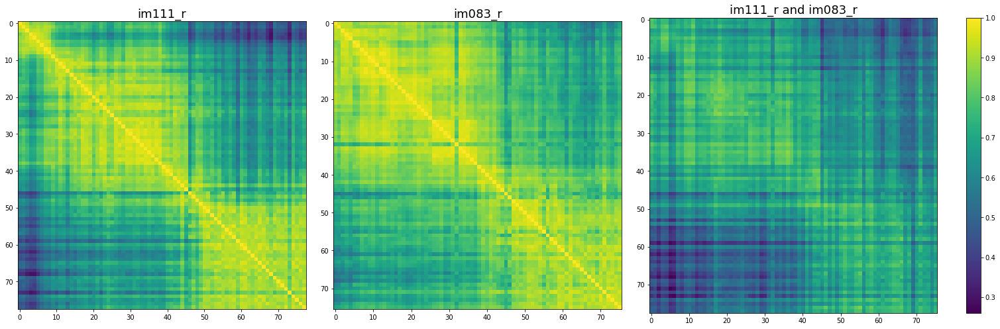

In [75]:
correlation_between_picture_pair('im111_r', 'im083_r', M_marked_VIS, stimulus_presentations)

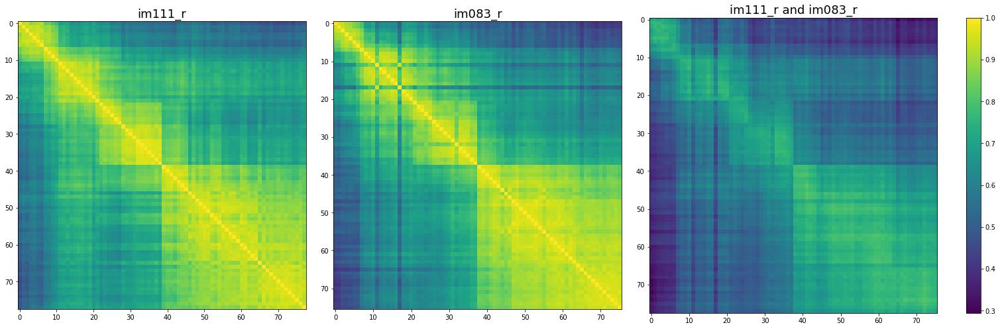

In [76]:
correlation_between_picture_pair('im111_r', 'im083_r', M_VIS_no_tag, stimulus_presentations)

# 3. Representational Similarity, Pupil Area and Running Speed 
averaged over same image chains

In [77]:
valid_images = []
for im in stimulus_presentations.image_name.unique():
    if (im != 'omitted') and (type(im) is not float):
        valid_images.append(im)
        
print(valid_images)


['im104_r', 'im087_r', 'im024_r', 'im111_r', 'im005_r', 'im083_r', 'im034_r', 'im114_r']


### 3.1 one image
plot RS with Behaviour and Time for a specified image
 

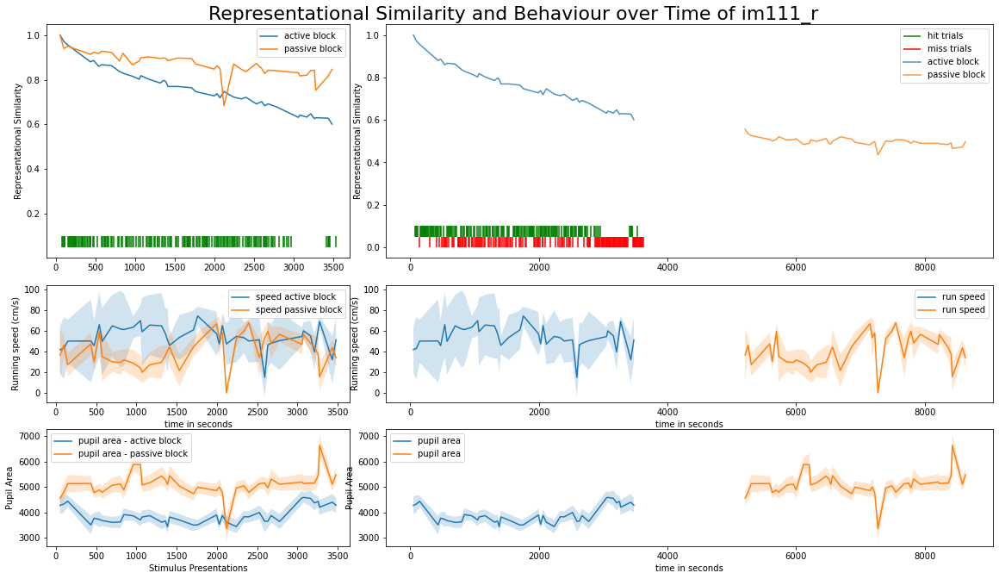

In [29]:
specific_image('im111_r', M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials)

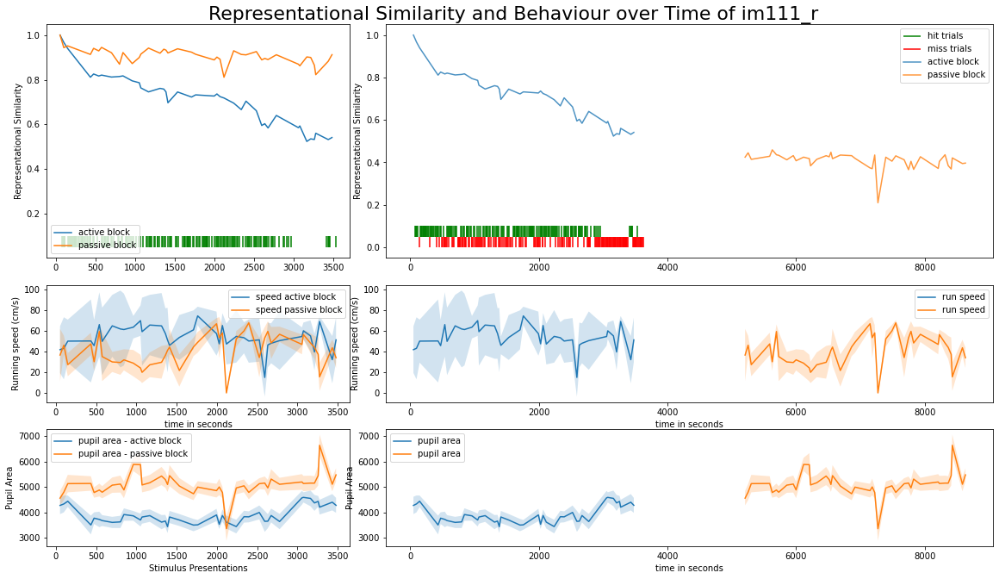

In [30]:
specific_image('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials)

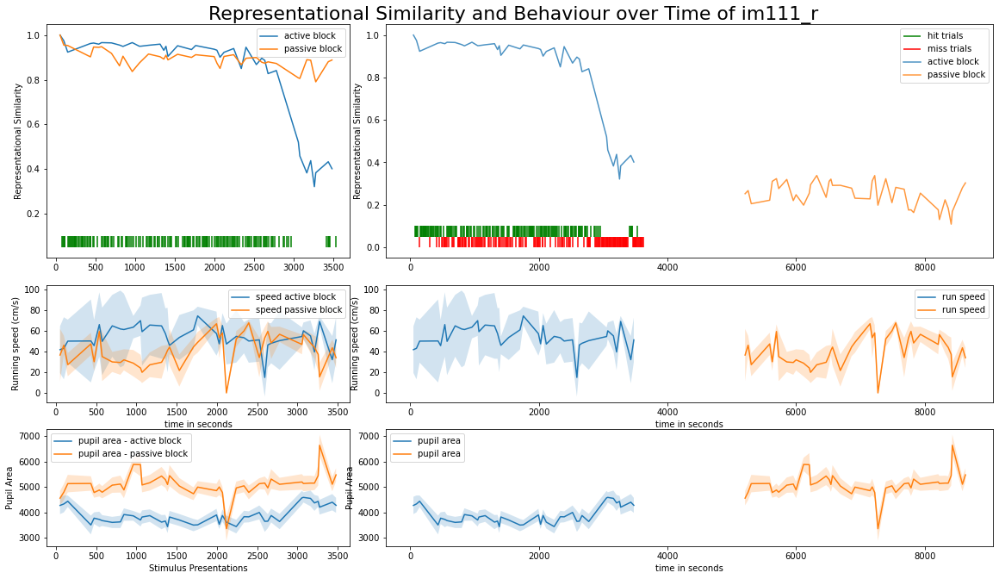

In [31]:
specific_image('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

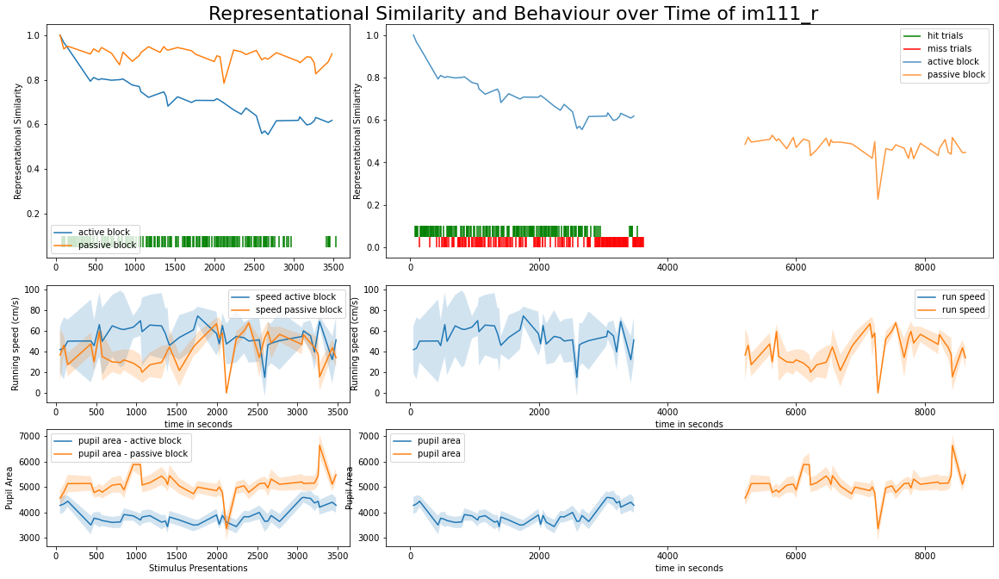

In [32]:
specific_image('im111_r', M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

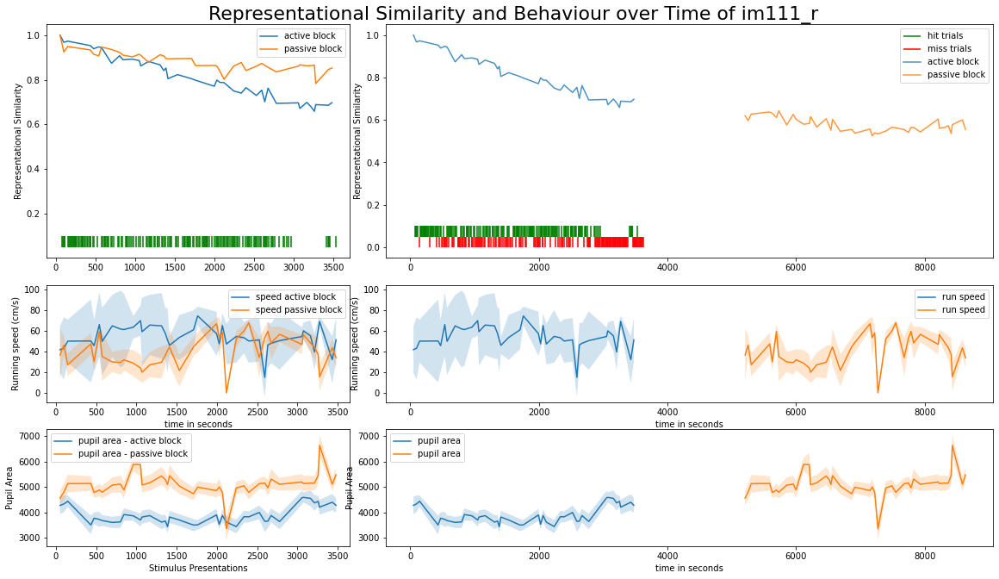

In [46]:
specific_image('im111_r', M_good_CA1, stimulus_presentations, running_speed, eye_tracking, change_trials)

### 3.2 all images layered
same plot with all images at once 

In [83]:
colors = ['blue', 'orange', 'purple', 'firebrick', 'cornflowerblue', 'darkblue', 'magenta', 'green', 'thistle']

In [84]:
sessionID

1124285719

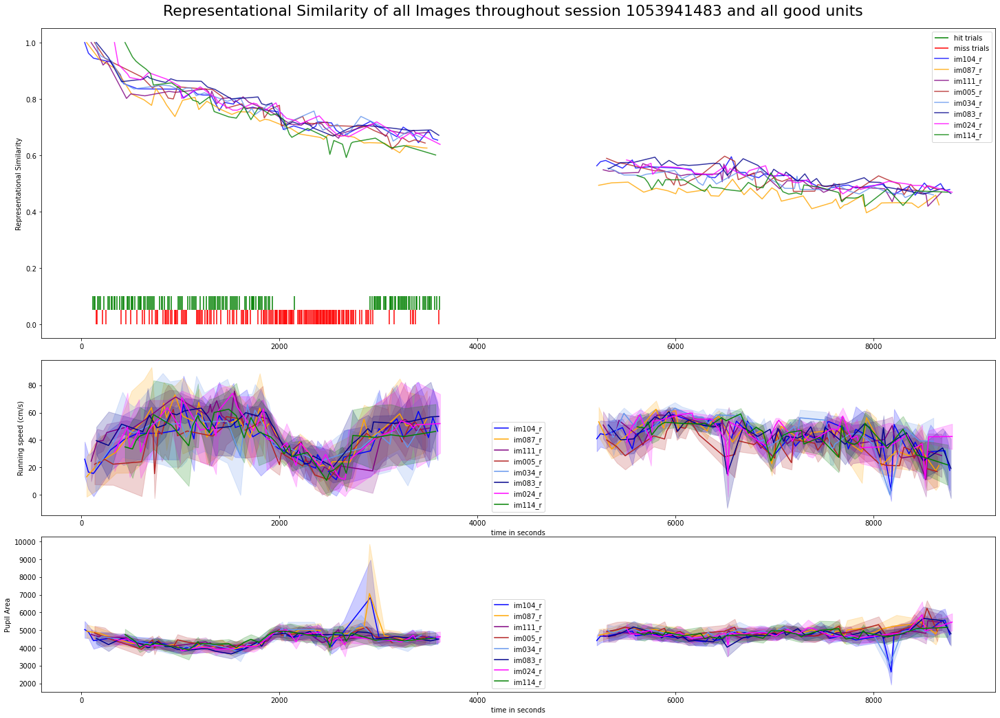

In [38]:
# print all images layered for M_all_good
title = f'Representational Similarity of all Images throughout session {sessionID} and all good units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_all_good, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)



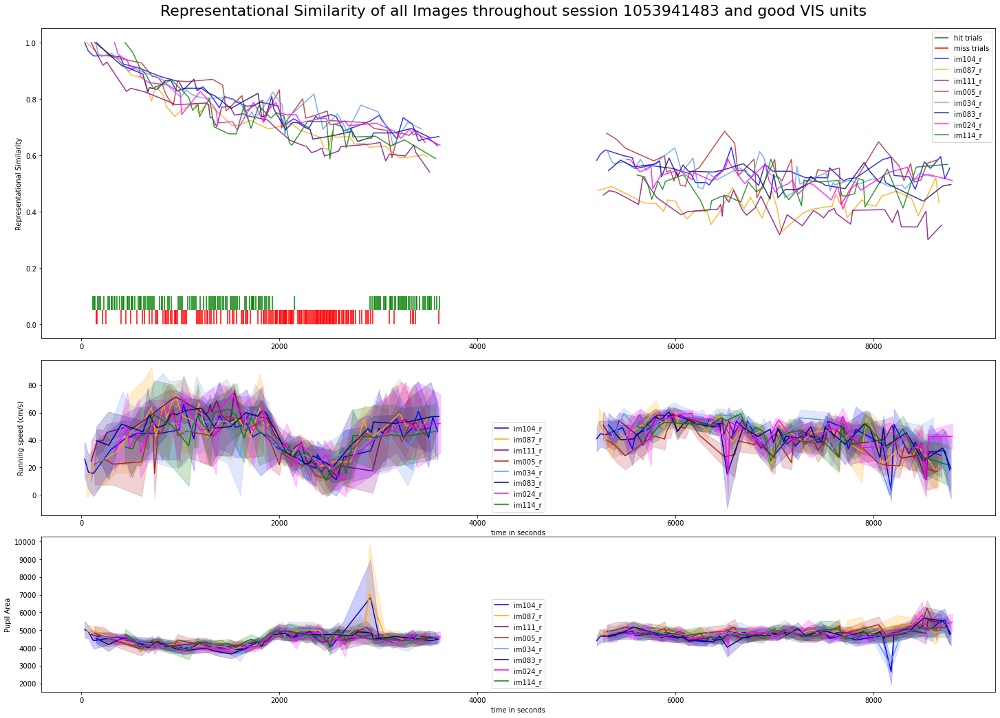

In [39]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good VIS units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


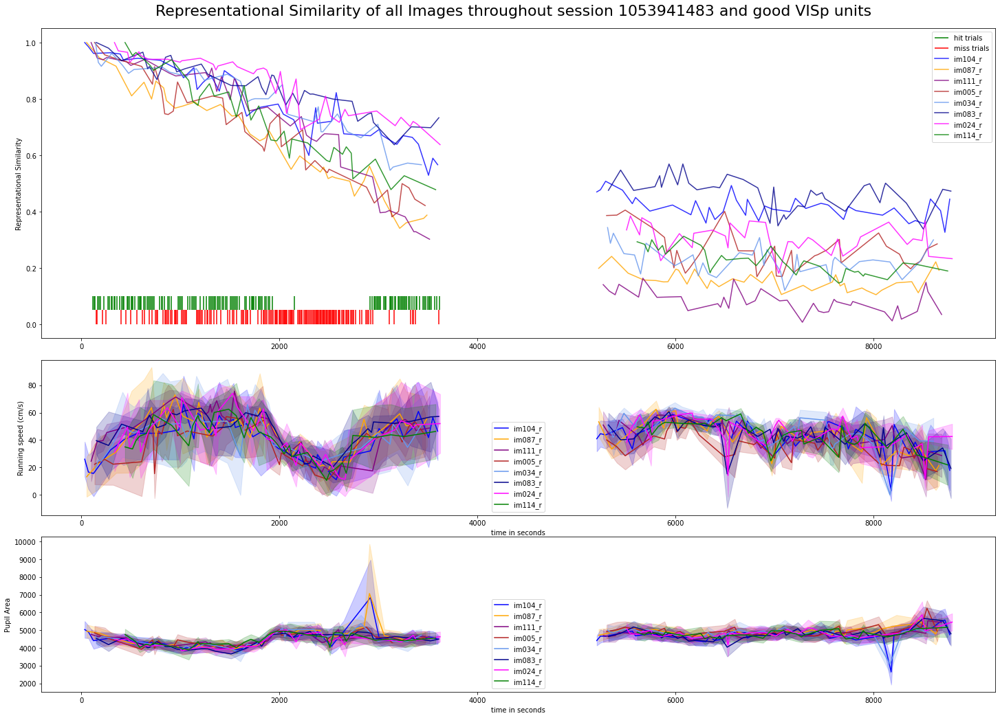

In [40]:

# print all images layered for M
title = f'Representational Similarity of all Images throughout session {sessionID} and good VISp units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


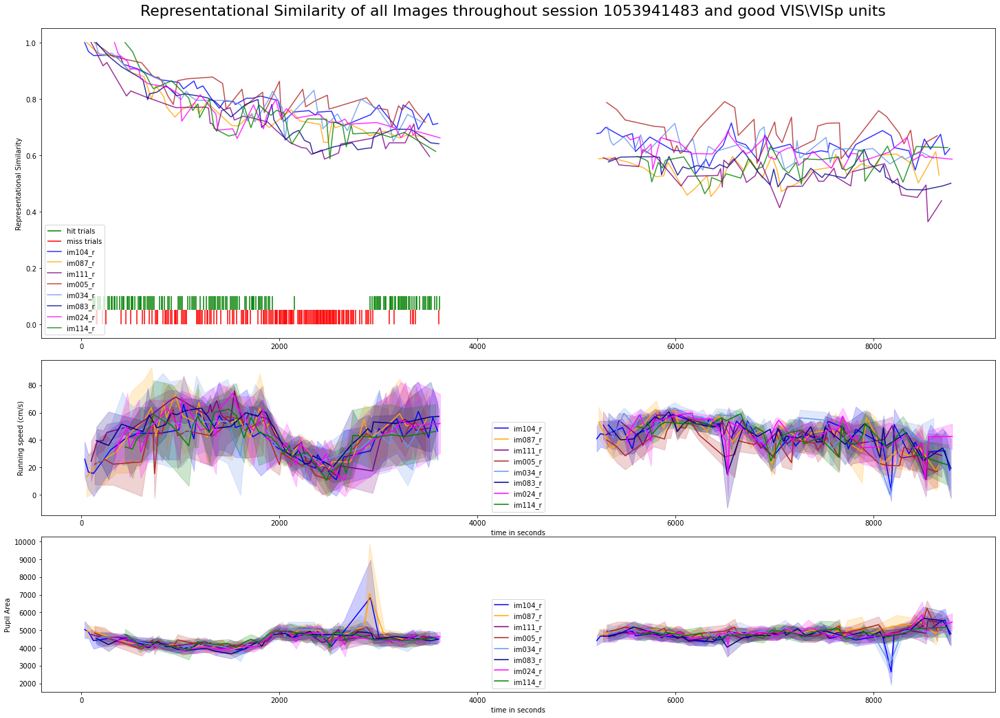

In [41]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good VIS\VISp units'
# print all images layered for M
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


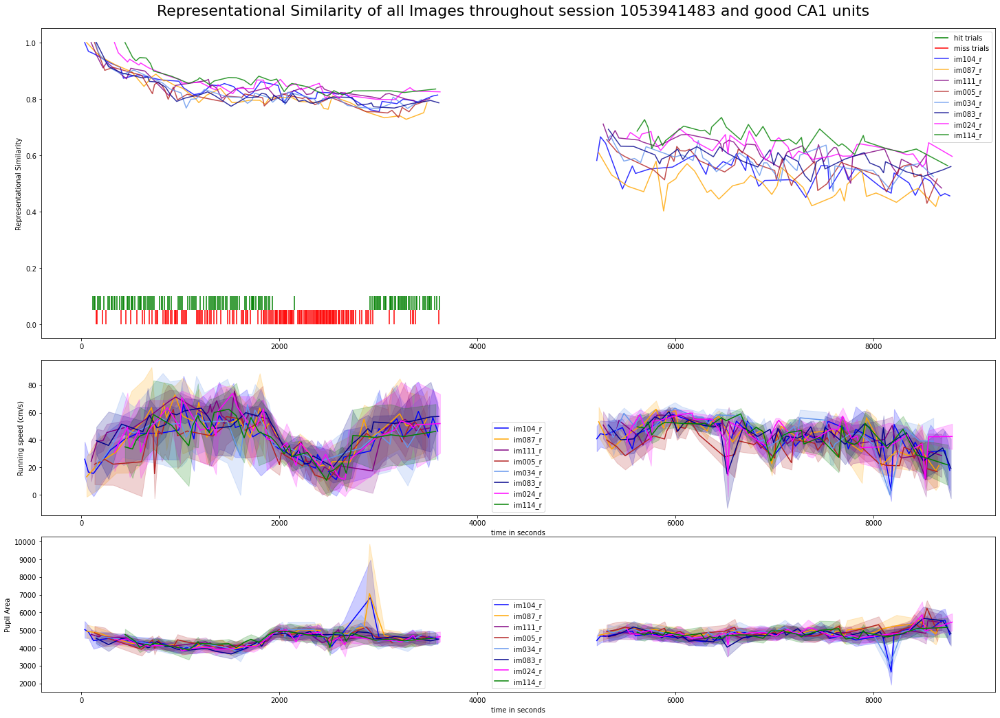

In [42]:
title = f'Representational Similarity of all Images throughout session {sessionID} and good CA1 units'
plot_layered_RS_running_speed_and_pupil_area_all_images(valid_images, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, colors, change_trials, title)


### 3.3 each image
same plot for each image 

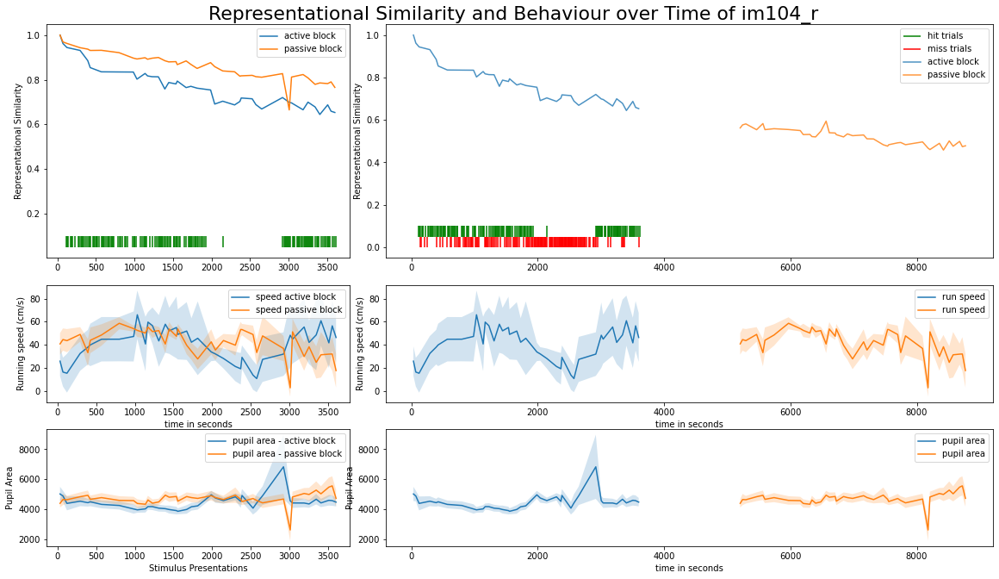

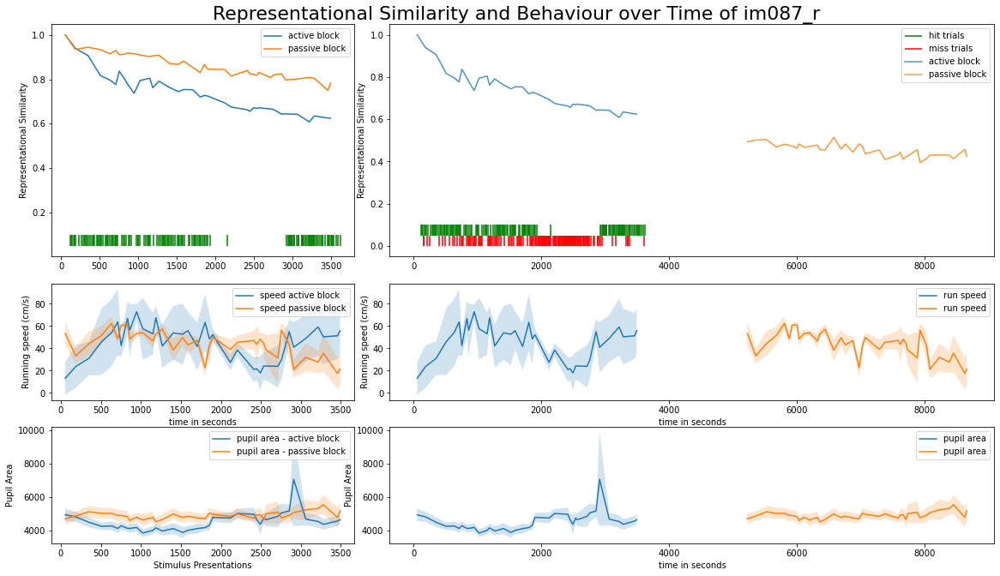

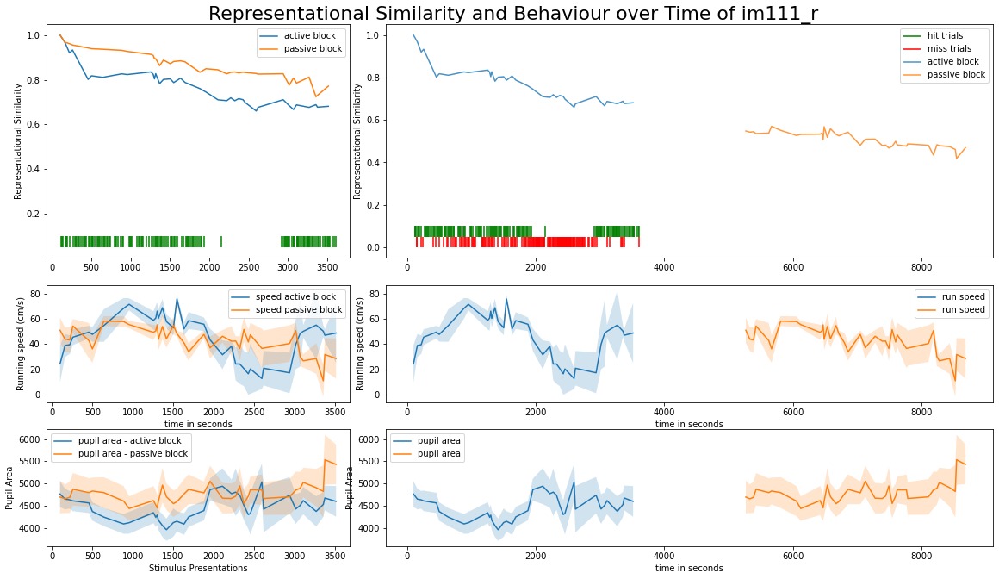

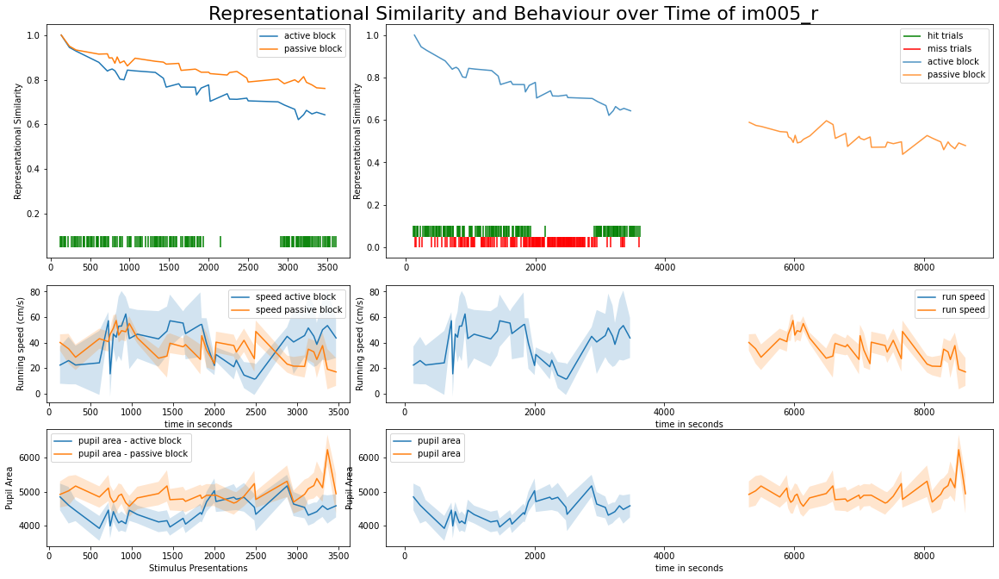

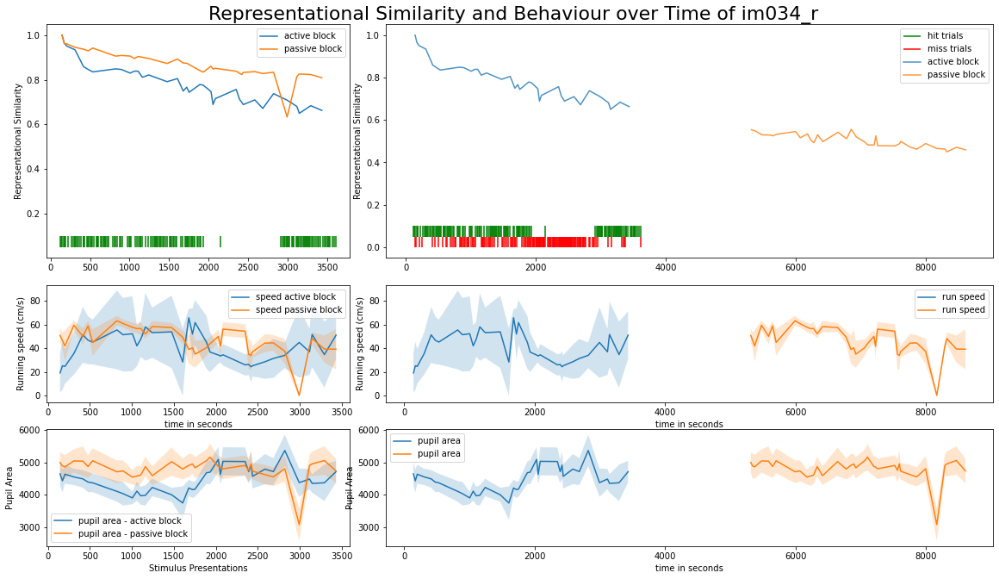

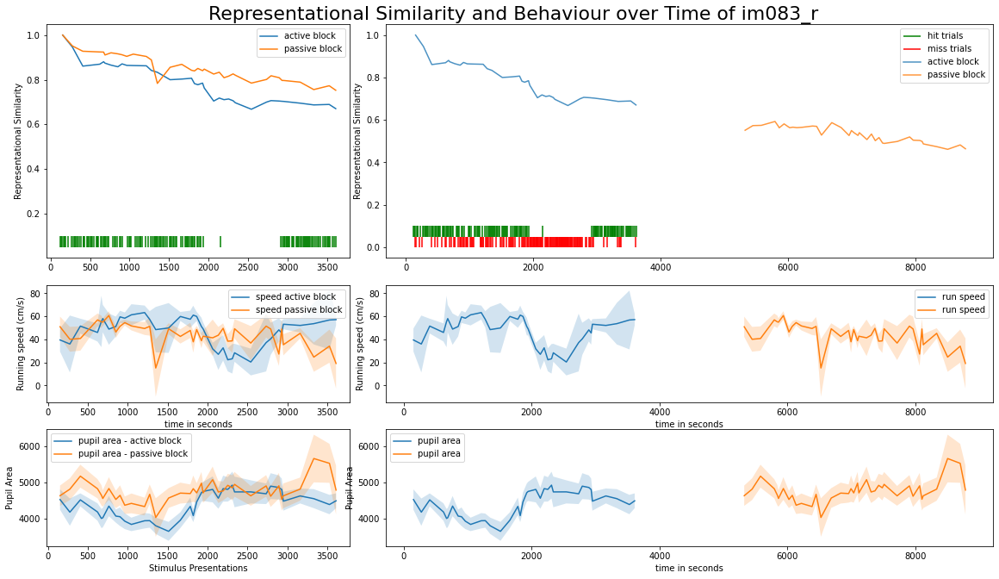

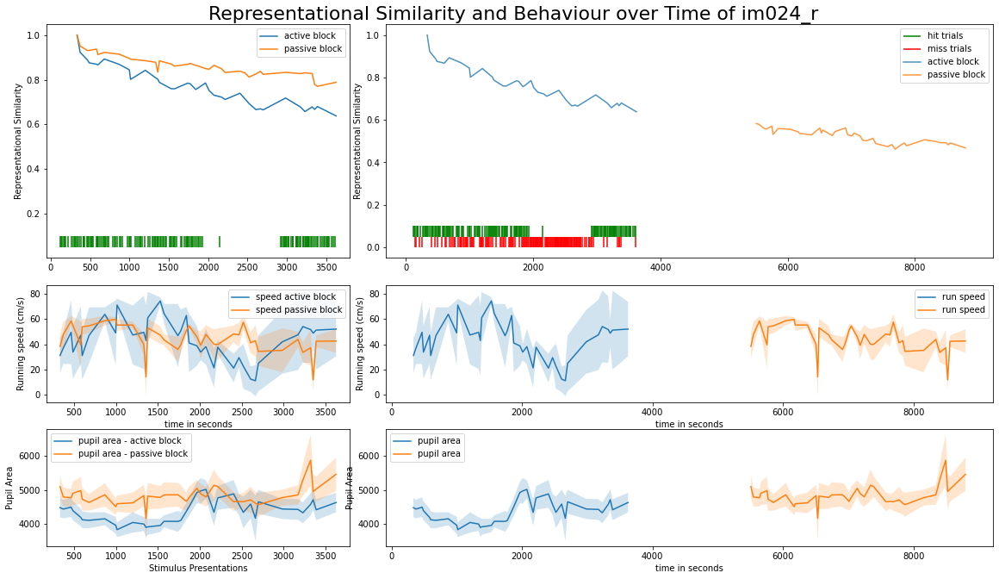

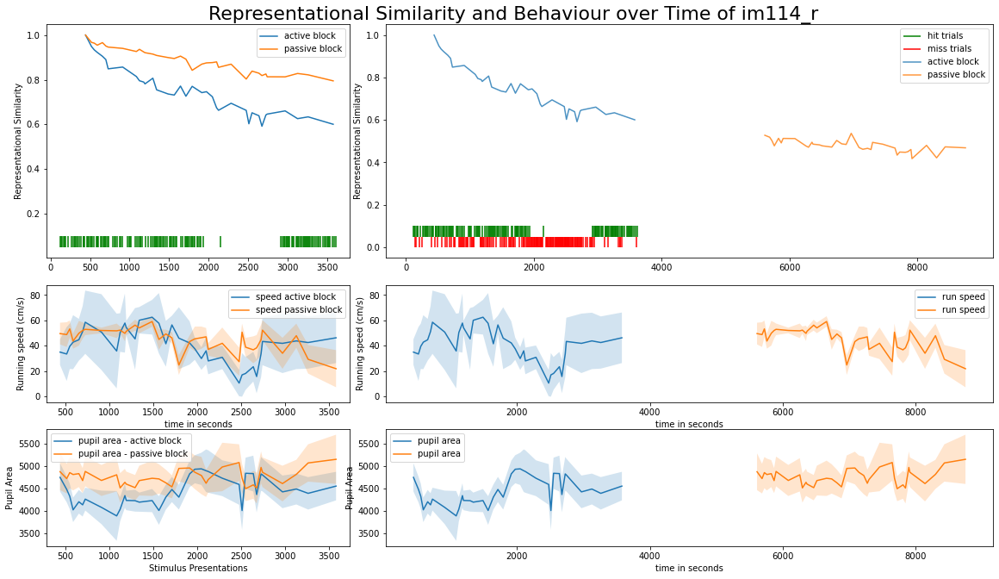

In [44]:
# print all images full information

for image in valid_images:
    specific_image(image, M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials)
    

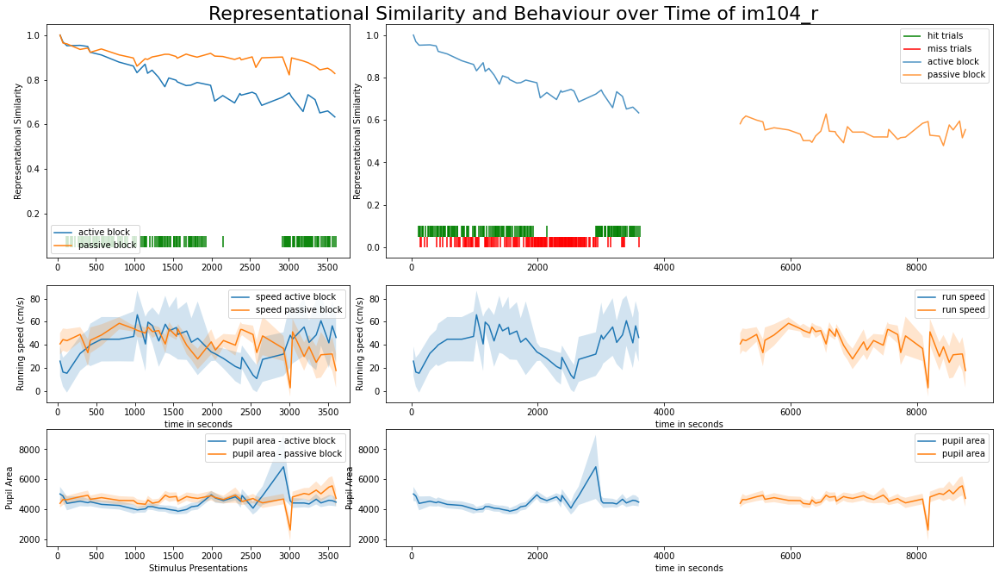

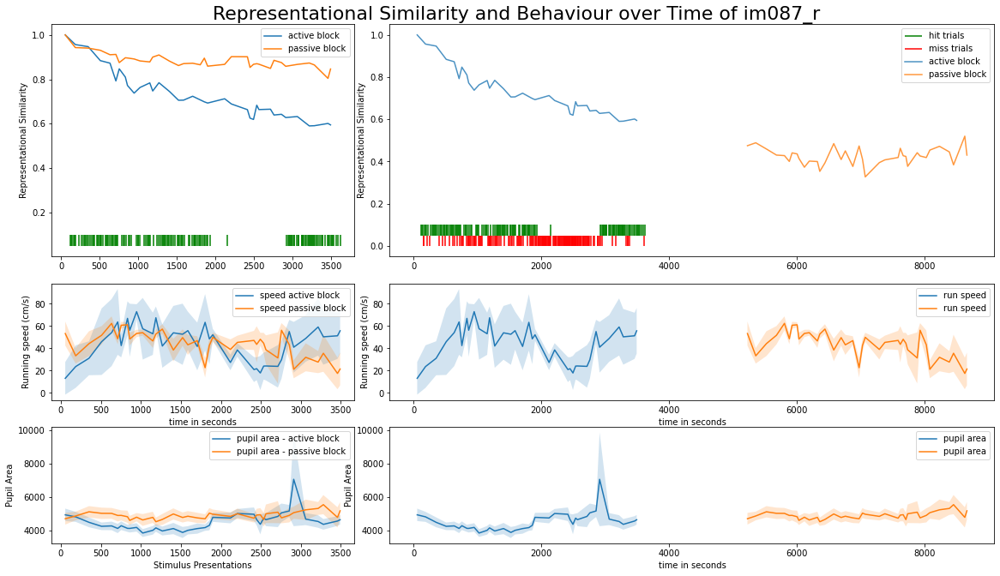

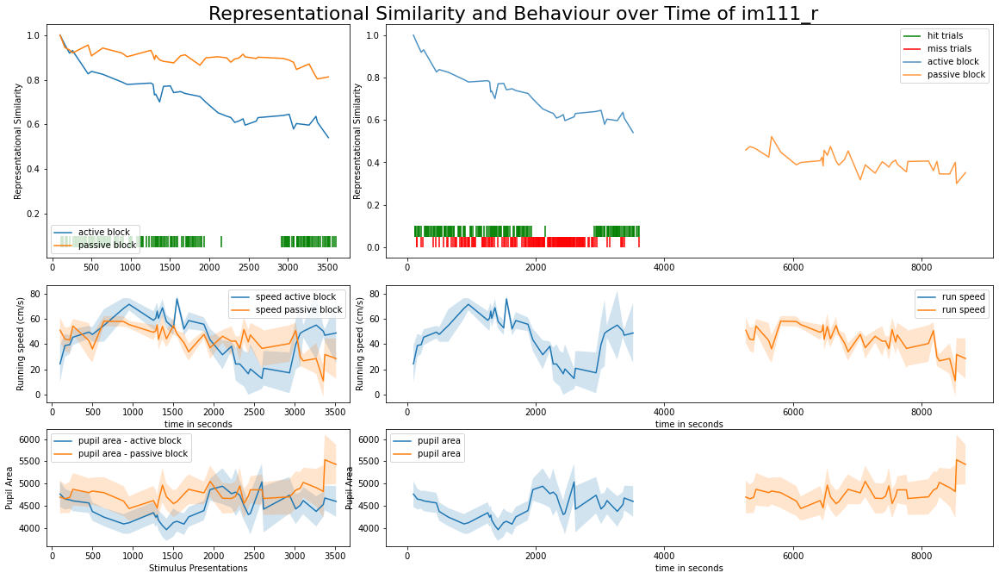

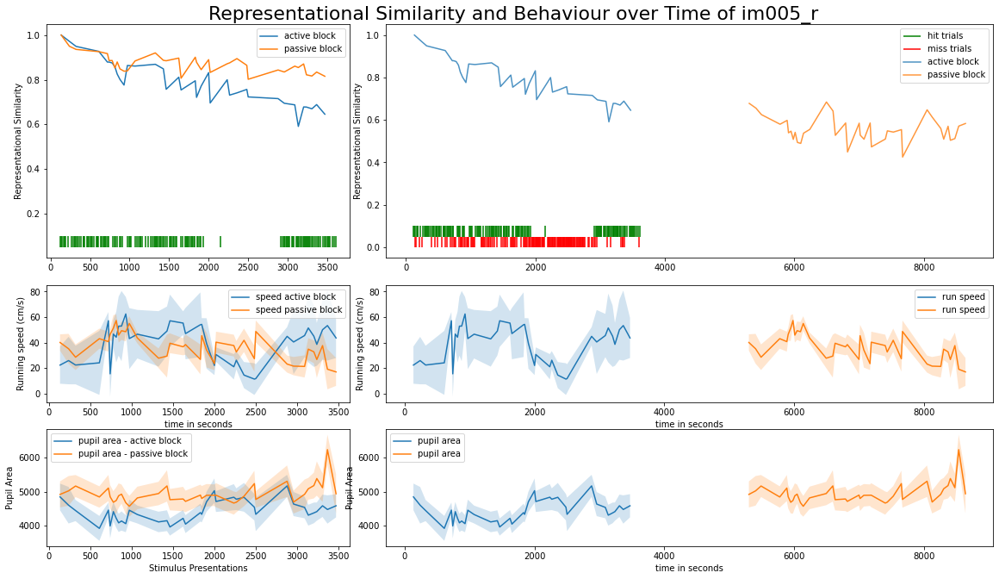

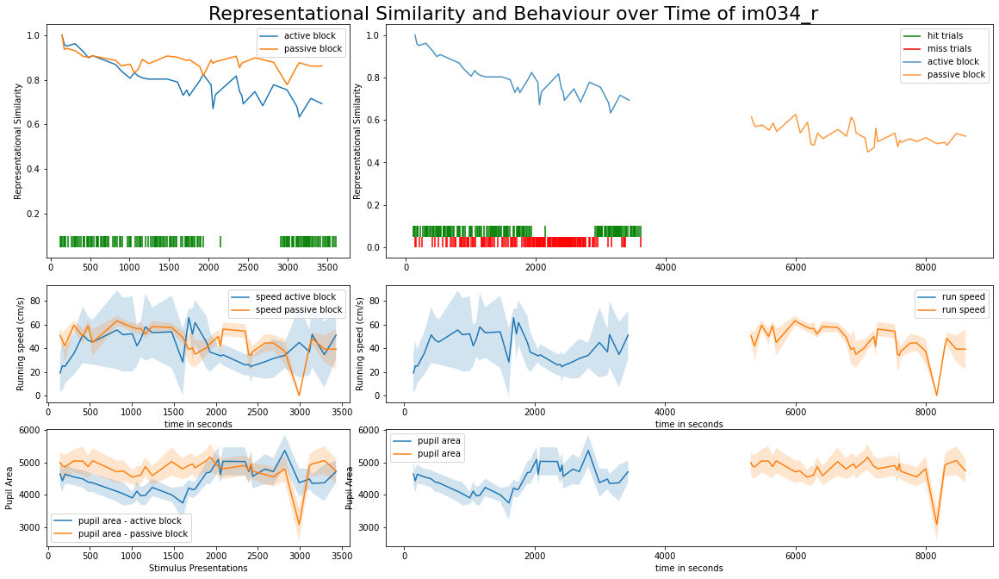

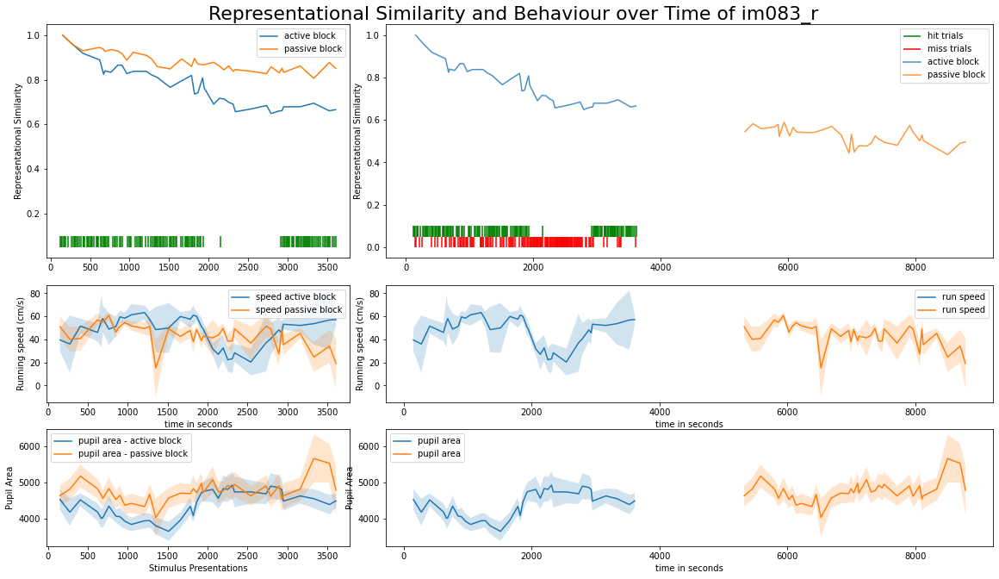

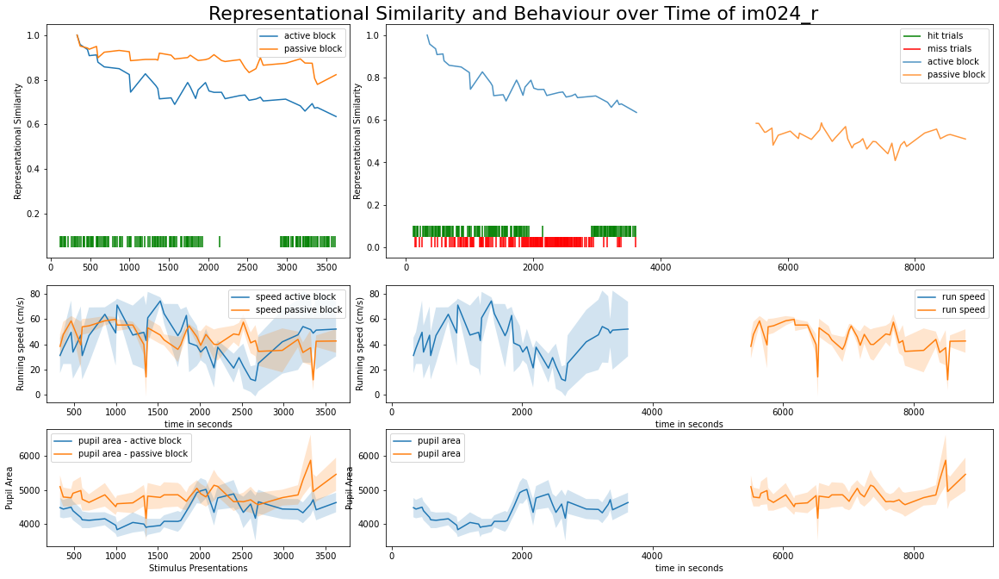

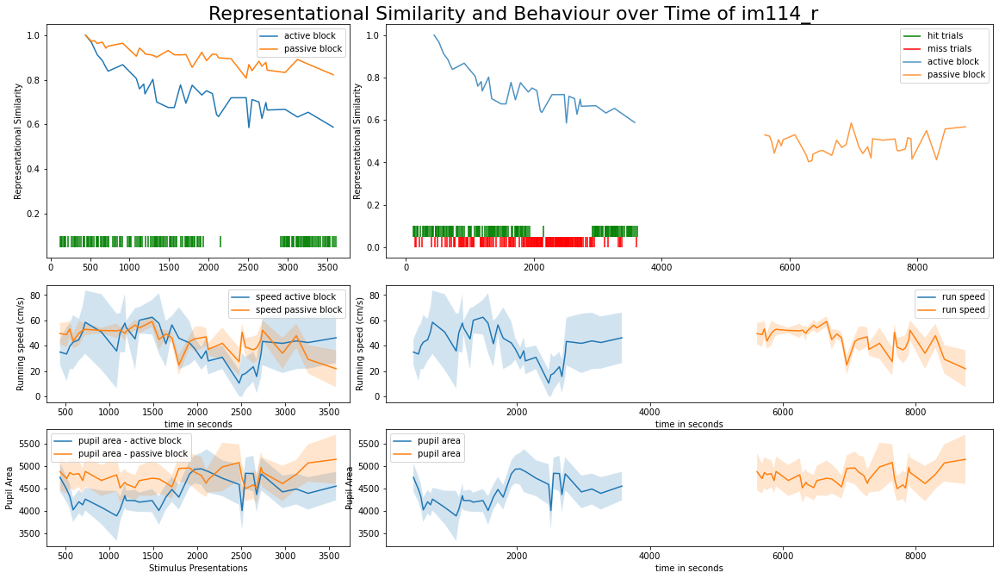

In [45]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials)

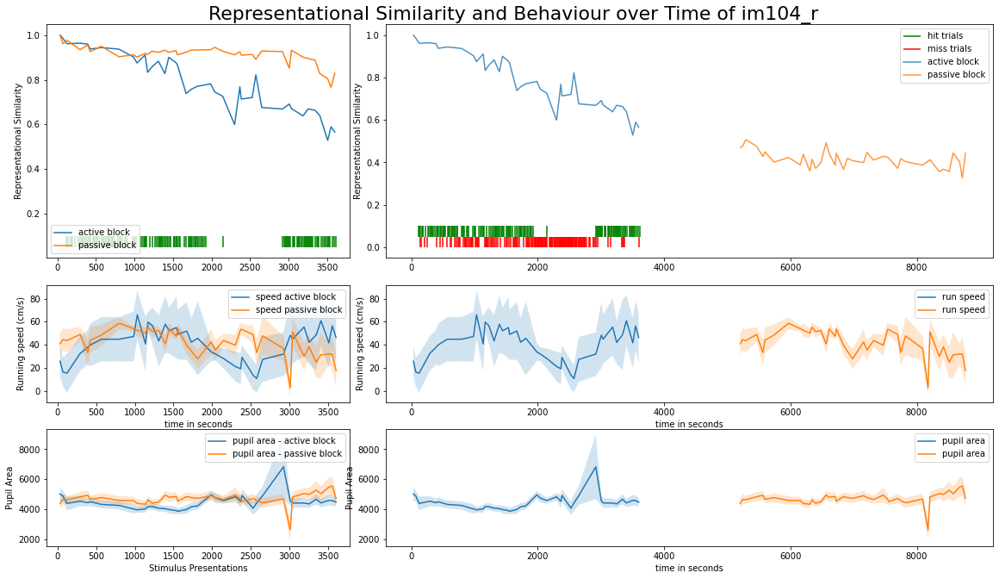

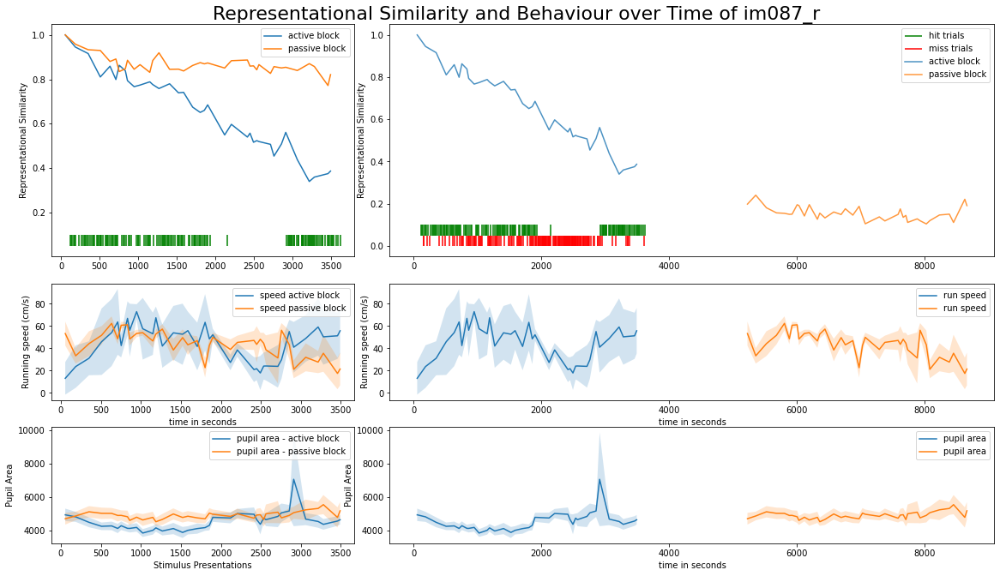

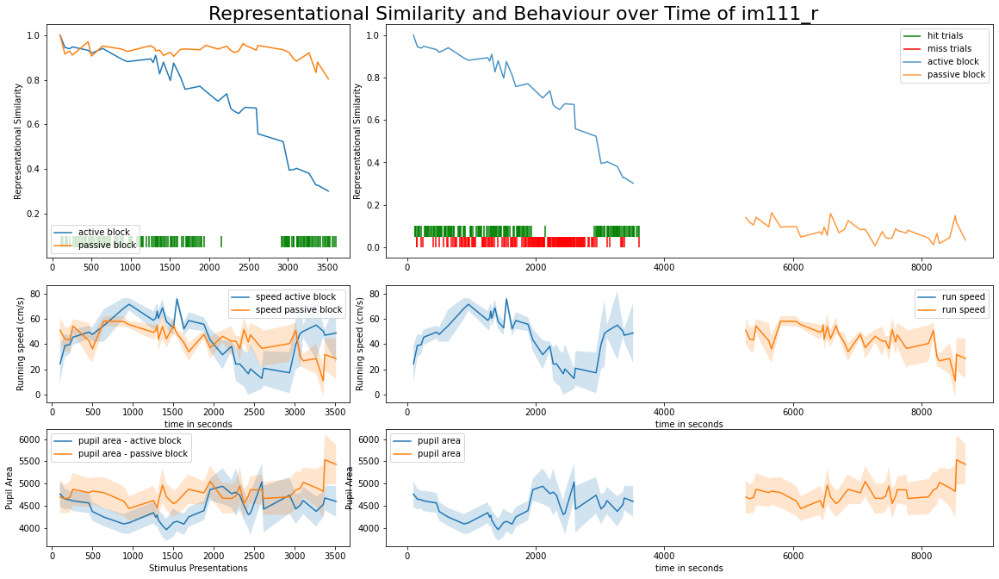

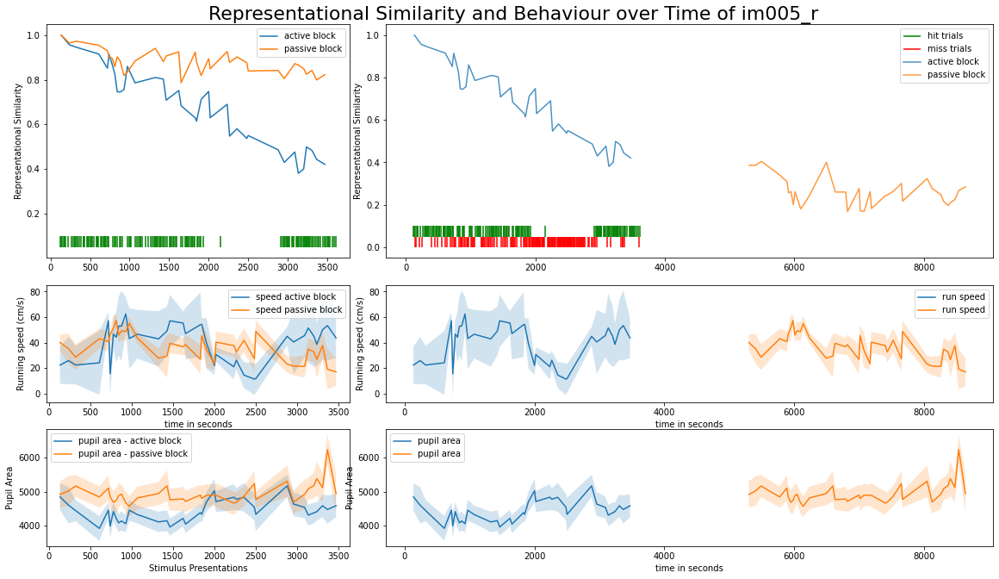

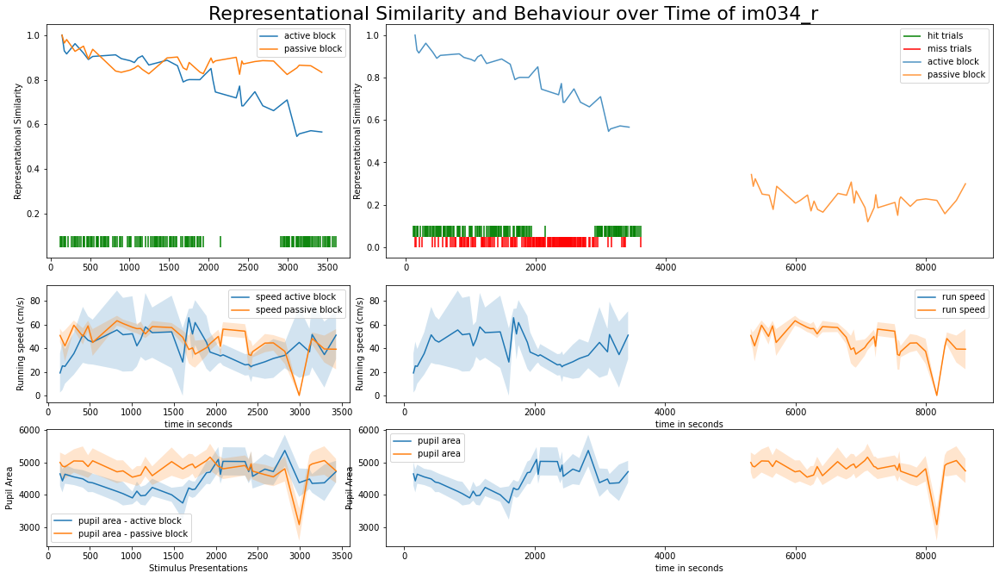

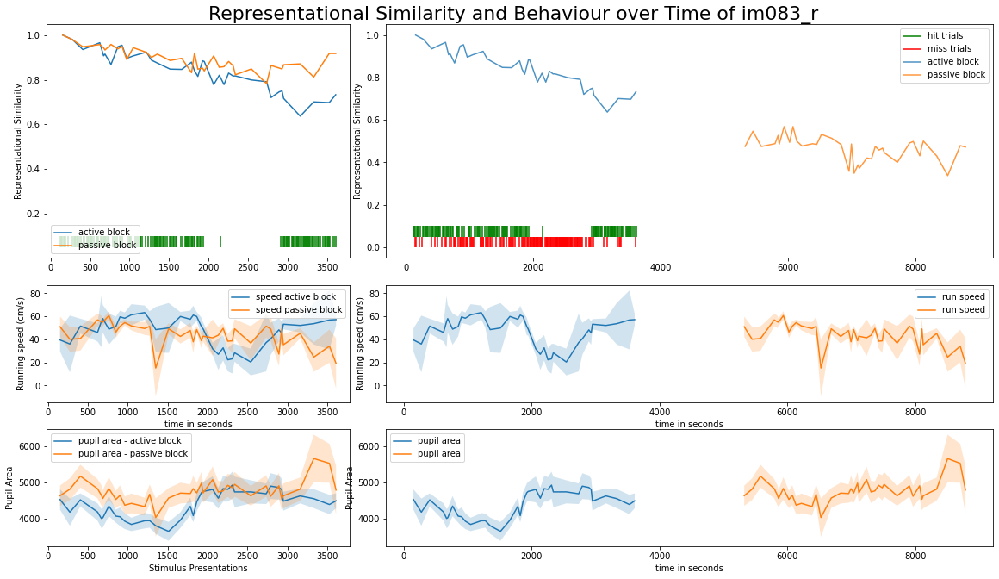

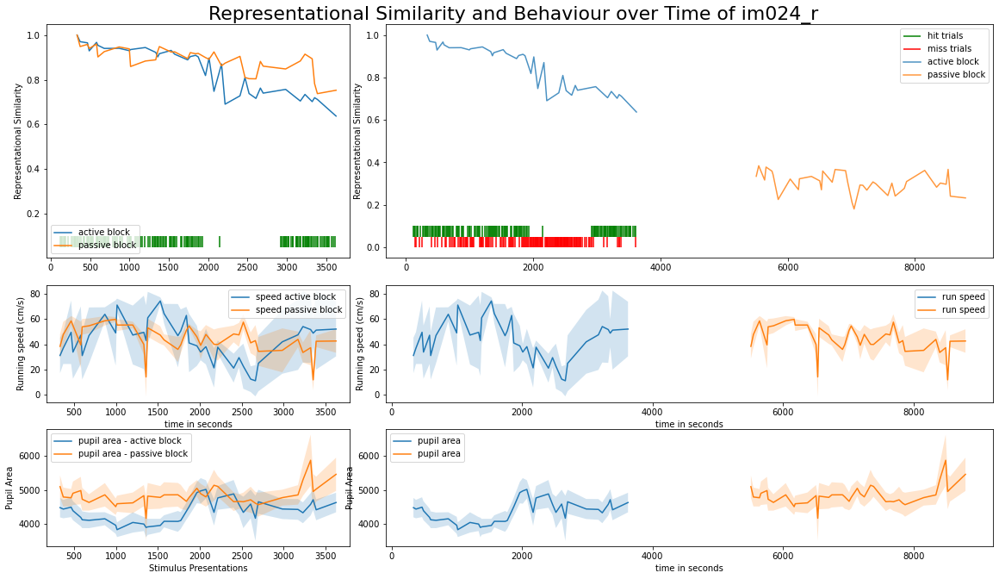

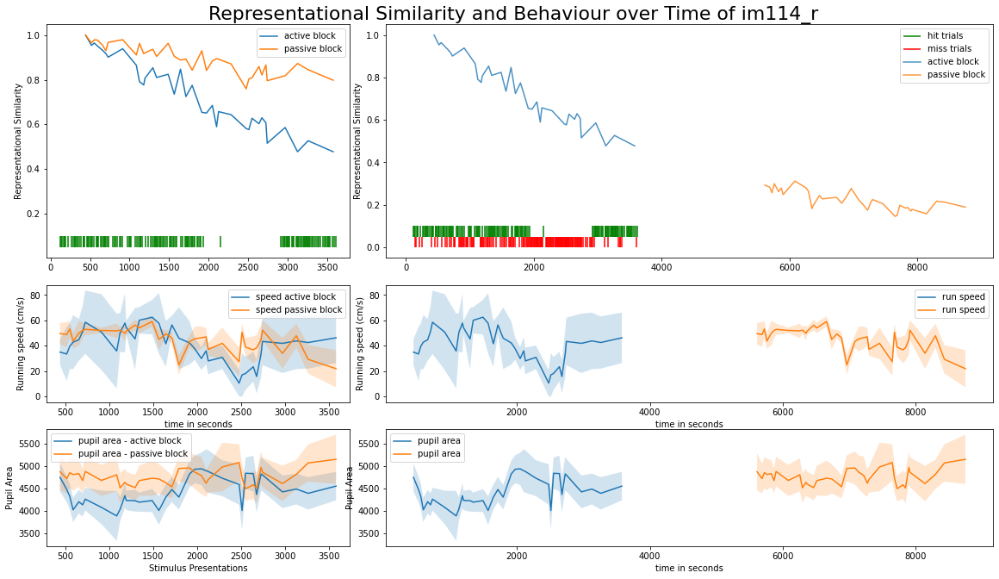

In [46]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

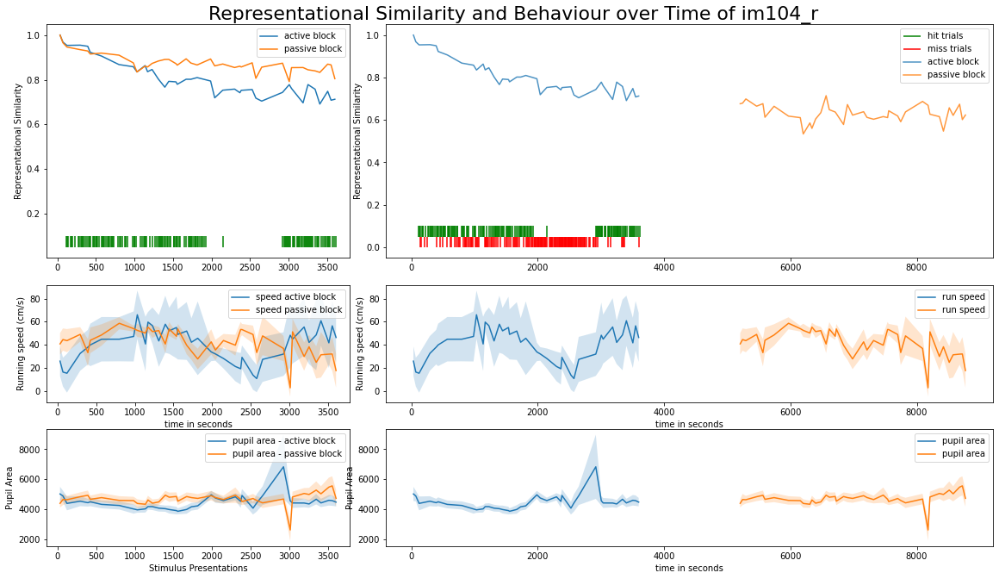

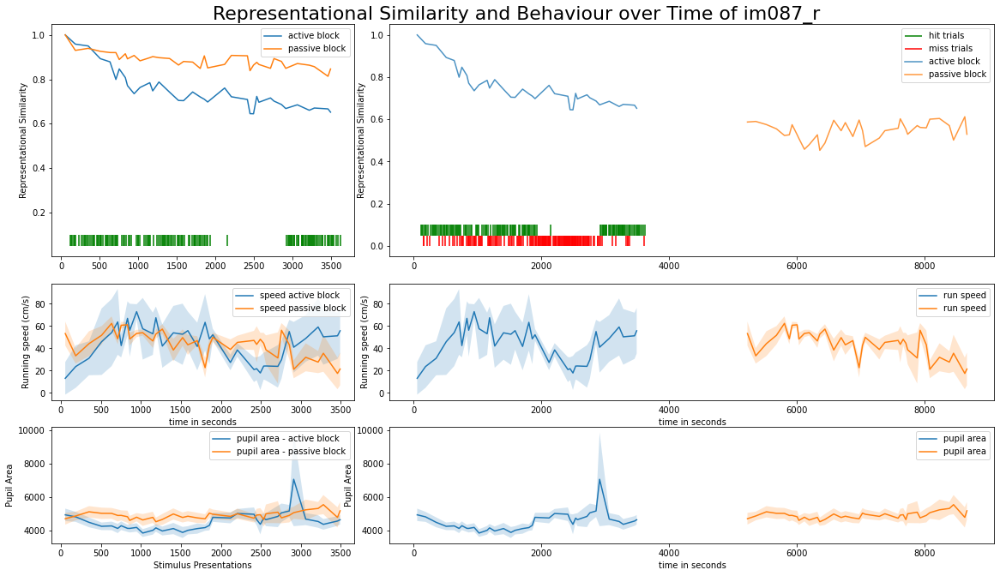

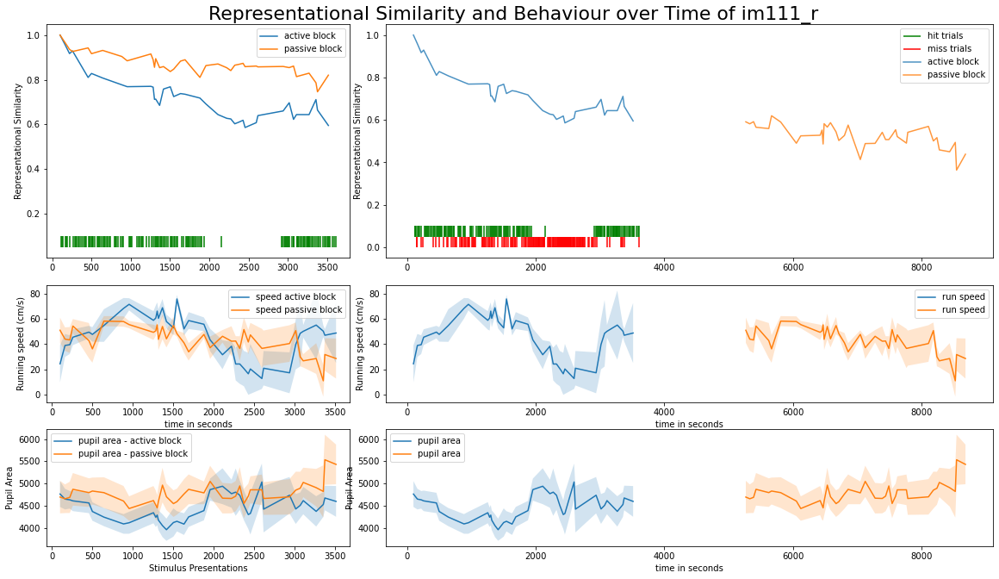

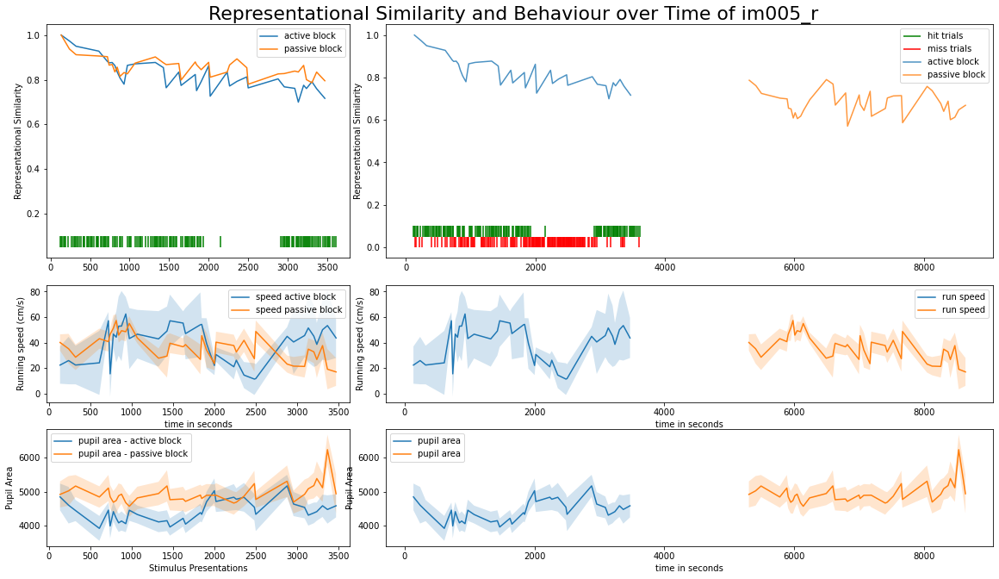

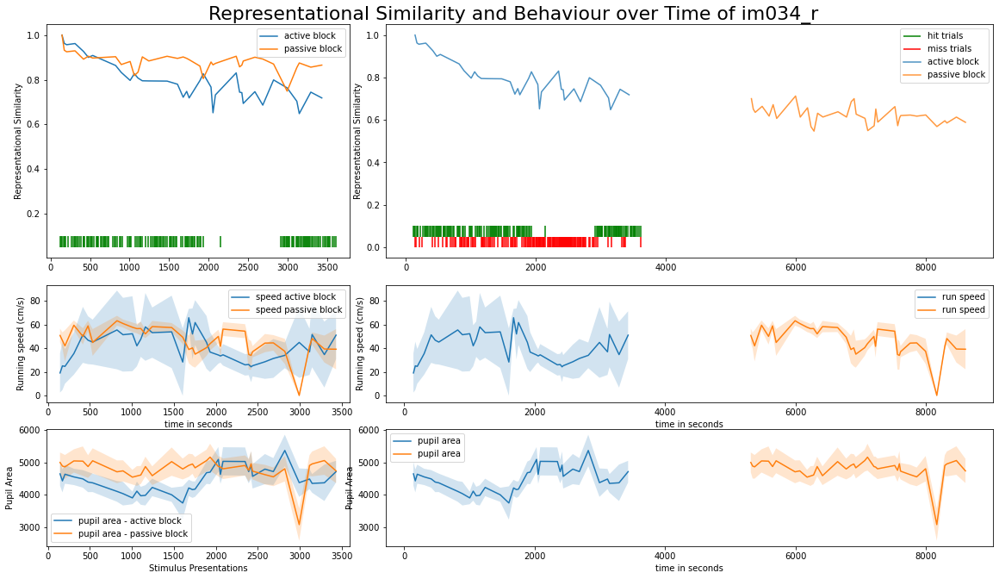

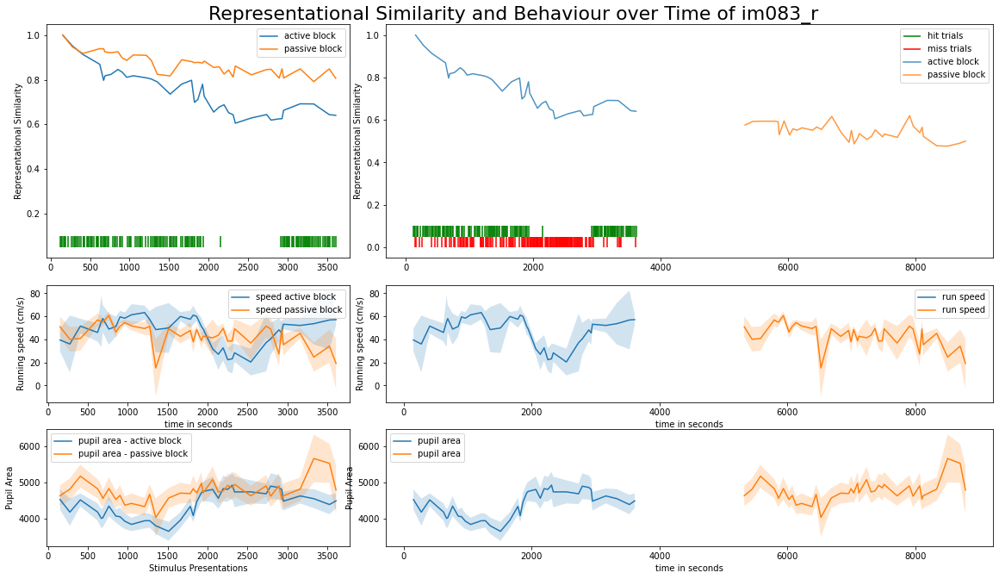

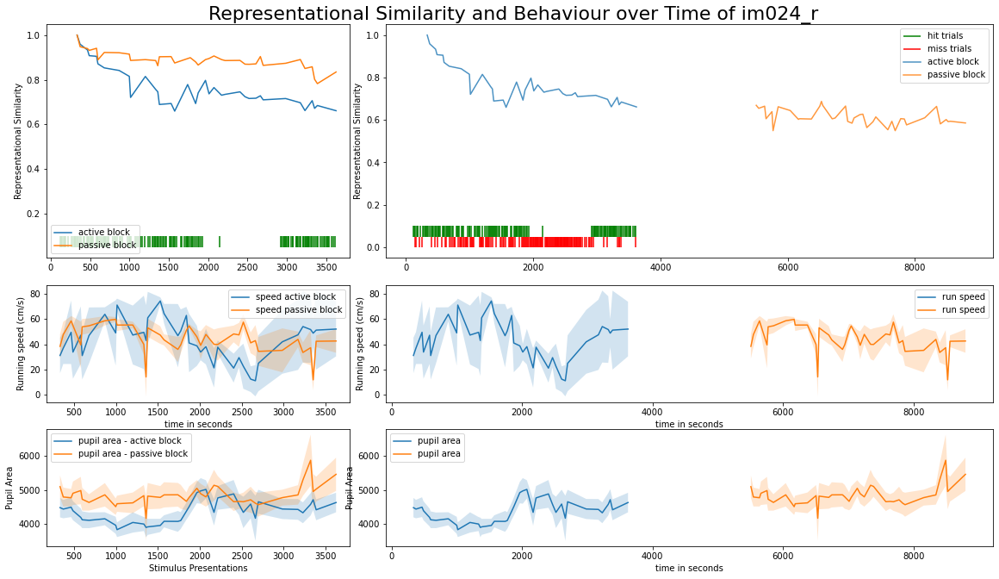

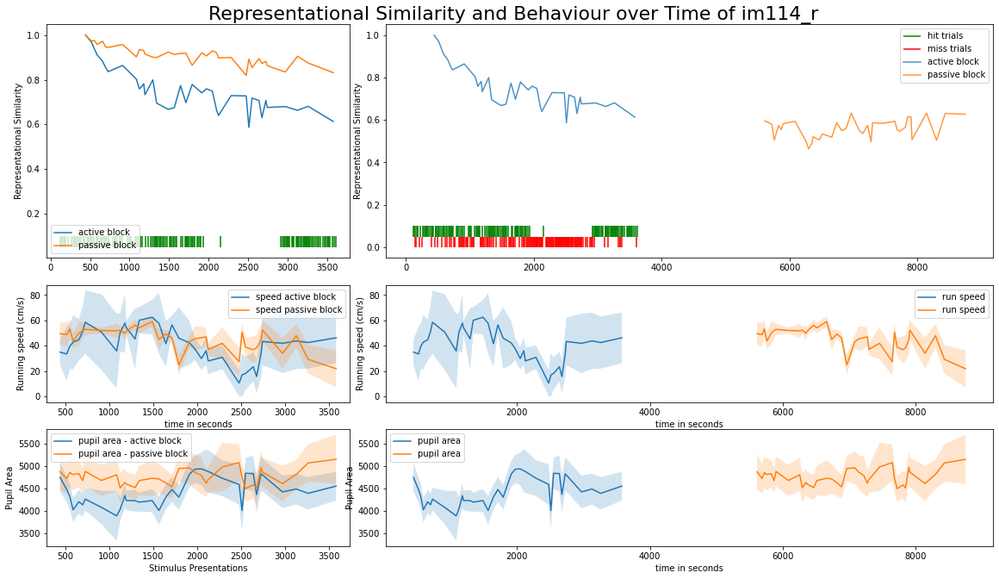

In [47]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials)

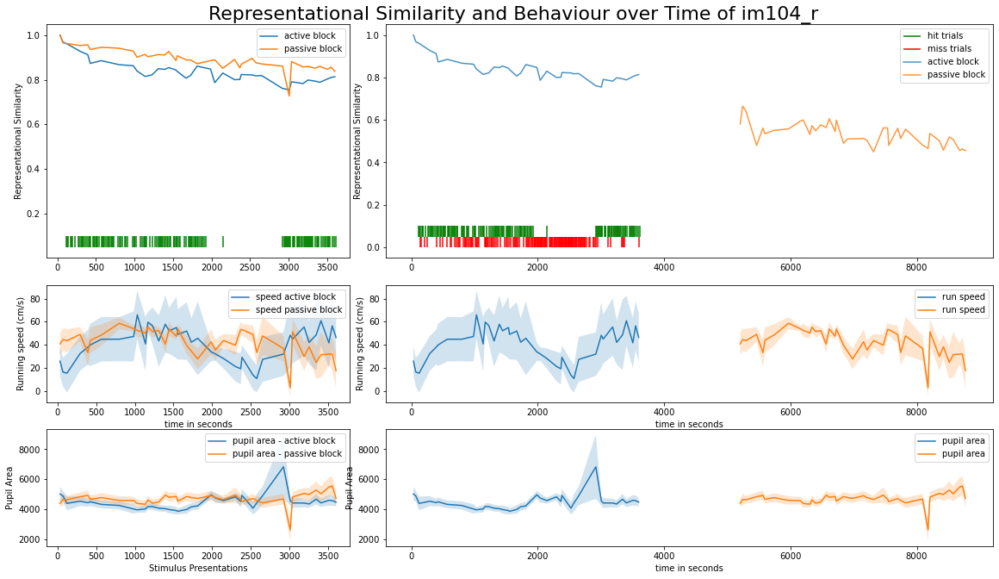

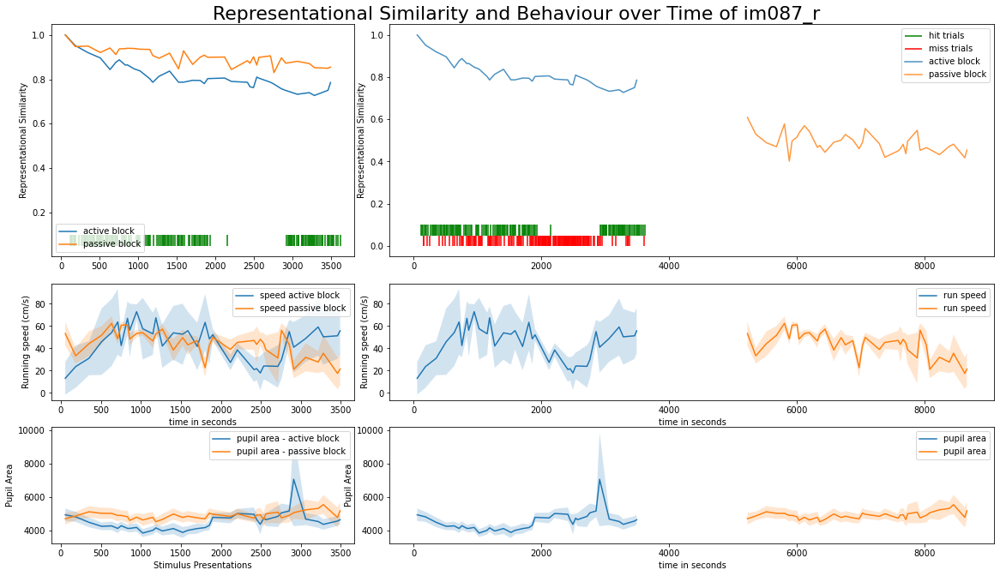

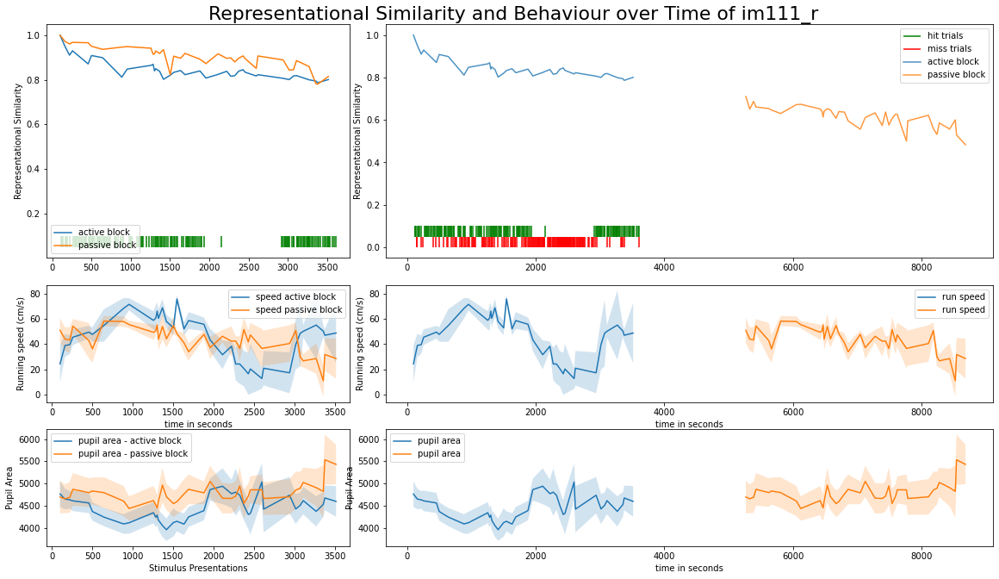

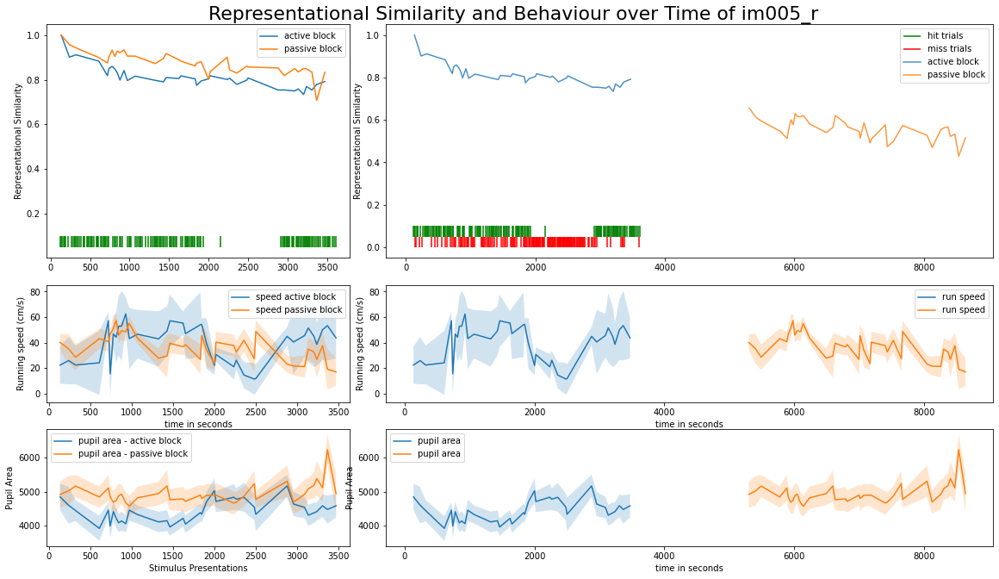

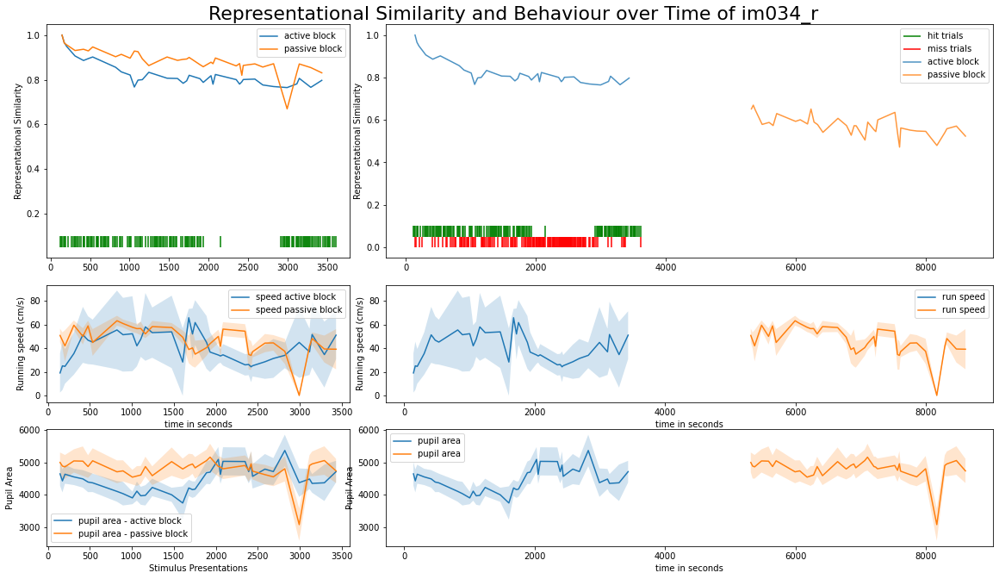

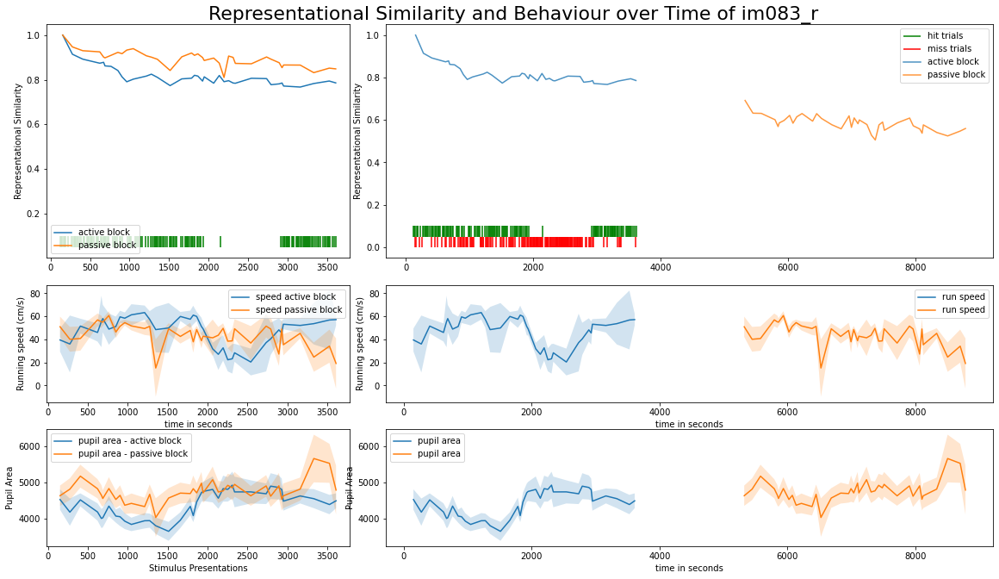

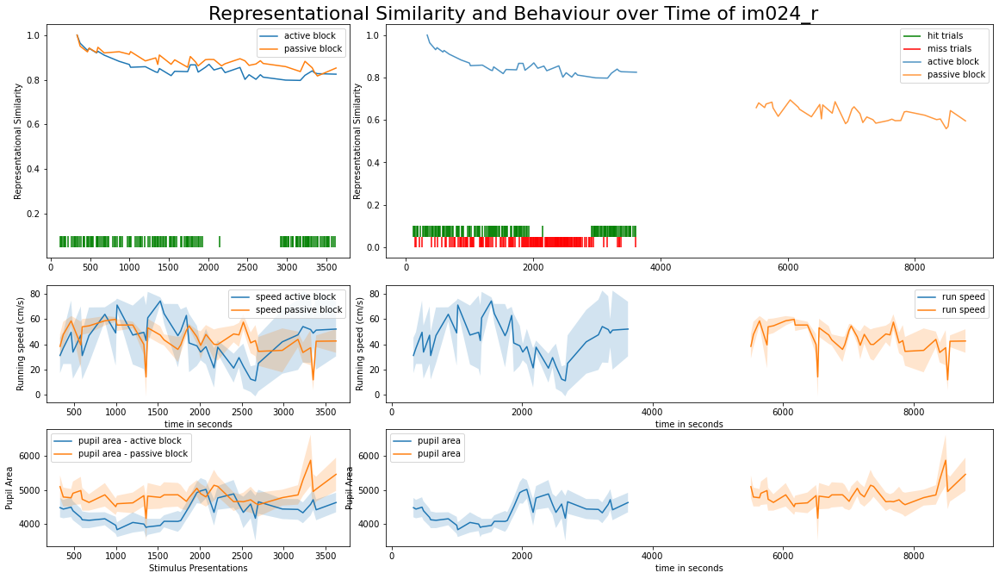

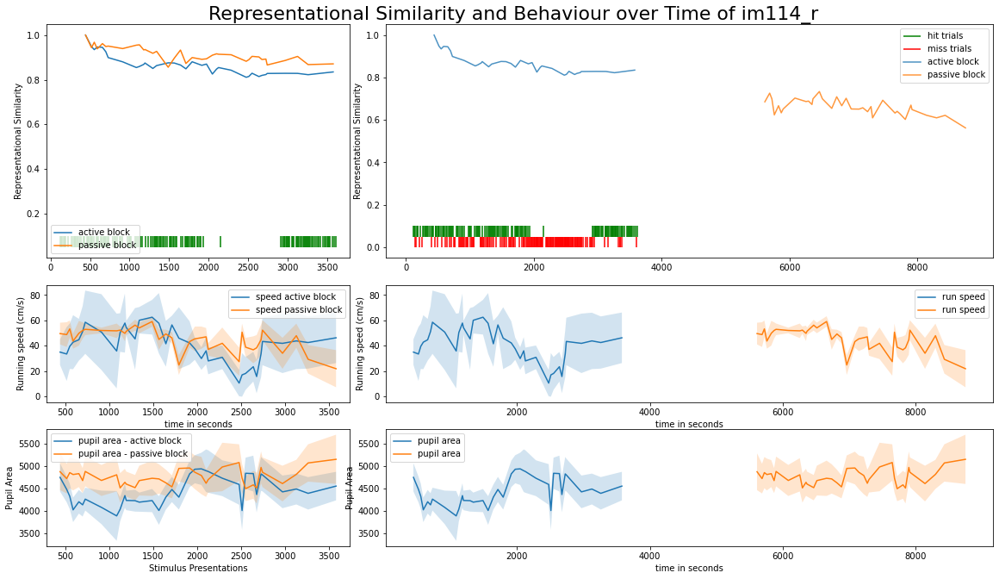

In [48]:
# print all images full information

for image in valid_images:
    specific_image(image, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, change_trials)

### 3.4 with z-scored behaviour

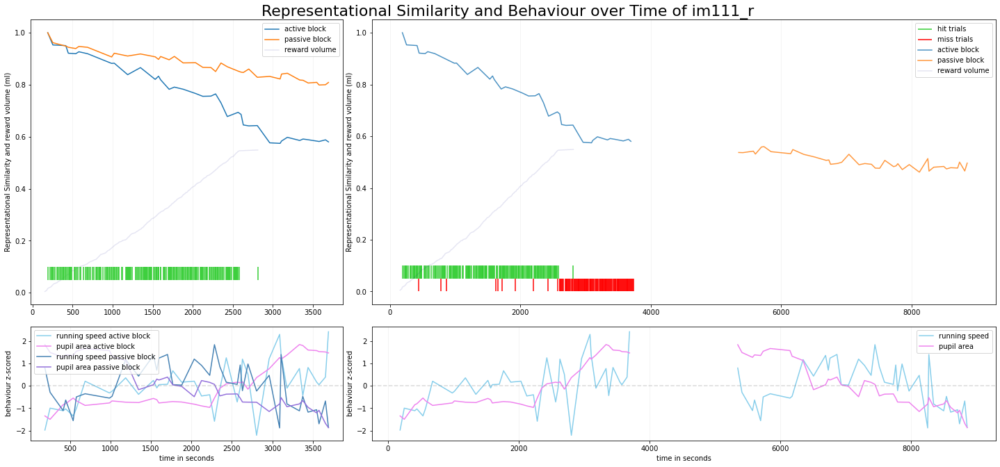

In [78]:
specific_image_z_scored_behaviour('im111_r', M_all_good, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


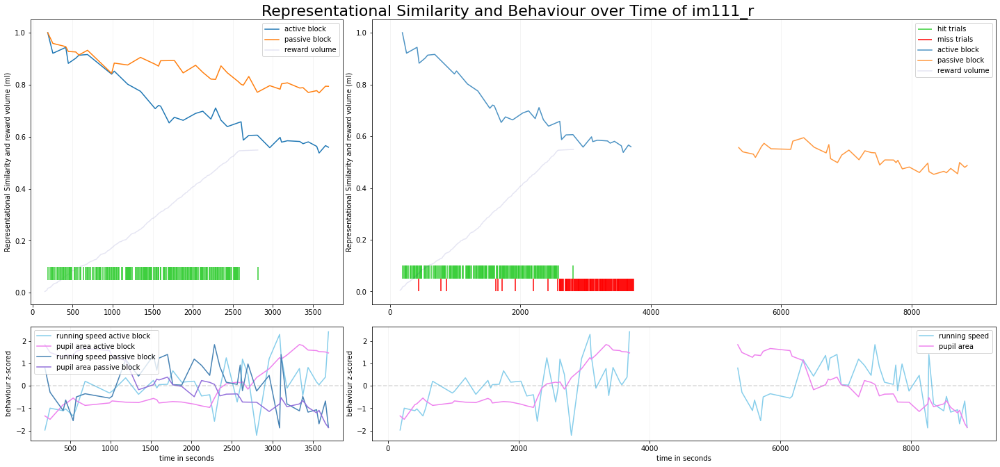

In [79]:
specific_image_z_scored_behaviour('im111_r', M_good_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


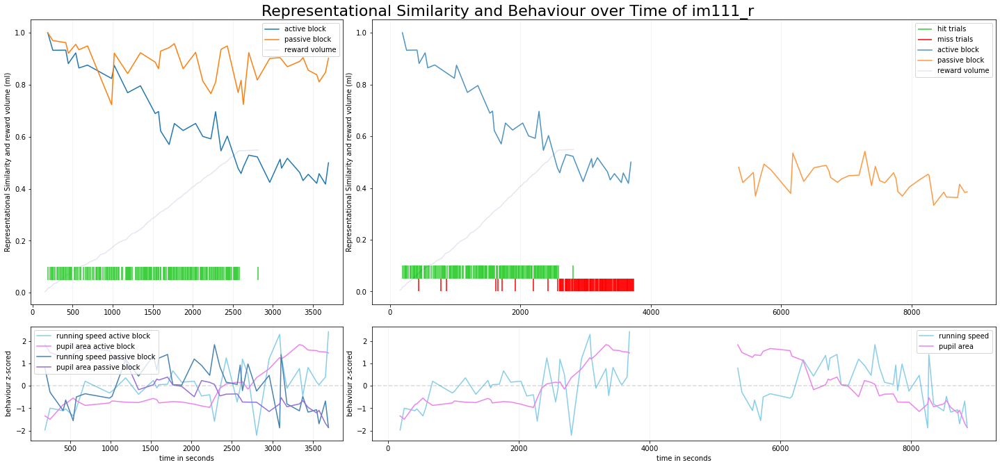

In [80]:
specific_image_z_scored_behaviour('im111_r', M_good_VISp, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


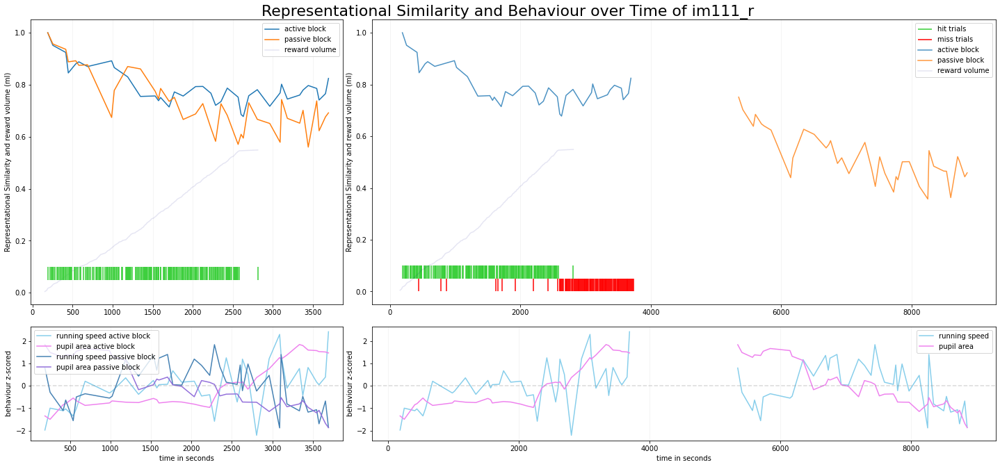

In [81]:
specific_image_z_scored_behaviour('im111_r', M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


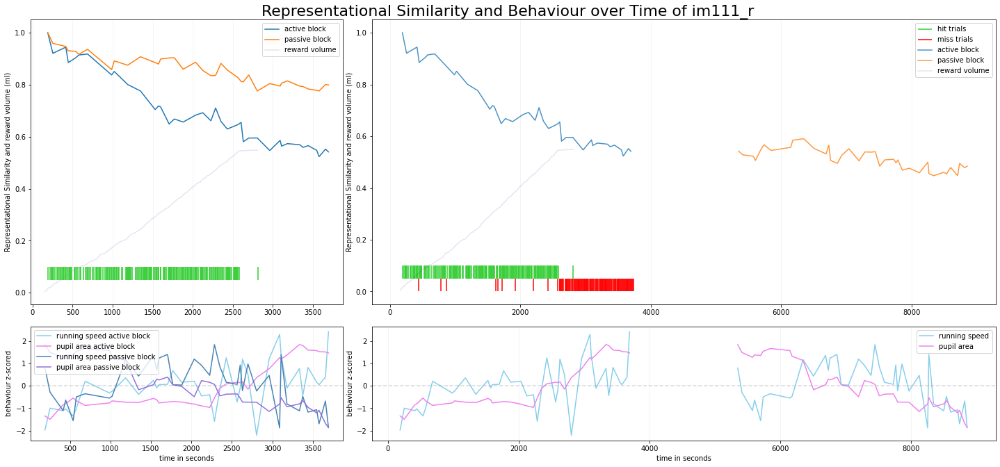

In [82]:
specific_image_z_scored_behaviour('im111_r', M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, change_trials, rewards)


#  4. Representational Similarity vs. Behavioural State Difference
difference in running speed and pupil size for specified image with and without chain-average

In [39]:
# specify image:
im = 'im111_r'

### 4.1 RS and Behaviour: Running Speed and Pupil Area 
fix picture in active/passive/both blocks

plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


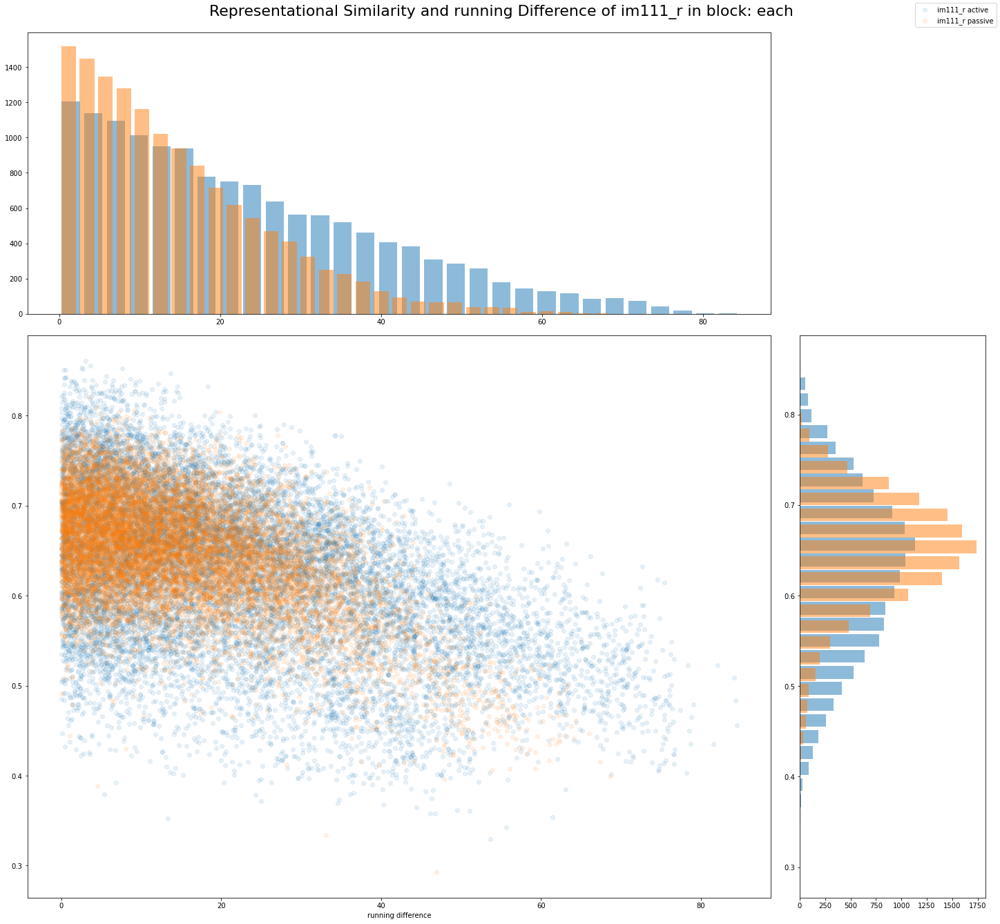

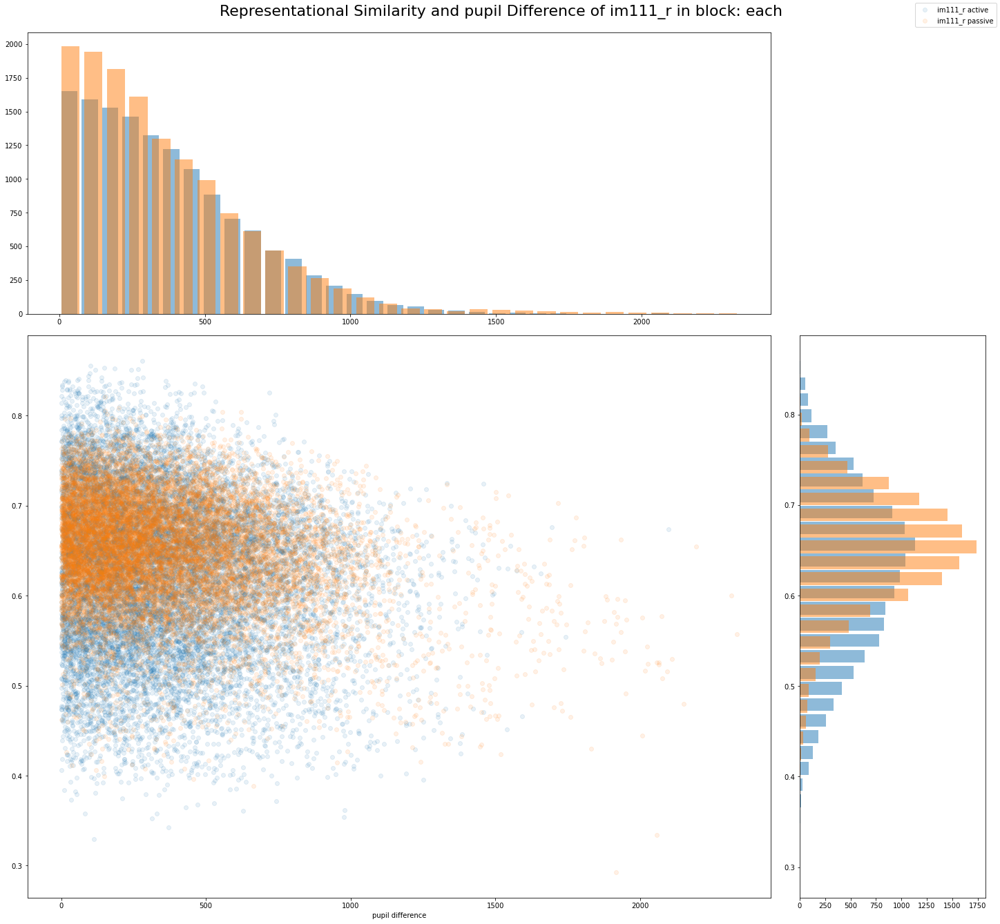

In [165]:
# all good units

RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_all_good, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


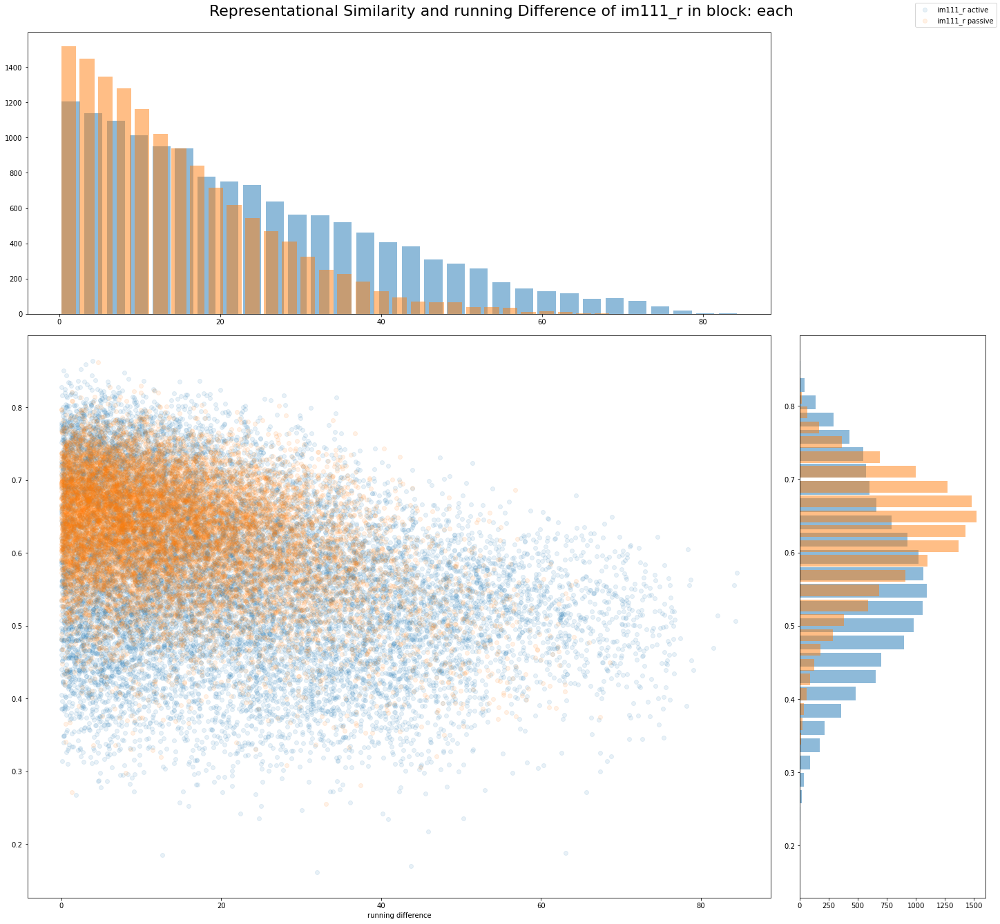

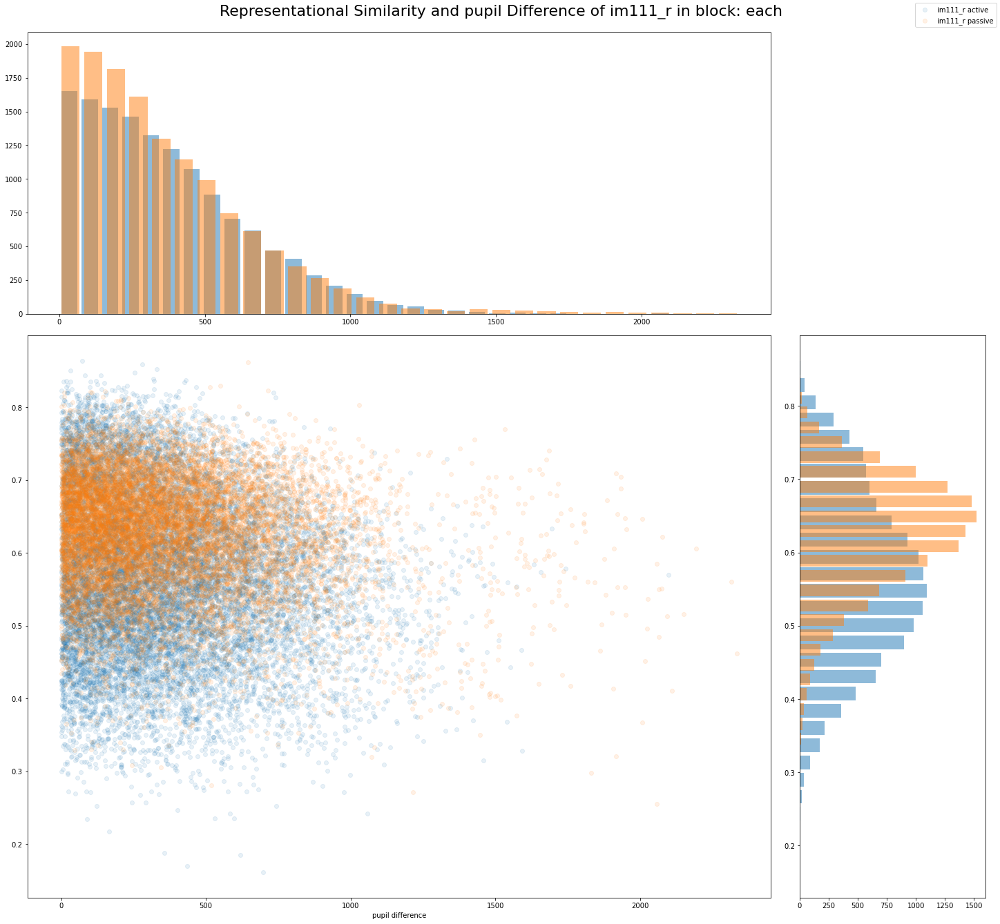

In [164]:
# good VIS


RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VIS, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')



plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


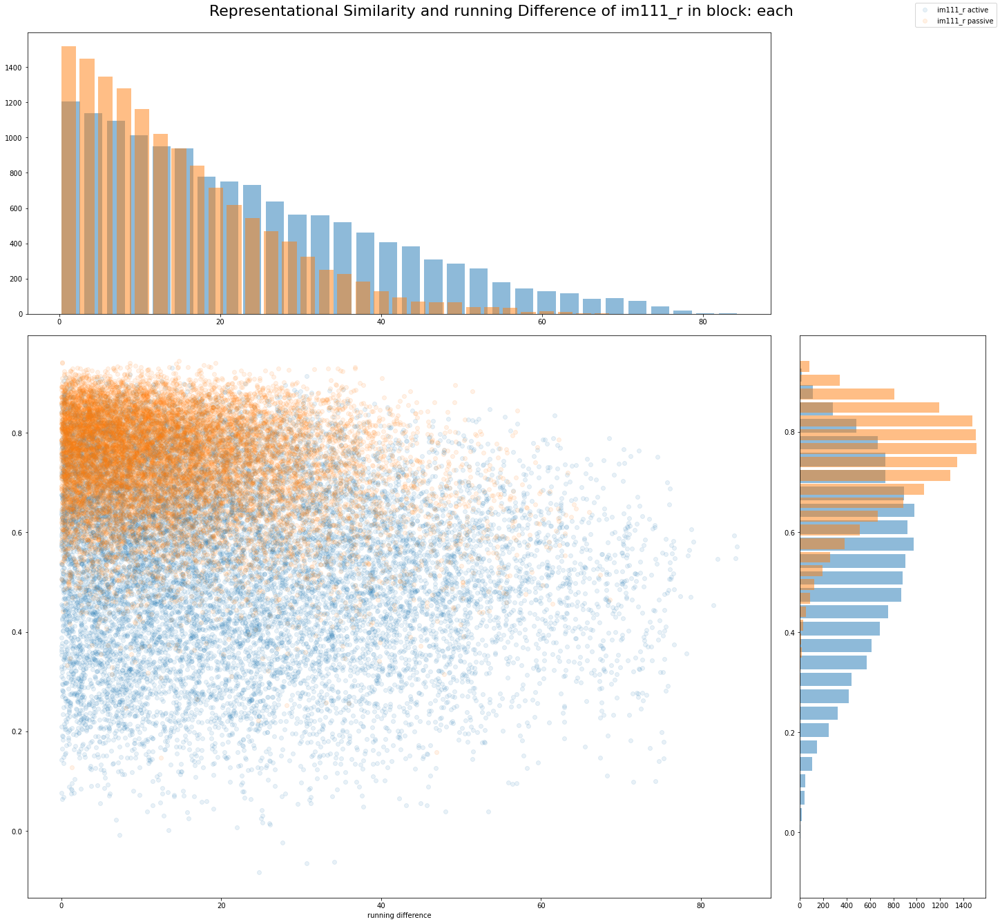

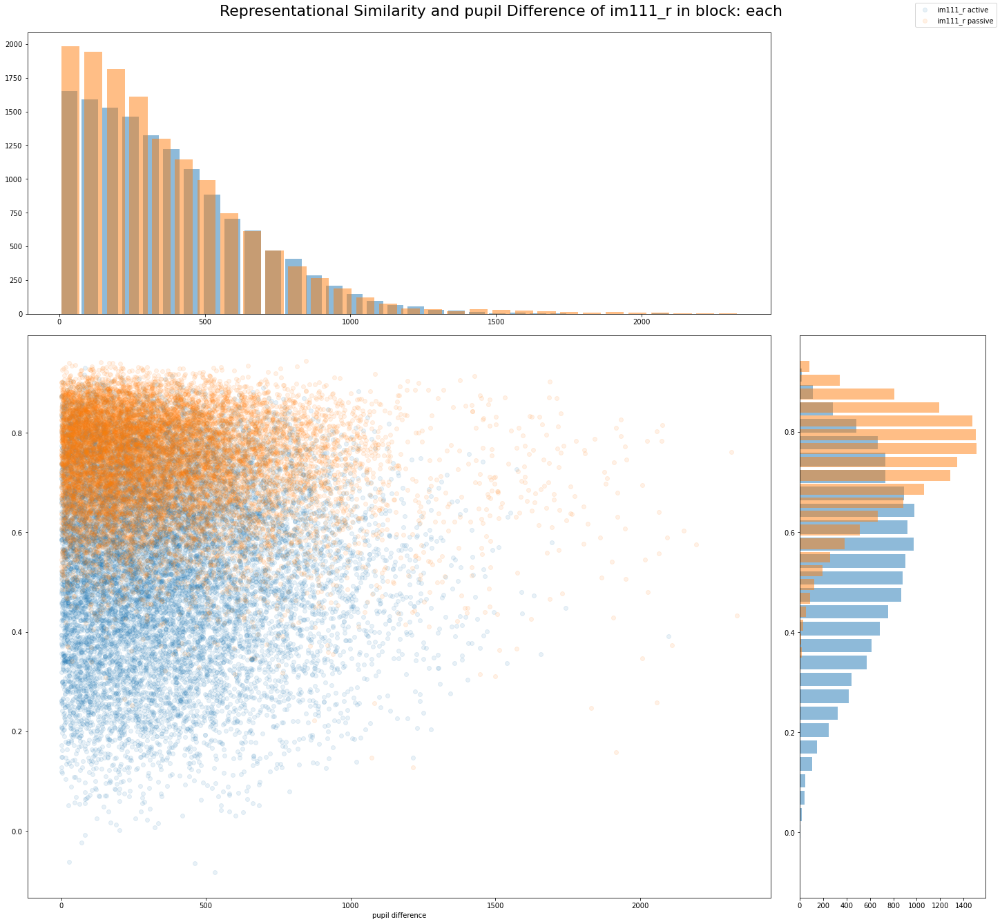

In [163]:
# good VISp

RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VISp, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861
plotting every 10-th datapoint
13861 13861


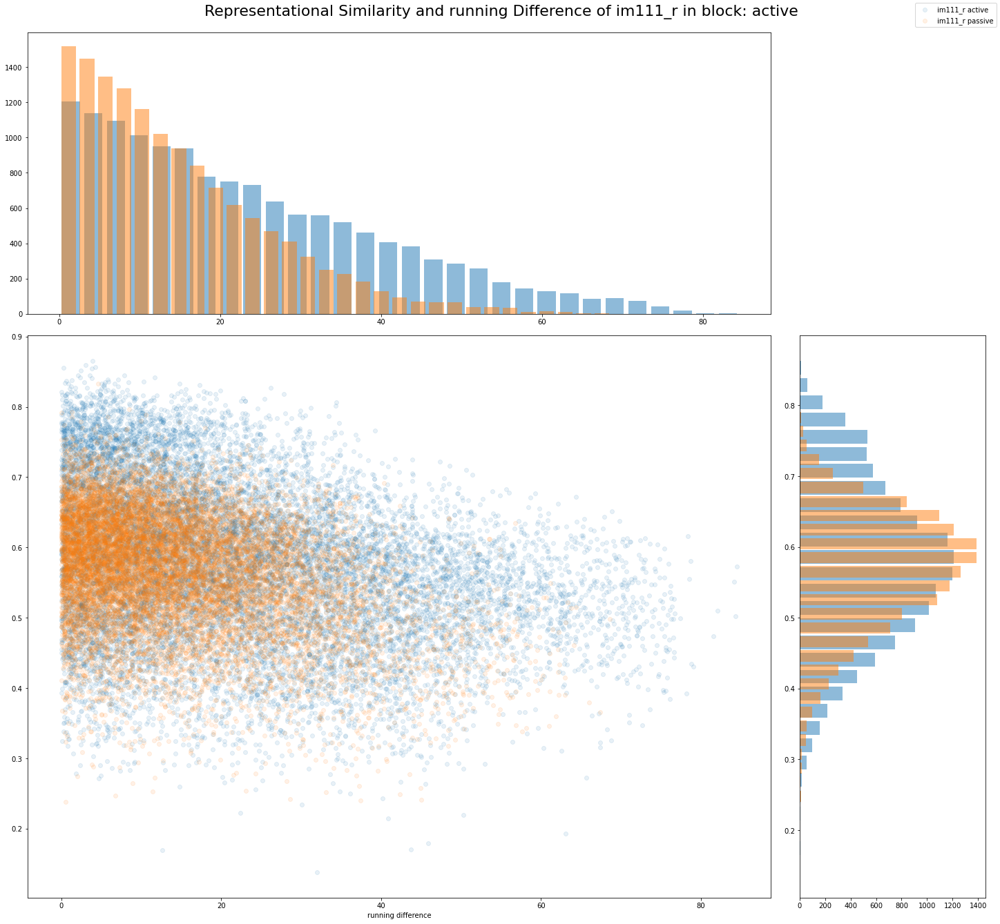

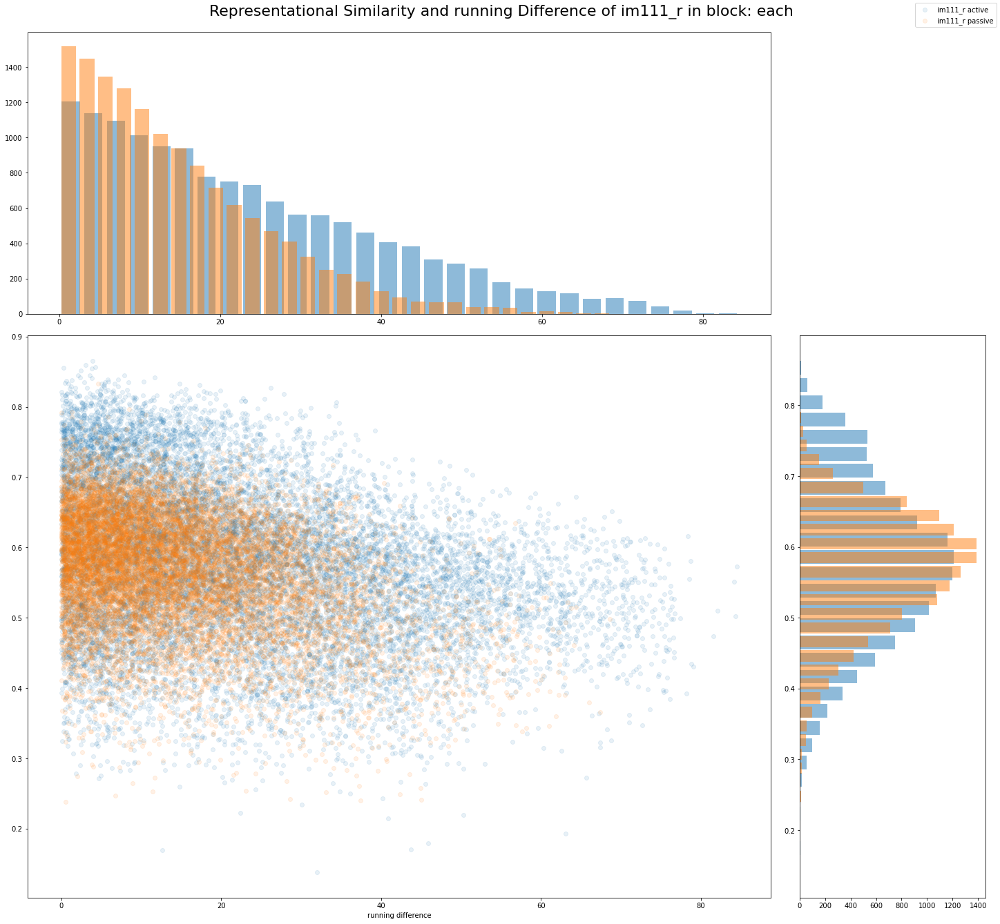

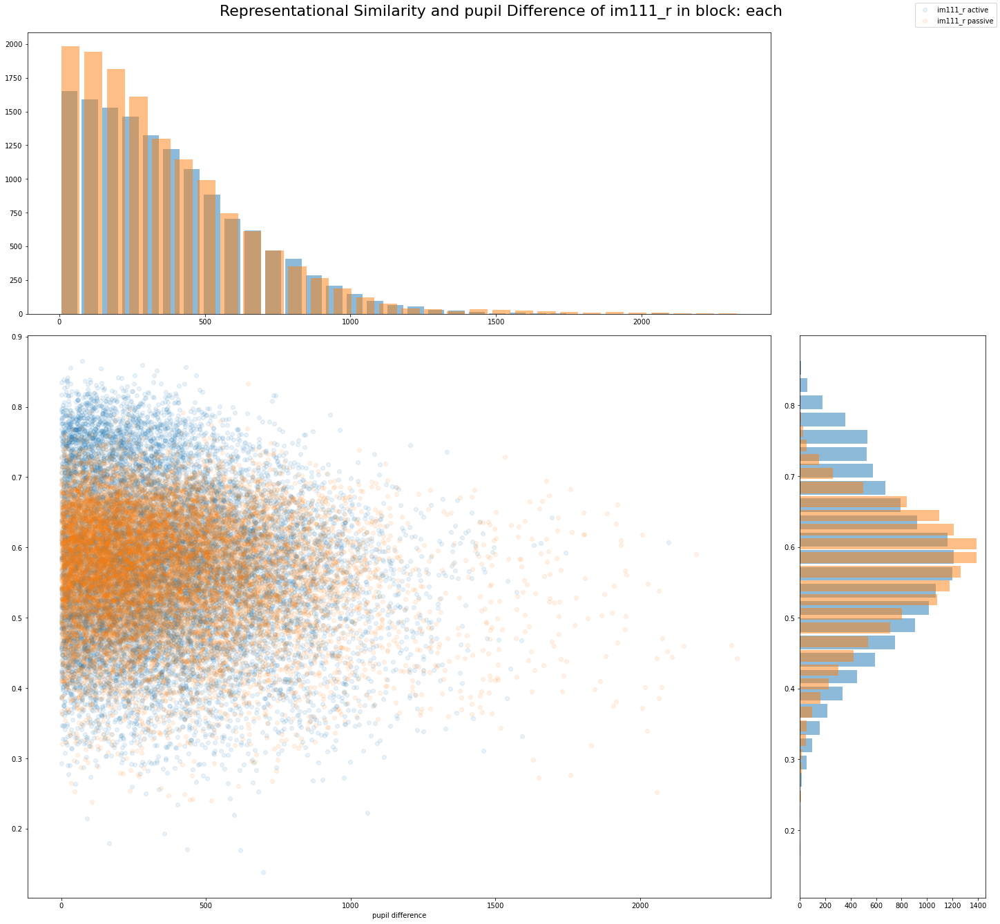

In [166]:
# good VIS without VISp

RS_vs_speed_active_passive(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking,'running', 'active')

RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')

RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# RS_behaviour_active_passive(im, 
#                             M_good_VIS_excld_VISp, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')


In [ ]:
# good CA1

# running speed
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='running', 
                            block='each')
# pupil area
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='pupil', 
                            block='each')

# z-scored behaviour
# RS_behaviour_active_passive(im, 
#                             M_good_CA1, 
#                             stimulus_presentations, 
#                             running_speed, 
#                             eye_tracking, 
#                             behaviour='z', 
#                             block='both')



### 4.2 RS vs. Behaviour but averaged over chains
fix picture in active/ passive block

###### all (good) units

im111_r
im111_r


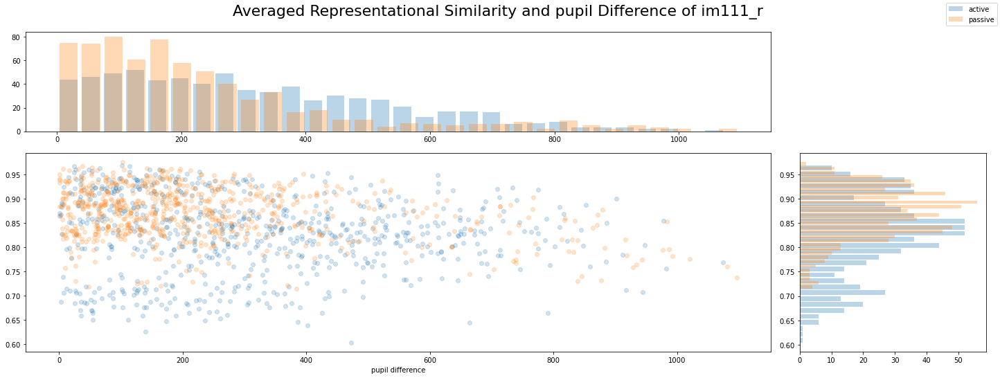

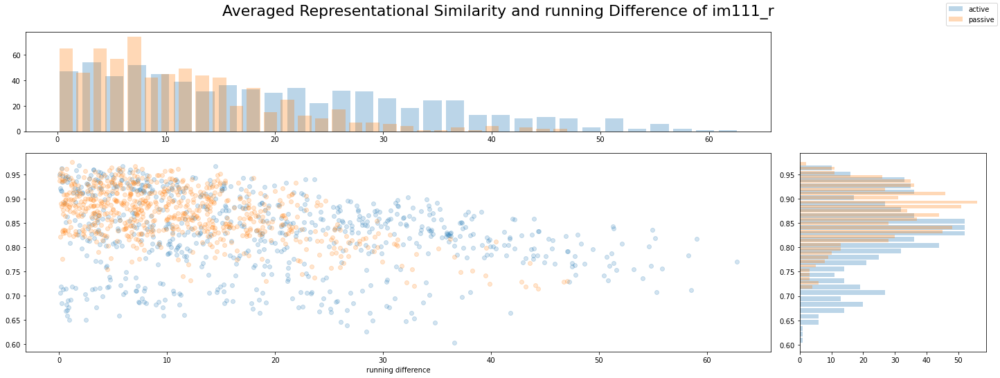

In [168]:
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS units

im111_r
im111_r


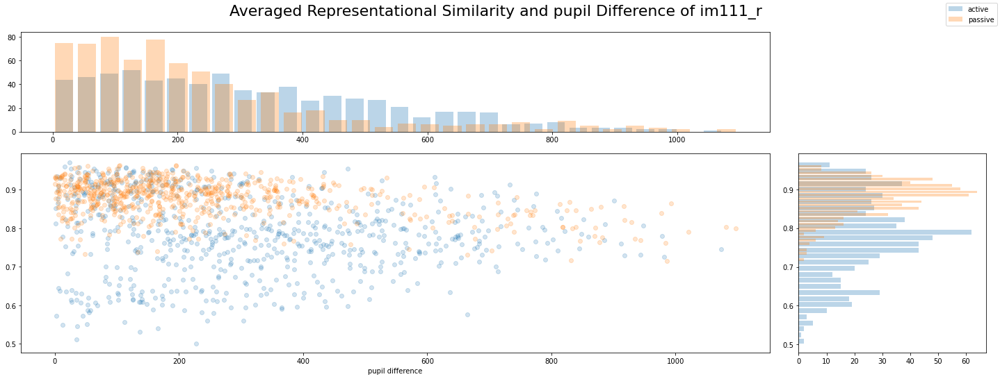

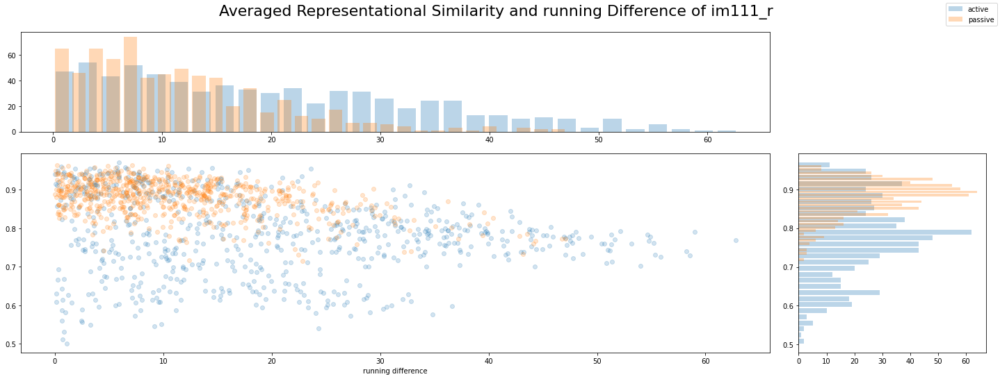

In [172]:
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VISp units

im111_r
im111_r


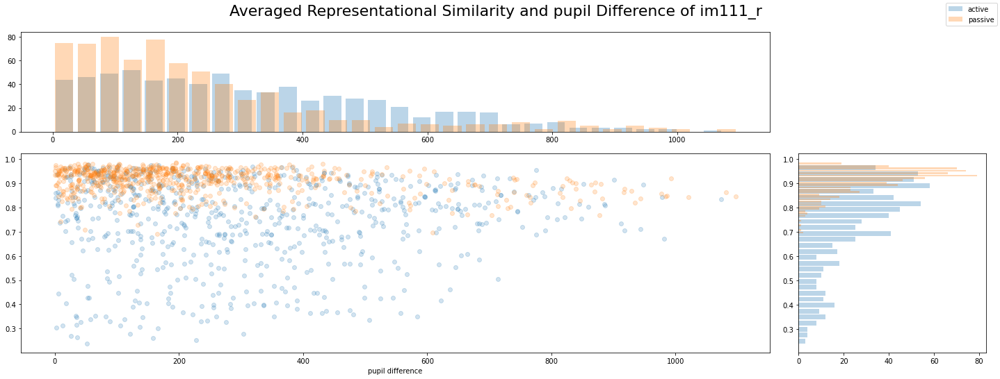

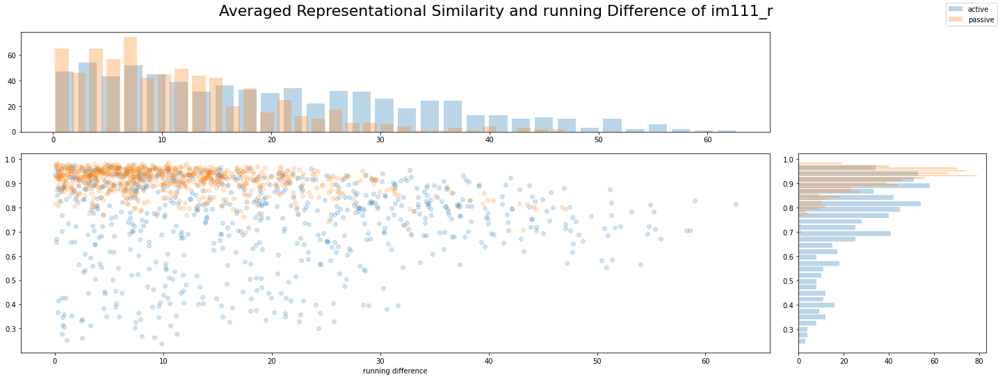

In [173]:
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS \ VISp units

im111_r
im111_r


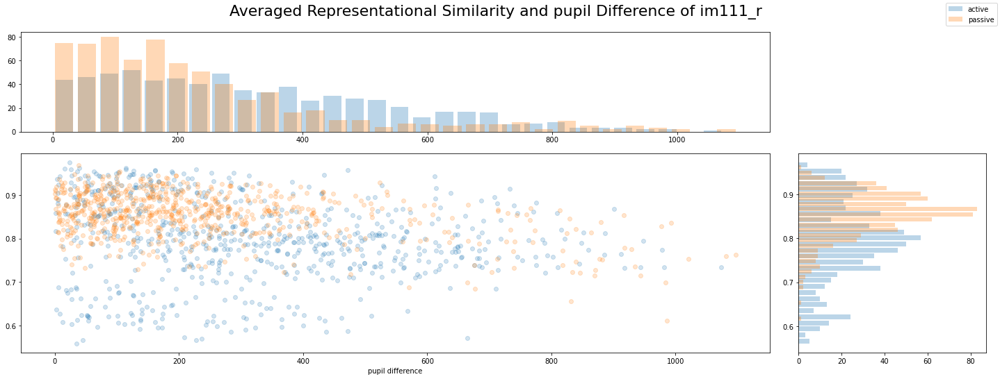

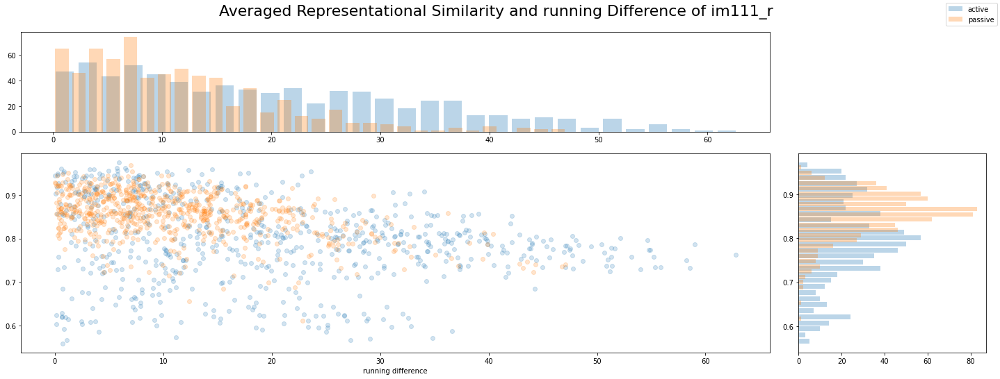

In [174]:
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good CA1 units

im111_r
im111_r


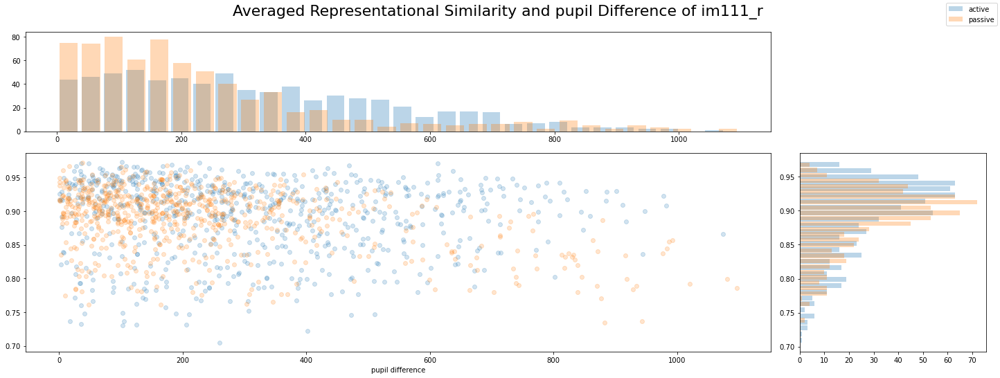

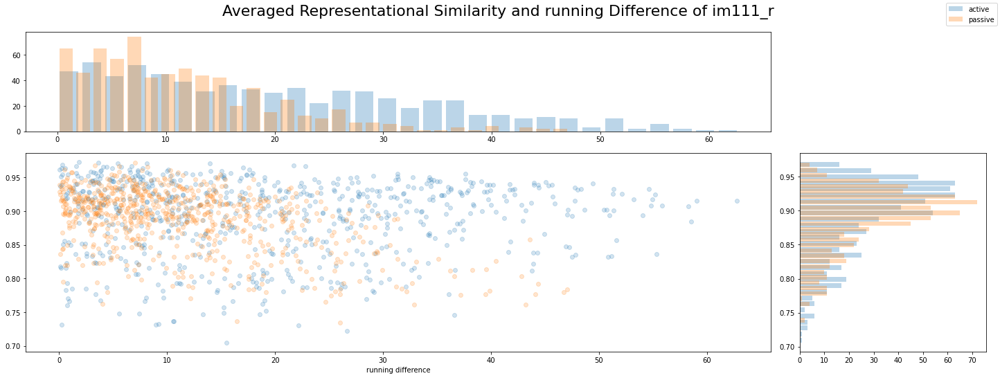

In [171]:
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good tagged VIS units

im111_r
im111_r


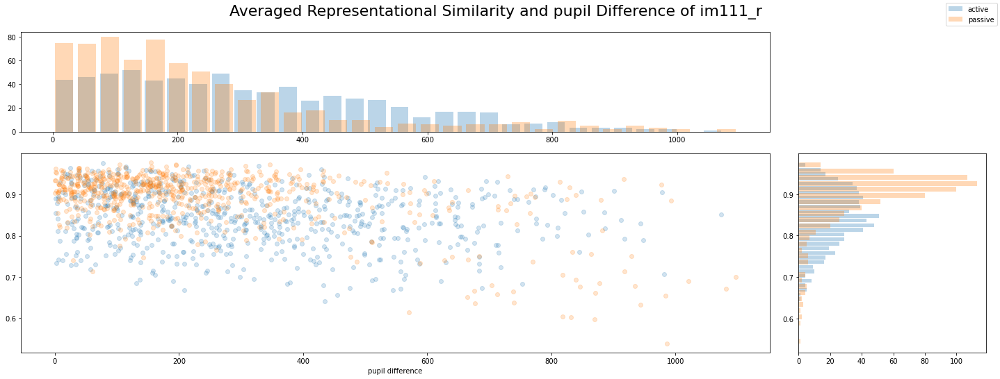

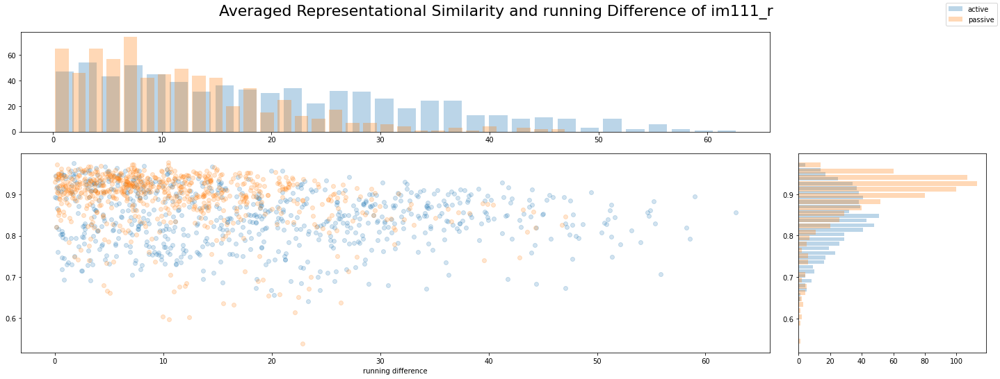

In [170]:
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'running')

###### good VIS \ tagged VIS units

im111_r
im111_r


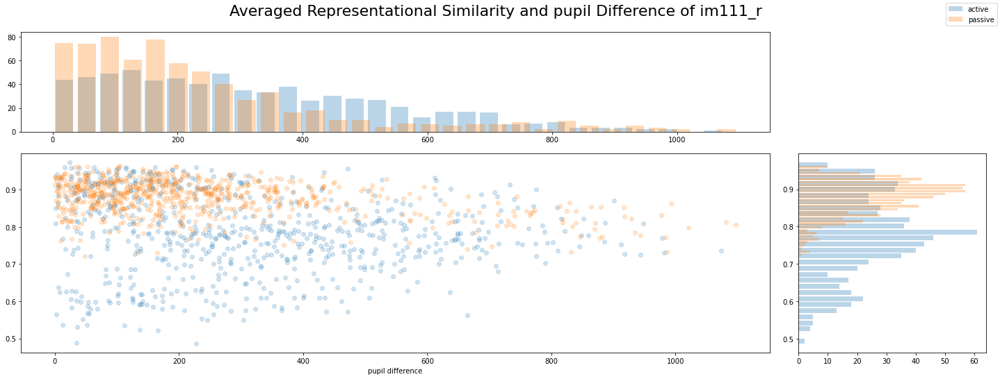

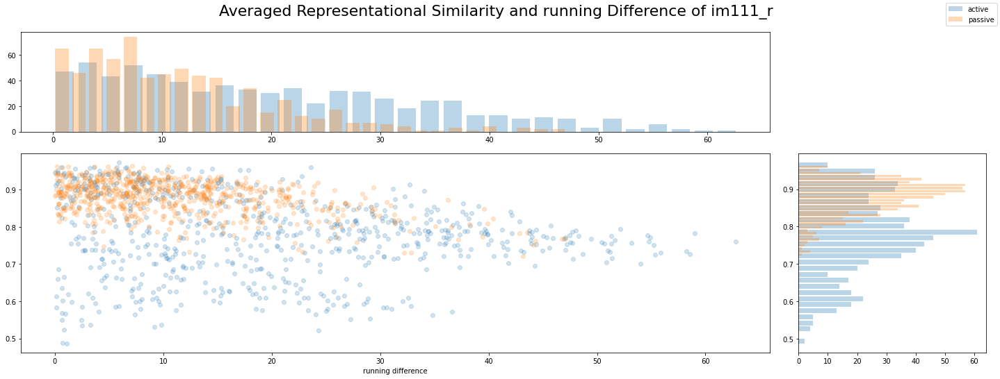

In [169]:
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'pupil')
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'running')

### 4.2 RS vs. z-scored behaviour
fix picture in active/ passive block

###### all (good) units

plotting every 10-th datapoint
13861 13861


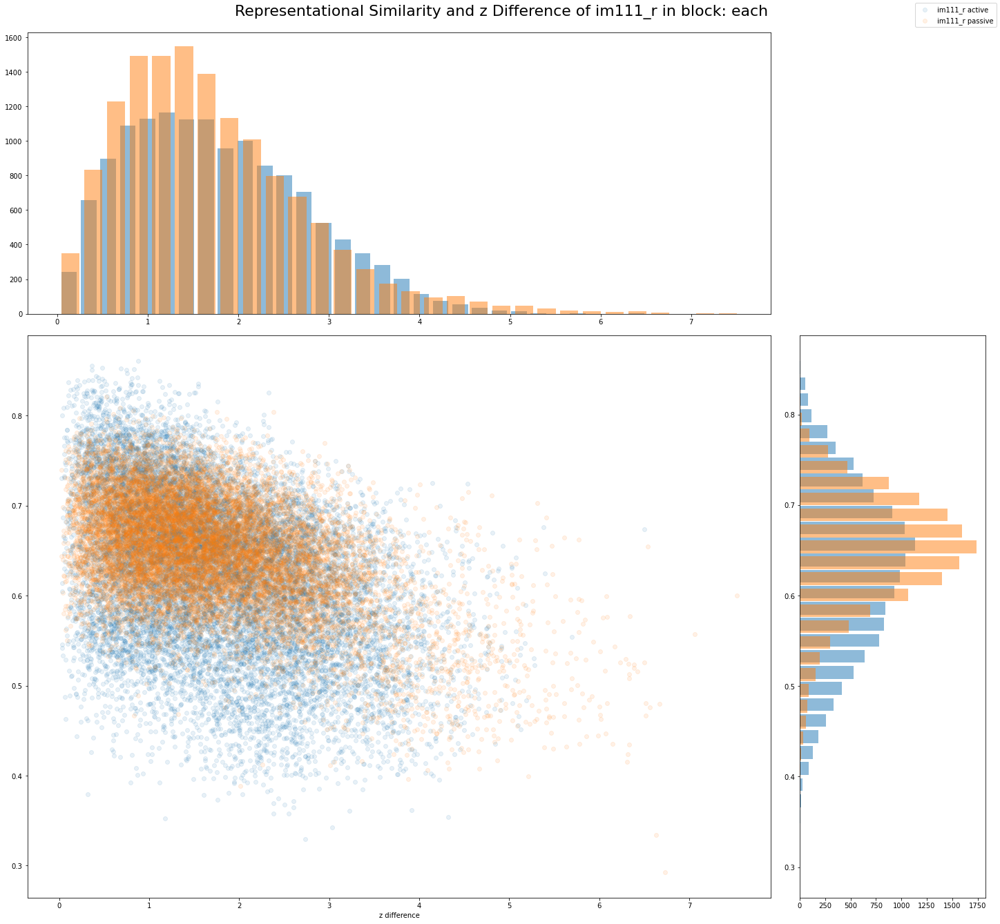

In [187]:
RS_behaviour_active_passive(im, 
                            M_all_good, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS units

plotting every 10-th datapoint
13861 13861


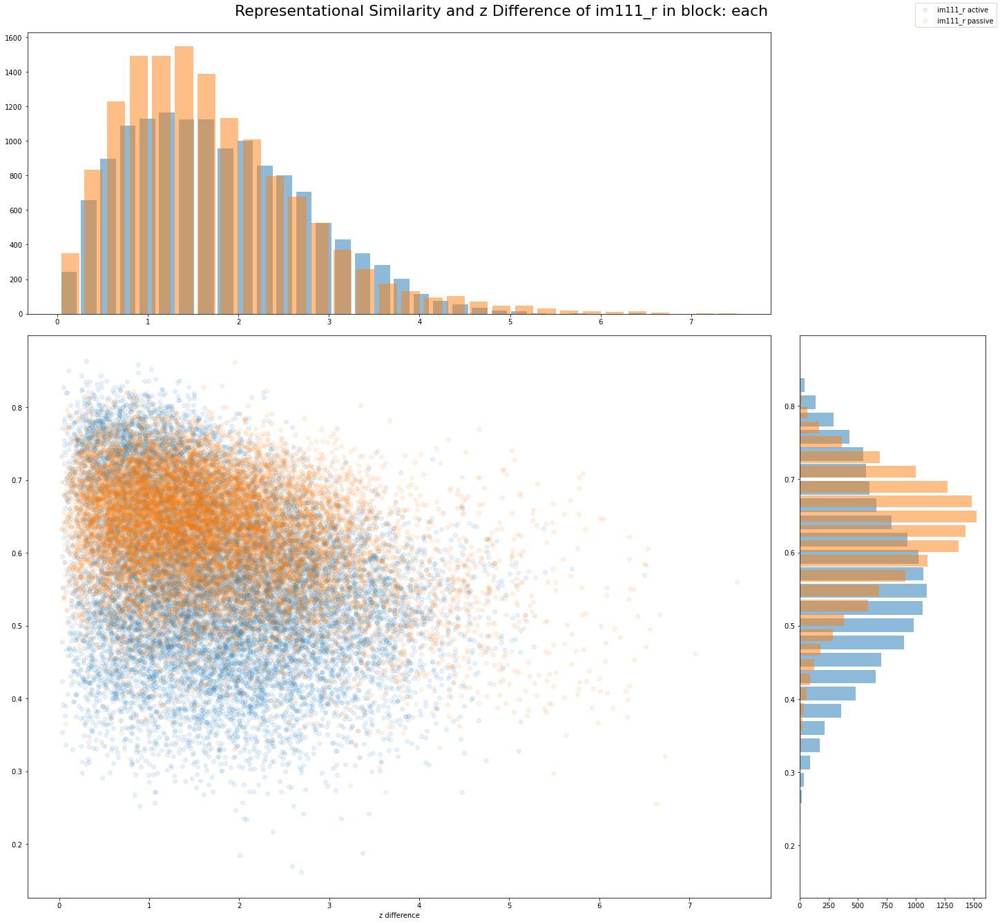

In [188]:
RS_behaviour_active_passive(im, 
                            M_good_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VISp units

plotting every 10-th datapoint
13861 13861


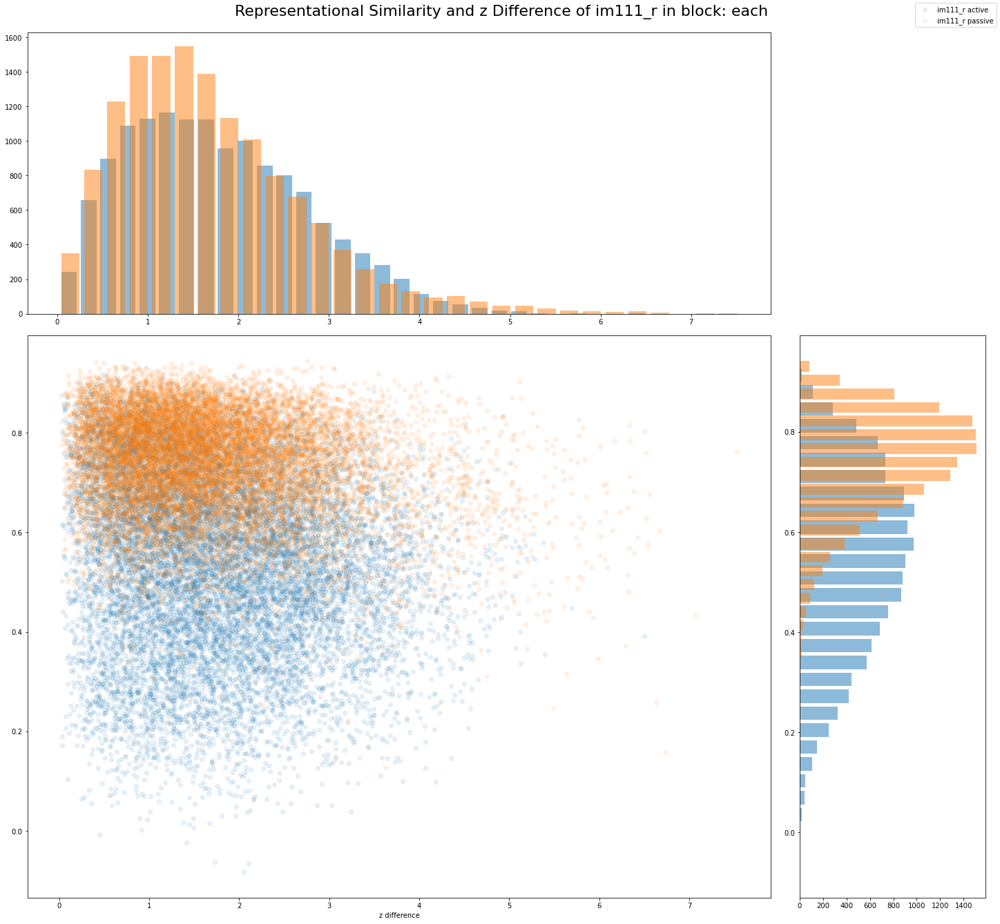

In [189]:
RS_behaviour_active_passive(im, 
                            M_good_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS \ VISp units

plotting every 10-th datapoint
13861 13861


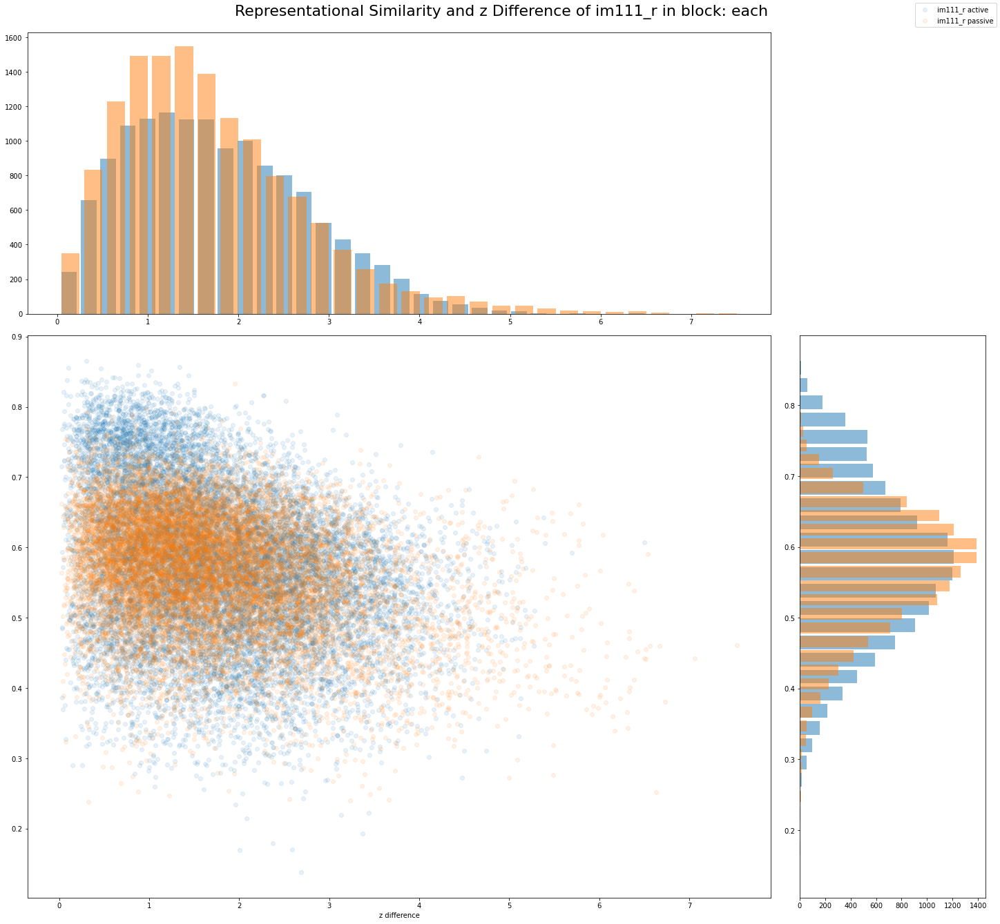

In [190]:
RS_behaviour_active_passive(im, 
                            M_good_VIS_excld_VISp, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good CA1 units

plotting every 10-th datapoint
13861 13861


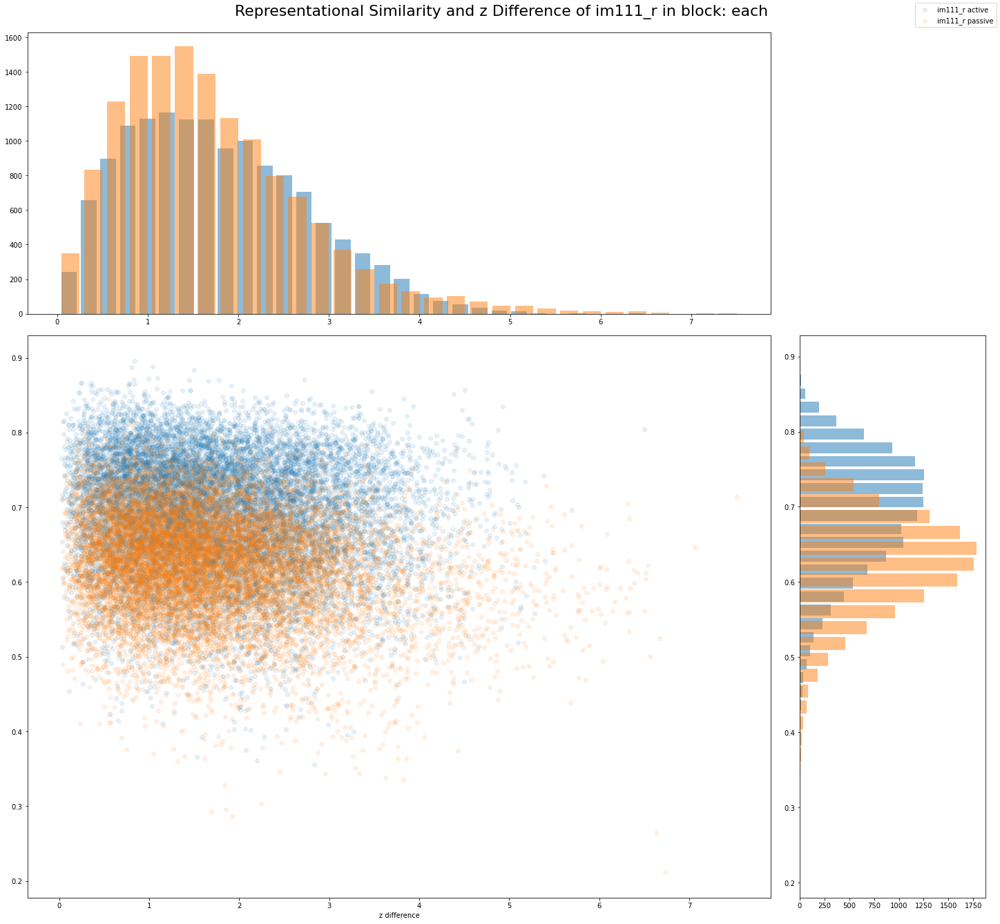

In [191]:
RS_behaviour_active_passive(im, 
                            M_good_CA1, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good tagged VIS units

plotting every 10-th datapoint
13861 13861


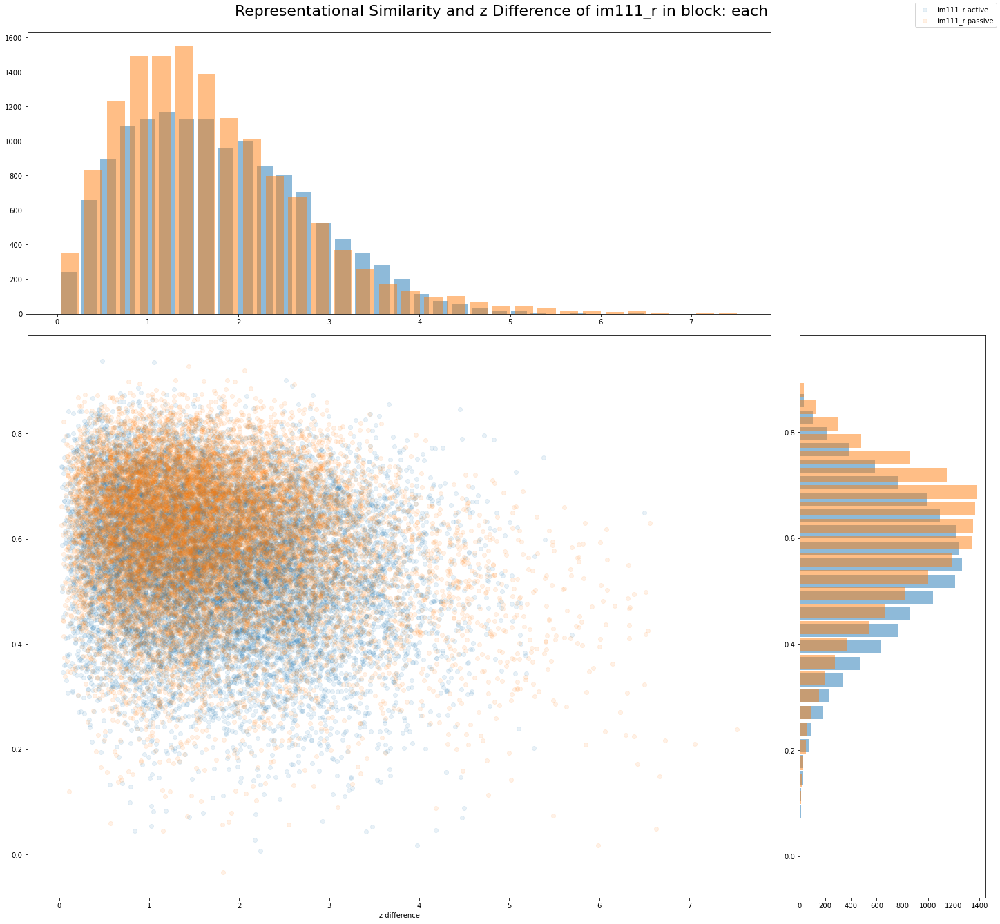

In [192]:
RS_behaviour_active_passive(im, 
                            M_marked_VIS, 
                            stimulus_presentations, 
                            running_speed, 
                            eye_tracking, 
                            behaviour='z', 
                            block='each')

###### good VIS \ tagged VIS units

plotting every 10-th datapoint
13861 13861


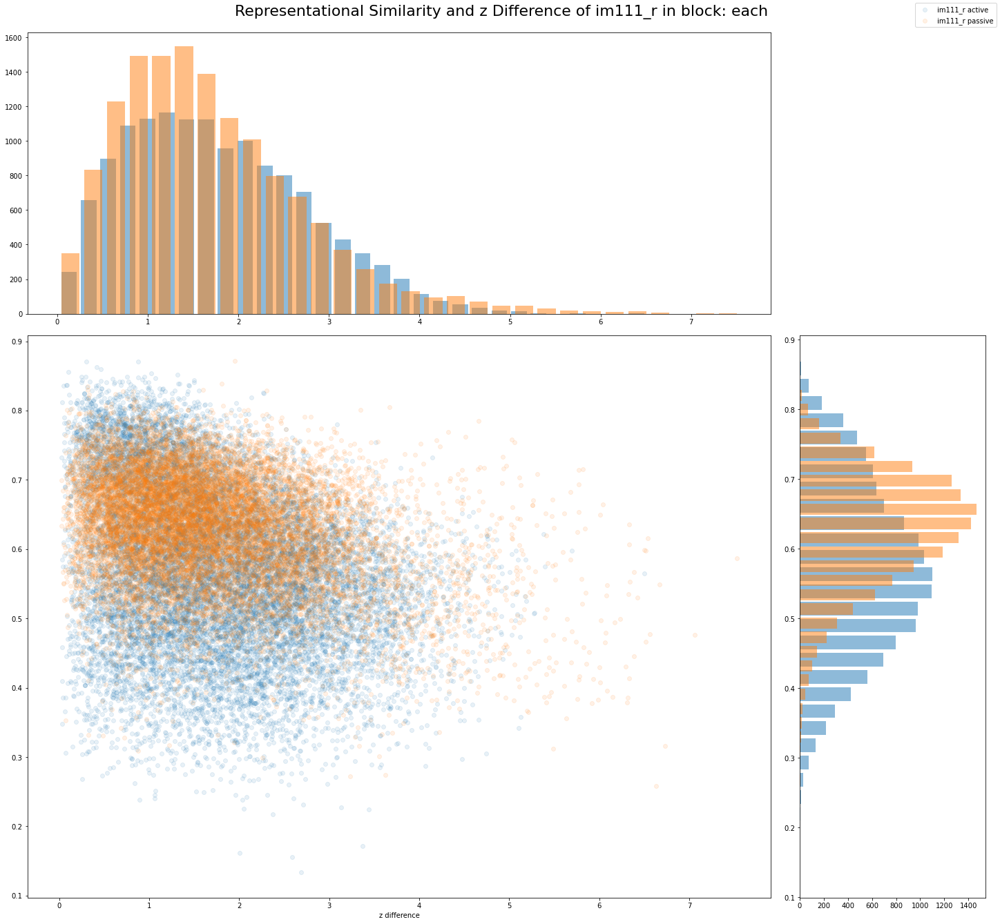

In [193]:
RS_behaviour_active_passive(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, behaviour='z', block='each')


### 4.2 RS vs. z-scored behaviour but averaged over chains
fix picture in active/ passive block

###### all (good) units

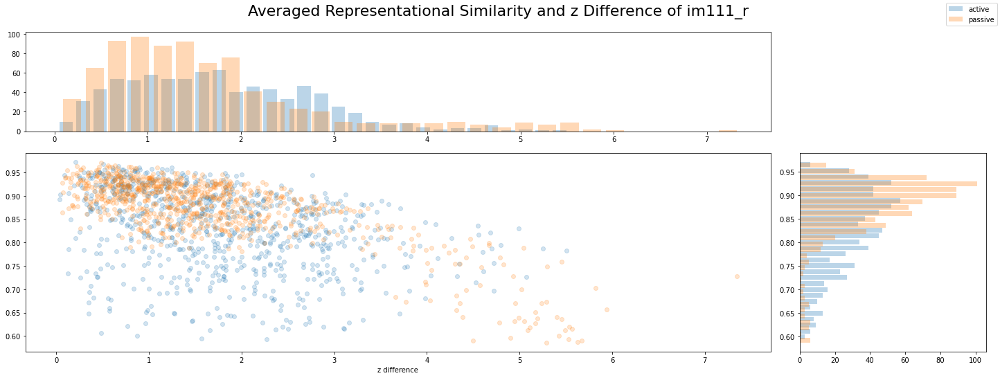

In [40]:
RS_behaviour_avg(im, M_all_good, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good VIS units

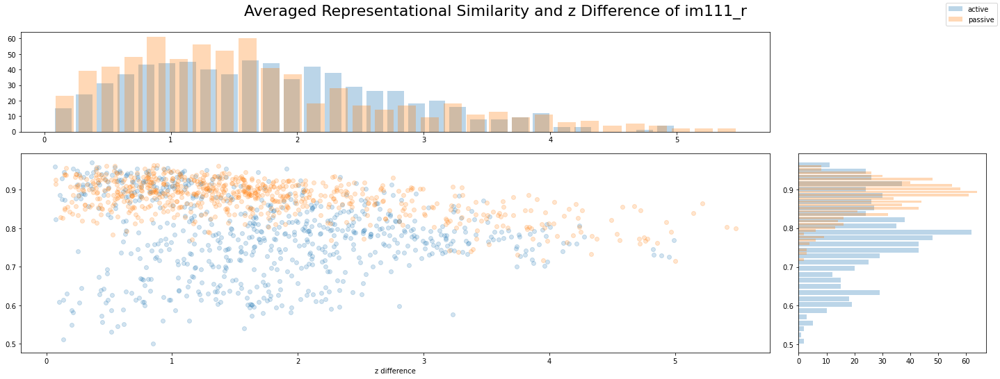

In [184]:
RS_behaviour_avg(im, M_good_VIS, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good VISp units

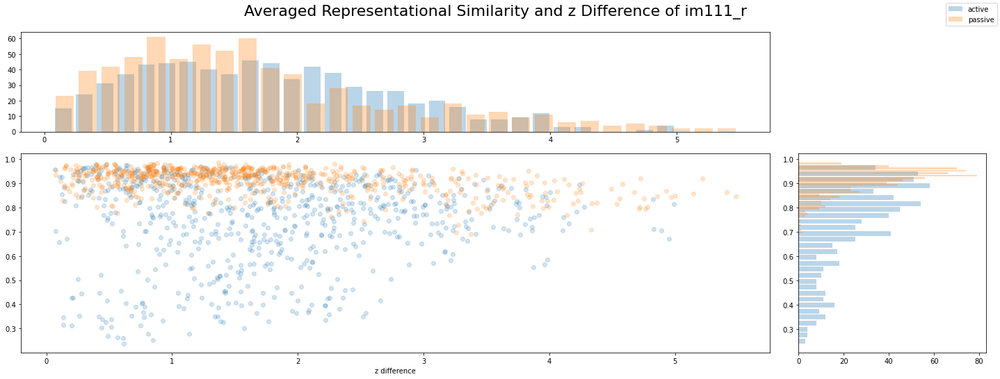

In [183]:
RS_behaviour_avg(im, M_good_VISp, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good VIS \ VISp units

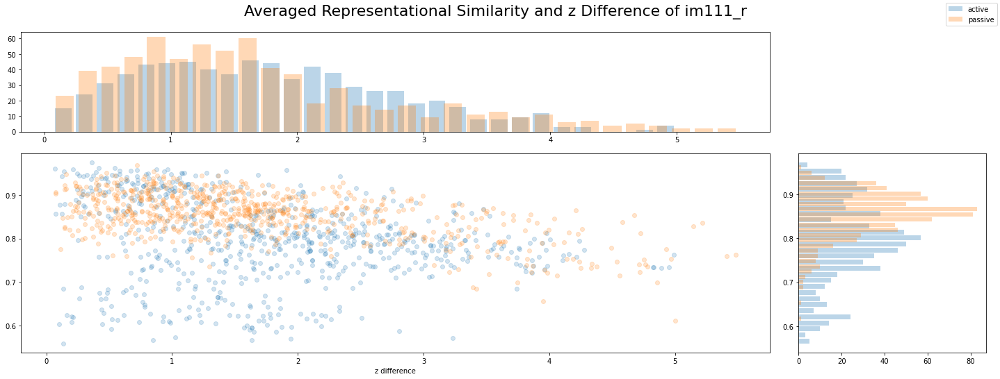

In [182]:
RS_behaviour_avg(im, M_good_VIS_excld_VISp, stimulus_presentations, running_speed, eye_tracking, 'z')

###### good CA1 units

im111_r


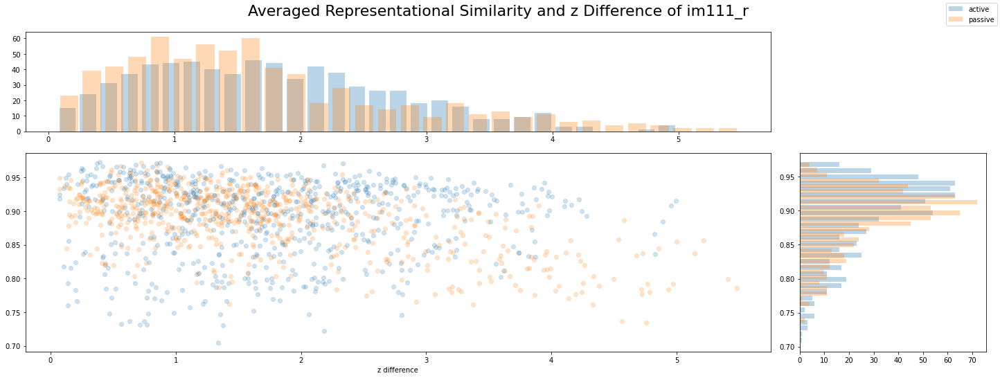

In [180]:
RS_behaviour_avg(im, M_good_CA1, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good tagged VIS units

im111_r


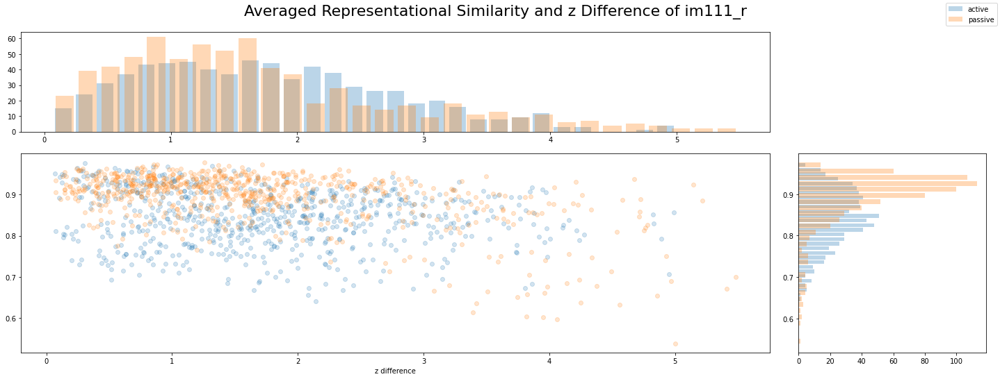

In [179]:
RS_behaviour_avg(im, M_marked_VIS, stimulus_presentations, running_speed, eye_tracking, 'z')


###### good VIS \ tagged VIS units

im111_r


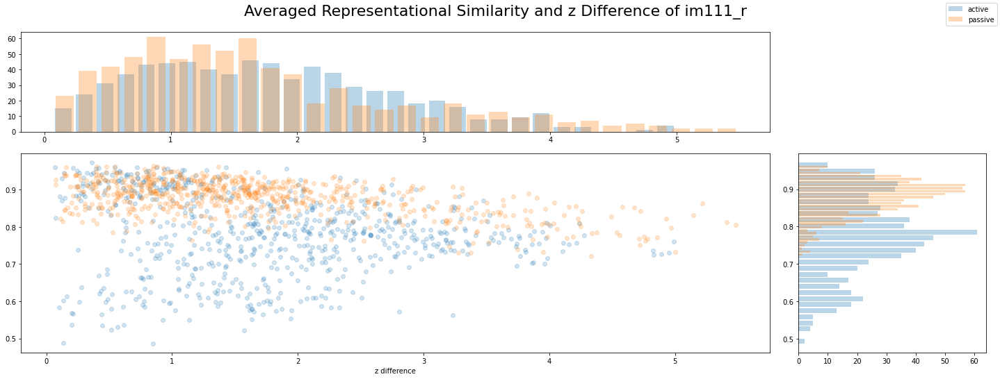

In [178]:
RS_behaviour_avg(im, M_VIS_no_tag, stimulus_presentations, running_speed, eye_tracking, 'z')

#  5. Representational Similarity vs. Time Difference
averaged over image chains for specified image

In [41]:
# specify image:
im = 'im111_r'

### 5.1 within blocks active/passive

plotting every 10-th datapoint


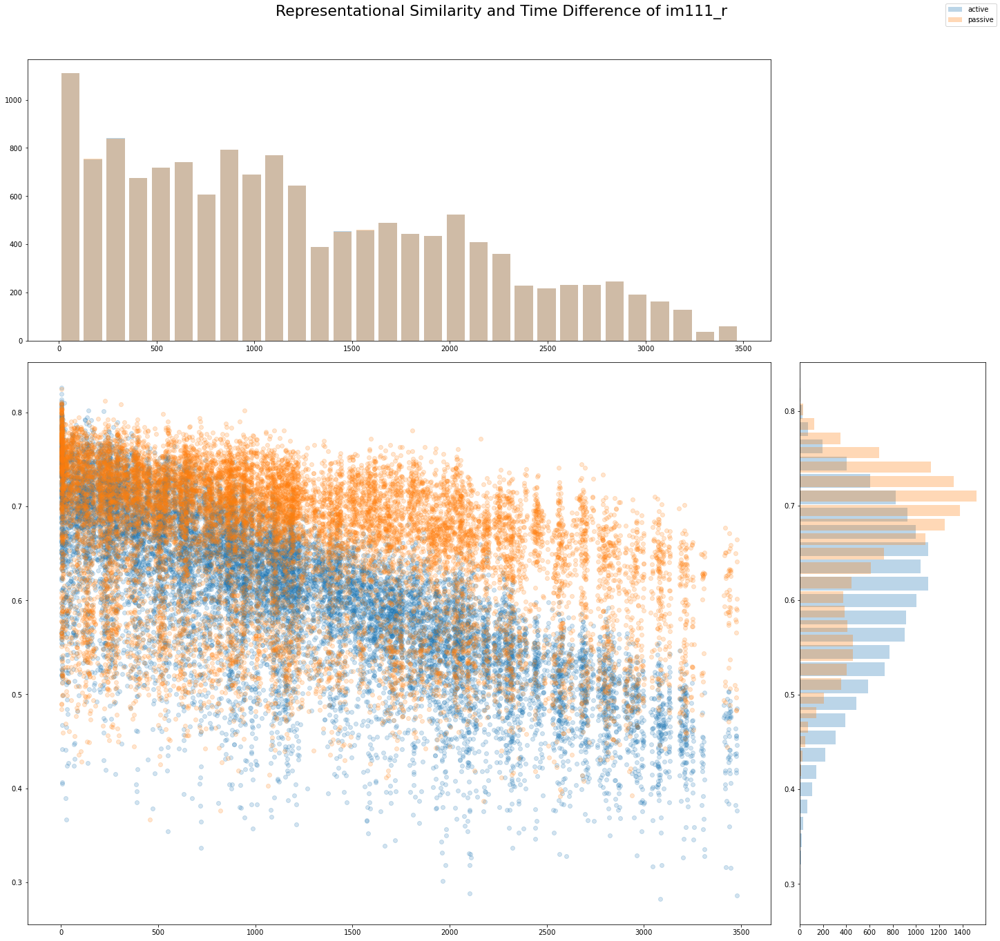

In [42]:
RS_vs_time_active_passive_within_blocks(im, M_all_good, stimulus_presentations)

plotting every 10-th datapoint


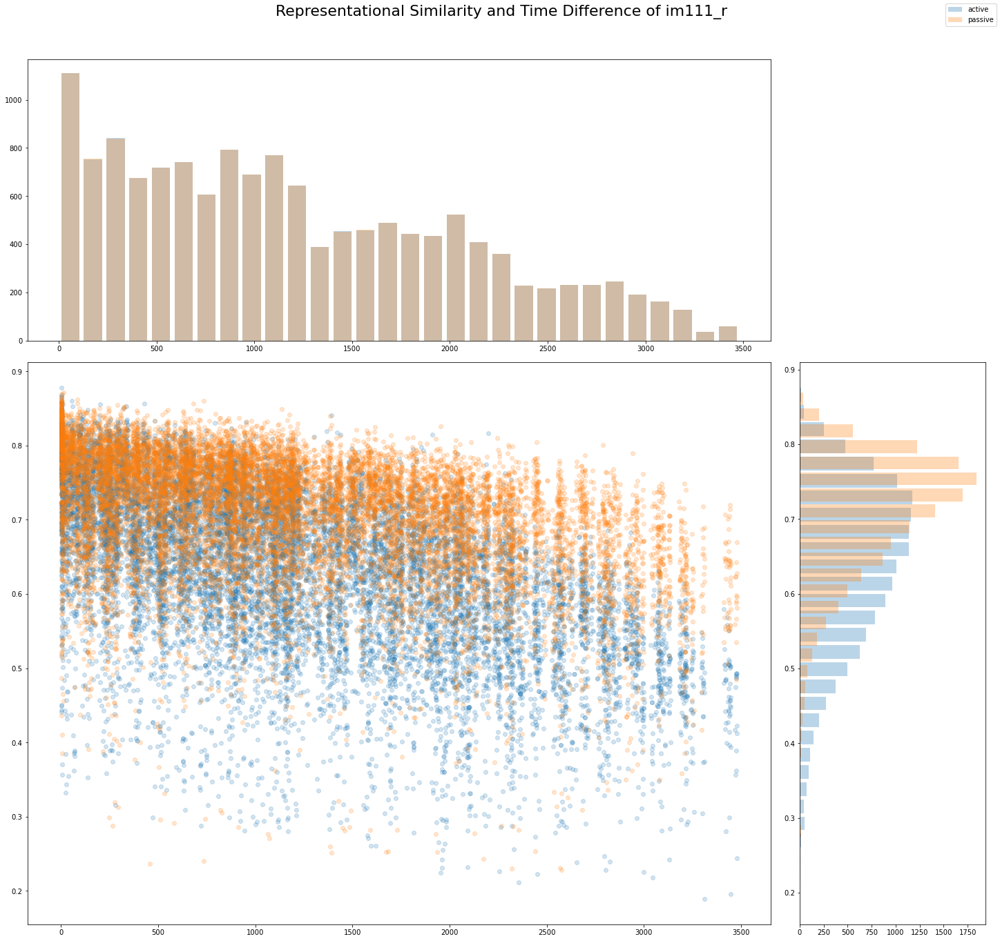

In [43]:
RS_vs_time_active_passive_within_blocks(im, M_good_VIS, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_VIS_excld_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_active_passive_within_blocks(im, M_good_CA1, stimulus_presentations)

### 5.2 averaged over chains

im111_r


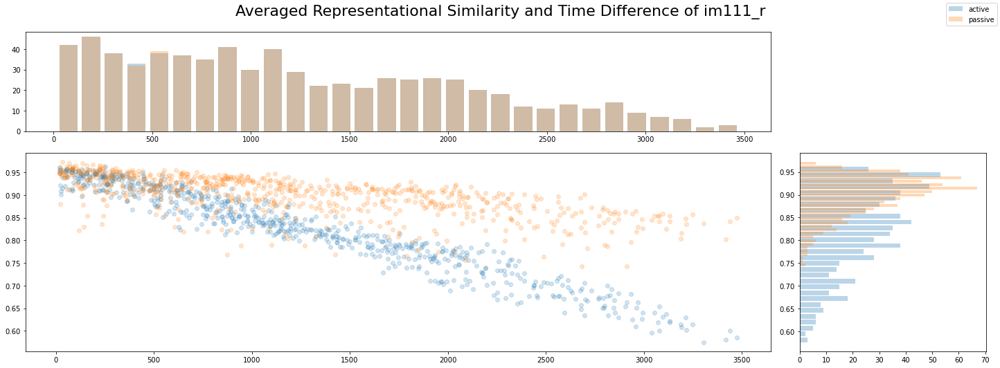

In [44]:
RS_vs_time_avg_active_passive(im, M_all_good, stimulus_presentations)

im111_r


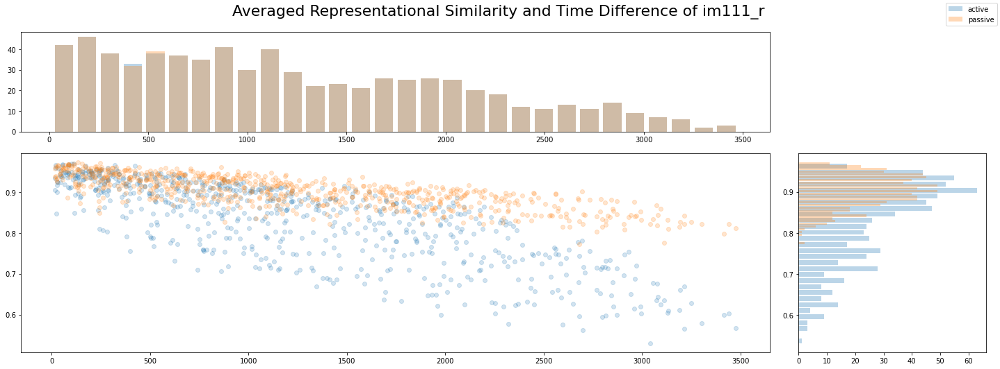

In [45]:
RS_vs_time_avg_active_passive(im, M_good_VIS, stimulus_presentations)

im111_r


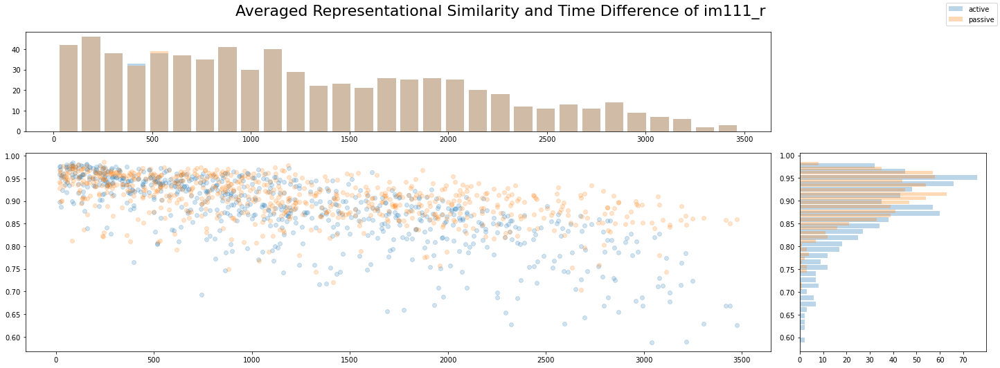

In [46]:
RS_vs_time_avg_active_passive(im, M_good_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_avg_active_passive(im, M_good_VIS_excld_VISp, stimulus_presentations)

In [ ]:
RS_vs_time_avg_active_passive(im, M_good_CA1, stimulus_presentations)

#  6. Tuning Curves
mean spike counts of a unit for each image

### time dependent

In [71]:
curr_M = M_good_VISp
n_units = curr_M.shape[0]

print('_______ active ________')
all_tunings_a = get_all_tunings(curr_M, valid_images, stimulus_presentations, block=0)

print('_______ passive ________')
all_tunings_p = get_all_tunings(curr_M, valid_images, stimulus_presentations, block=5)

assert all_tunings_a.shape == all_tunings_p.shape

_______ active ________
get tuning for 
0 :  im036_r
slice 0  :  37
slice 37  :  83
slice 83  :  138
slice 138  :  183
slice 183  :  219
slice 219  :  278
slice 278  :  333
slice 333  :  365
slice 365  :  412
slice 412  :  515
slice 515  :  541
slice 541  :  619
++++++++++++++++++++++++++++++++
get tuning for 
1 :  im083_r
slice 12  :  0
oh oh
12 | should be < than | 0 
 we are setting mean_spike_cnt to 0
slice 0  :  59
slice 59  :  94
slice 94  :  129
slice 129  :  188
slice 188  :  233
slice 233  :  273
slice 273  :  308
slice 308  :  356
slice 356  :  397
slice 397  :  442
slice 442  :  504
slice 504  :  550
++++++++++++++++++++++++++++++++
get tuning for 
2 :  im111_r
slice 28  :  0
oh oh
28 | should be < than | 0 
 we are setting mean_spike_cnt to 0
slice 0  :  55
slice 55  :  99
slice 99  :  141
slice 141  :  183
slice 183  :  238
slice 238  :  273
slice 273  :  305
slice 305  :  375
slice 375  :  443
slice 443  :  453
slice 453  :  541
slice 541  :  563
+++++++++++++++++++++++++

#### mean activity over time for each unit (fixed image) -possibly unnecessary view?

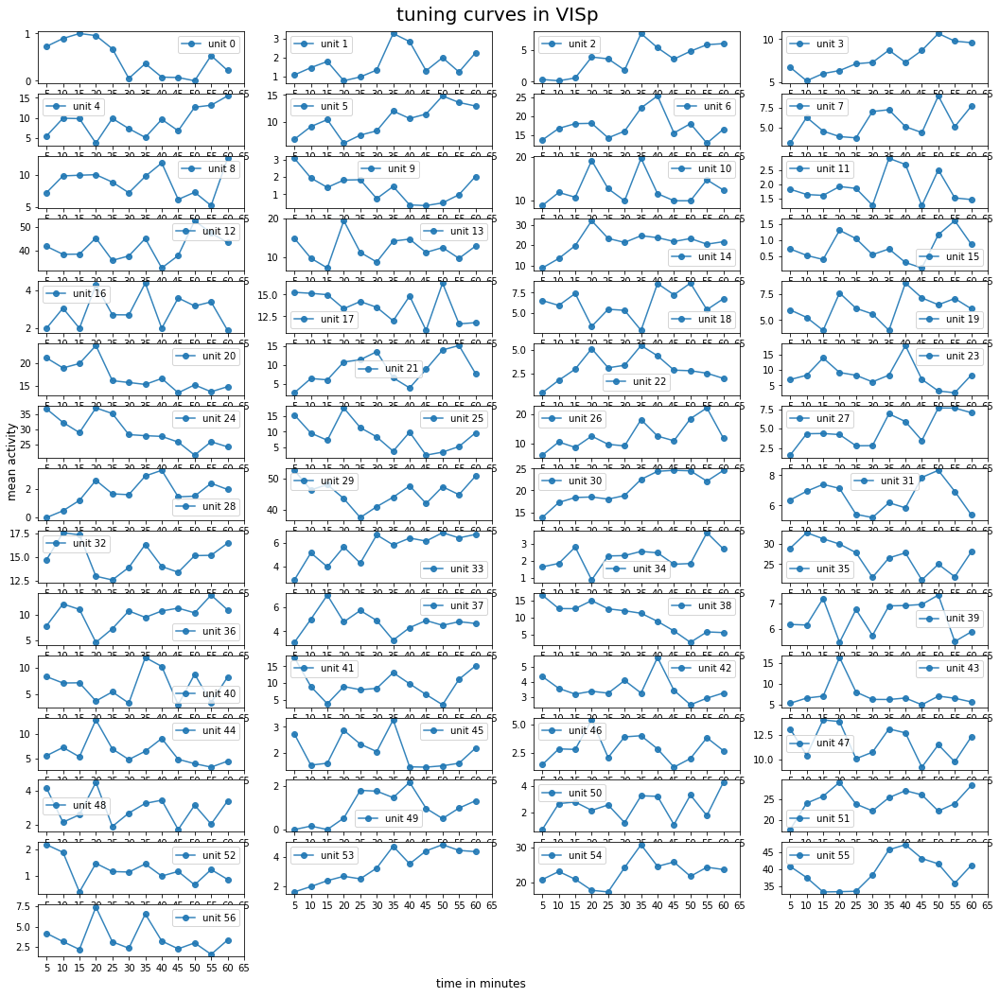

In [42]:
# mean activity over time for each unit (fixed image)
plot_tuning_curves_time_dependent(all_tunings_p[4,:,:], n_units) # this view with unequal y-axes can show normalized view


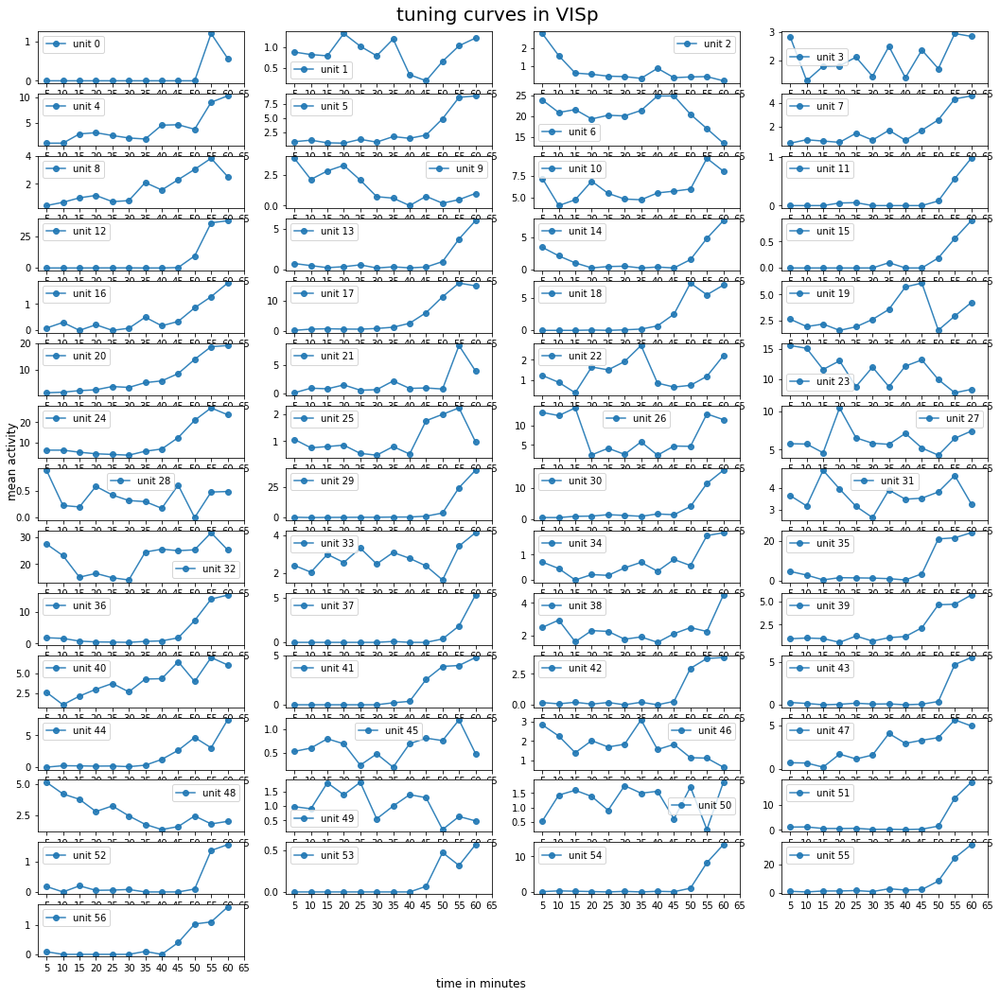

In [43]:
plot_tuning_curves_time_dependent(all_tunings_a[4,:,:], n_units) 

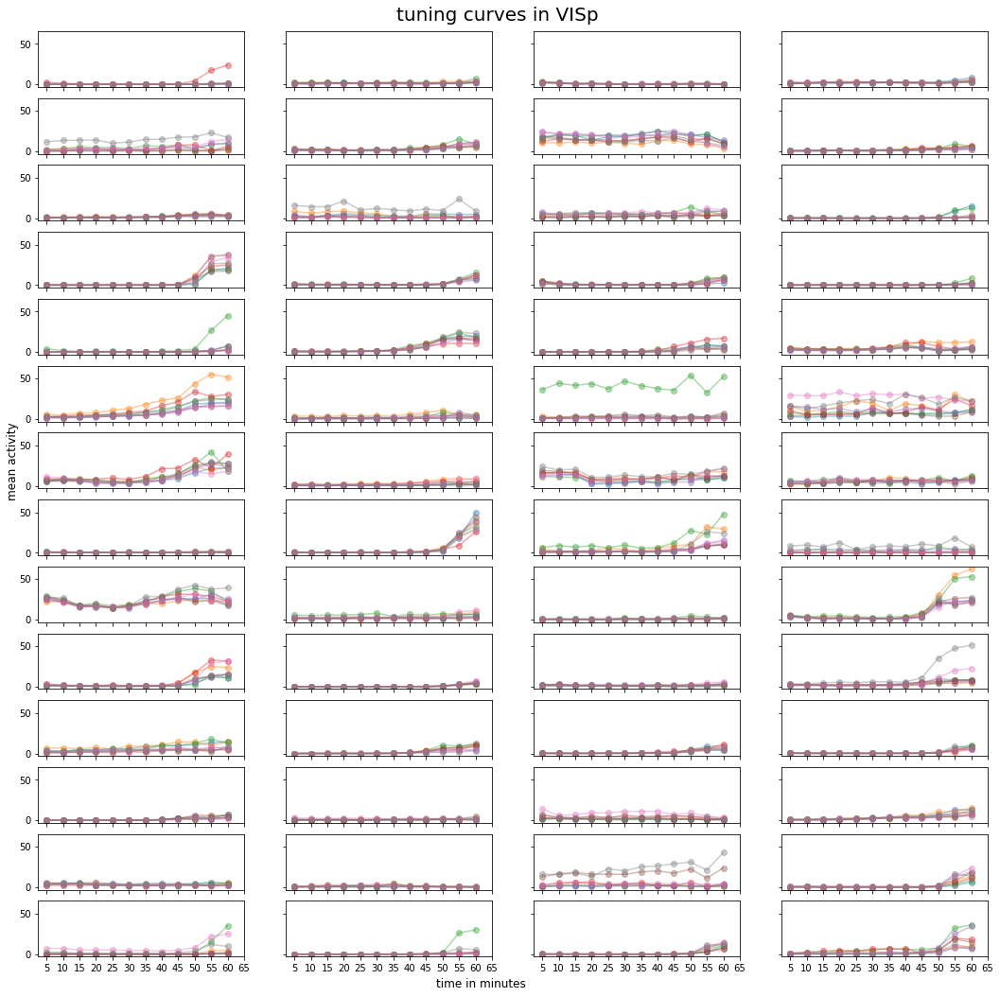

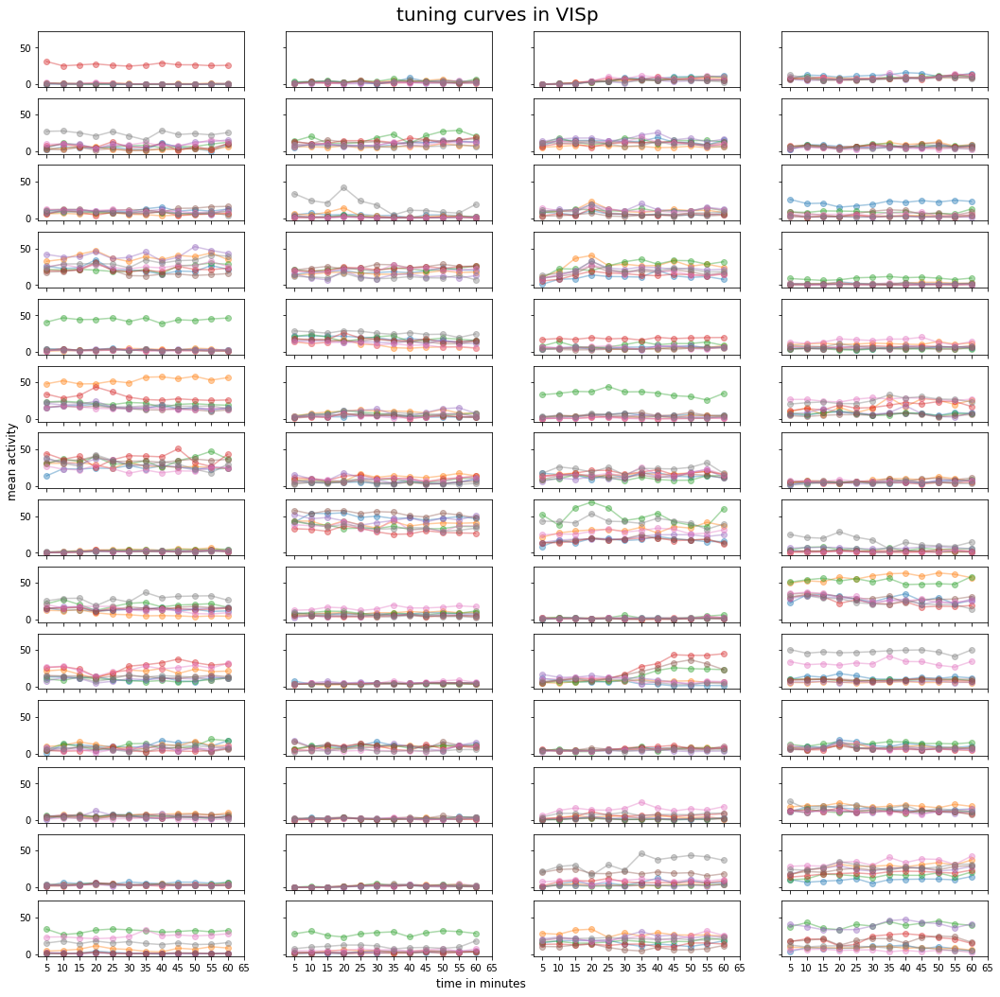

In [46]:
plot_tuning_curves_time_dependent_all_images_layered(all_tunings_a, n_units) # this view is not normalized, due to shared axes
plot_tuning_curves_time_dependent_all_images_layered(all_tunings_p, n_units)

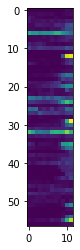

In [47]:
plt.imshow(all_tunings_a[4,:,:])
# this view is unnecessary

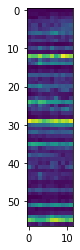

In [48]:
plt.imshow(all_tunings_p[4,:,:])

#### mean activity over bins and images for each unit or fixed unit

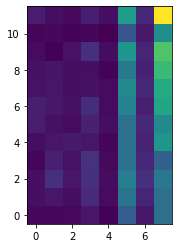

In [49]:
plt.imshow(np.transpose(all_tunings_a[:,50,:]),origin='lower')

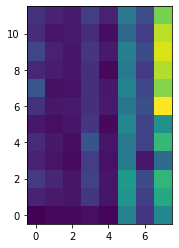

In [50]:
plt.imshow(np.transpose(all_tunings_p[:,50,:]), origin='lower')

In [52]:
all_tunings_a.shape

(8, 57, 12)

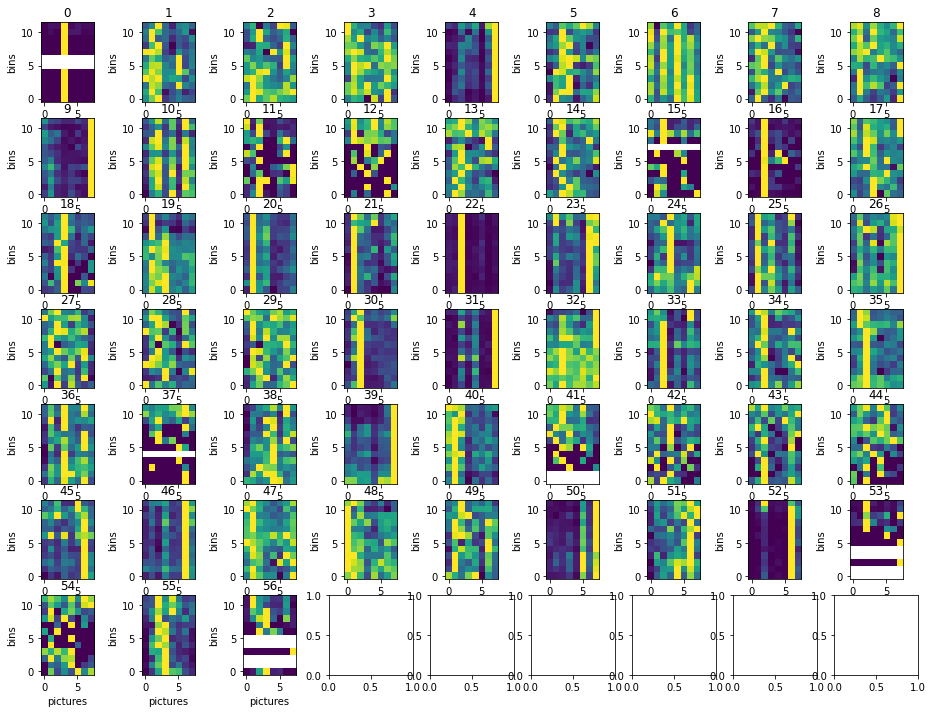

In [58]:
show_tunings_norm_each_unit(all_tunings_a, 9)

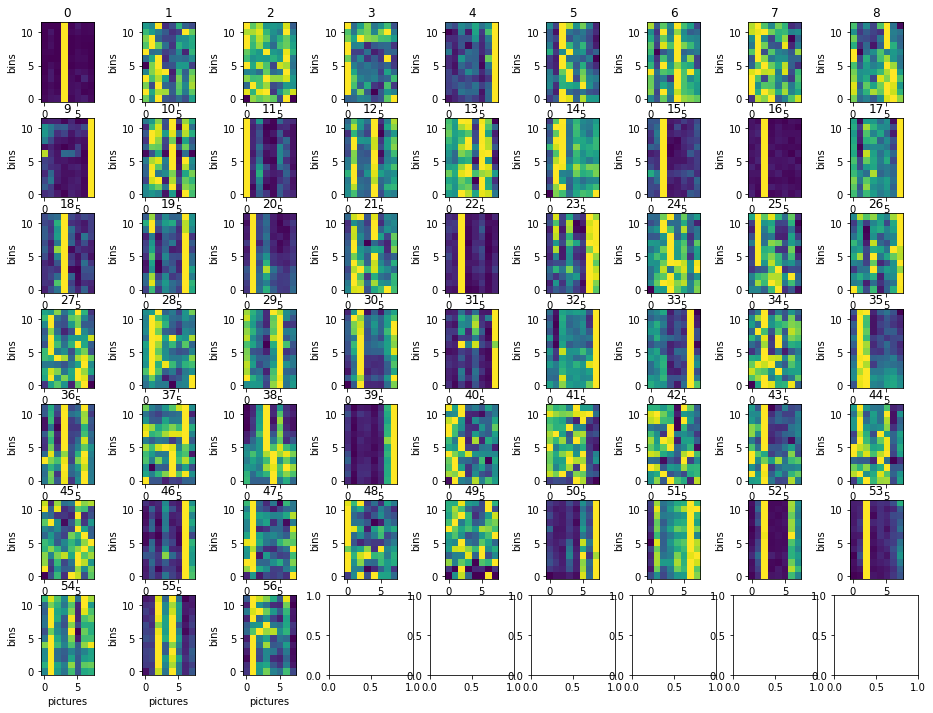

In [59]:
show_tunings_norm_each_unit(all_tunings_p, 9)

#### mean activity over units and images for each bin or fixed bin

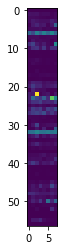

In [60]:
plt.imshow(np.transpose(all_tunings_a[:,:,3]))

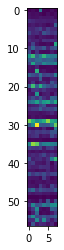

In [61]:
plt.imshow(np.transpose(all_tunings_p[:,:,3]))

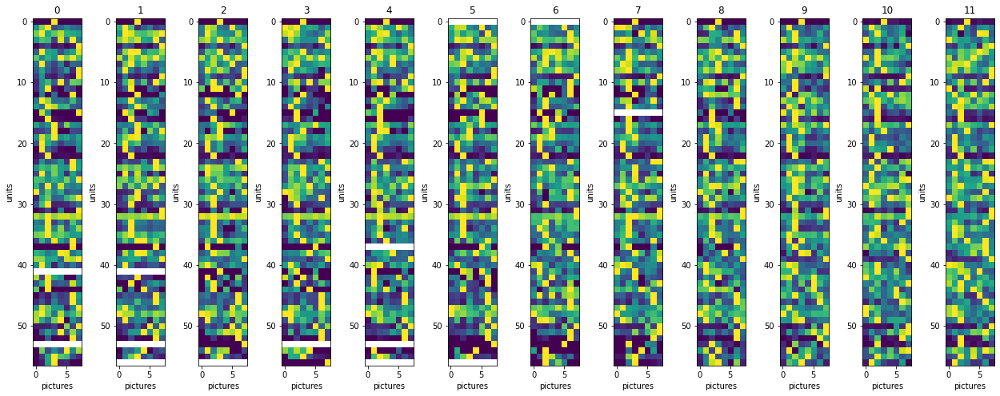

In [62]:
show_tunings_norm_each_bin(all_tunings_a)

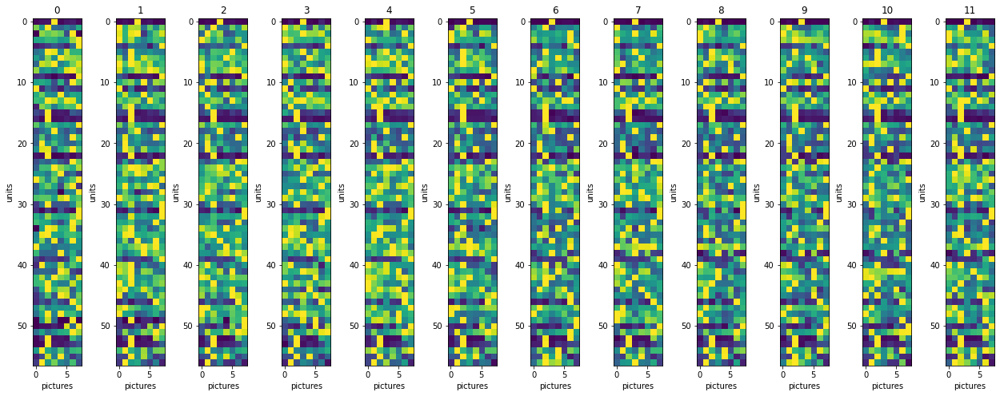

In [63]:
show_tunings_norm_each_bin(all_tunings_p)

# TODO and NEXT

Some function names are wrong/ misleading -> tidy up!!

General Similarity Plot:
- [x] plot z-vector instead of running speed and pupil area
- [x] liquid amount mouse drinks -> cummulative
- [ ] make prettier?

Tuning Curves:
- [ ] Correlation zwischen den Curves
- [x] tidy code
- [x] normieren 
- [x] passive block
- [ ] fix code

Optotagging:
- [x] tidy up
- [x] look at tagged cells (inhibitorisch) ->not in wildtype (wt)
- [x] look at all but tagged cells

Z-Scoring:
- [x] tidy up

In [ ]:
# further ideas:

# visualize licks in a histogram -> cnt of lick times per stimulus

# plot active and passive tuning together layered?